<h1 style='text-align:center;border:10px double;border-color:gray;'>
    <br/>
     PROJET 2<br/>
    <br/>
    <font color = 'brown'>"Analyse des données de systèmes éducatifs"</font><br/>
    <br/>
</h1>

## Rappel du contexte :
Data Scientist dans une **start-up de la EdTech**, nommée **academy**, qui propose des contenus de formation en ligne pour un public de niveau lycée et université.

![texte alternatif](photo.png)


**Mark**, votre manager, vous a convié à une réunion pour vous présenter le projet d’**expansion à l’international** de l’entreprise. Il vous confie une **première mission d’analyse exploratoire**, pour déterminer si les données sur l’éducation de la banque mondiale permettent d’informer le projet d’expansion.

Voici les différentes questions que Mark aimerait explorer, que vous avez notées durant la réunion :

- Quels sont les pays avec un fort potentiel de clients pour nos services ?
- Pour chacun de ces pays, quelle sera l’évolution de ce potentiel de clients ?
- Dans quels pays l'entreprise doit-elle opérer en priorité ?

## Mission :
`Mission communiquée par email from Mark…`


Hello,

Les données de la Banque mondiale sont disponibles à l’adresse suivante :

https://datacatalog.worldbank.org/dataset/education-statistics

Ou en téléchargement direct dans le dossier dataset.

Je te laisse regarder la page d'accueil qui décrit le jeu de données. En résumé, l’organisme “EdStats All Indicator Query” de la Banque mondiale répertorie 4000 indicateurs internationaux décrivant l’accès à l’éducation, l’obtention de diplômes et des informations relatives aux professeurs, aux dépenses liées à l’éducation... Tu trouveras plus d'info sur ce site :

http://datatopics.worldbank.org/education/

Pour la pré-analyse, pourrais-tu :

- Valider la qualité de ce jeu de données (comporte-t-il beaucoup de données manquantes, dupliquées ?)
- Décrire les informations contenues dans le jeu de données (nombre de colonnes ? nombre de lignes ?)
- Sélectionner les informations qui semblent pertinentes pour répondre à la problématique (quelles sont les colonnes contenant des informations qui peuvent être utiles pour répondre à la problématique de l’entreprise ?)
- Déterminer des ordres de grandeurs des indicateurs statistiques classiques pour les différentes zones géographiques et pays du monde (moyenne/médiane/écart-type par pays et par continent ou bloc géographique)

Ton travail va nous permettre de déterminer si ce jeu de données peut informer les décisions d'ouverture vers de nouveaux pays. On va partager ton analyse avec le board, alors merci de soigner la présentation et de l'illustrer avec des graphiques pertinents et lisibles !

<a id='sommaire'></a>

## Table de matière

**[`Pré-analyse`](#p1)**
* [EdStatsCountry.csv](#1)  
* [EdStatsCountry-Series.csv](#2)  
* [EdStatsData.csv](#3) 
* [EdStatsFootNote.csv](#4) 
* [EdStatsSeries.csv](#5) 


**[`Analyse des données`](#p2)**
* [Préparation de DataFrame](#7)  
* [Choix des indicateurs](#8)
* [Remplir les valeurs manquantes](#9)


**[`Visualisation`](#p3)**
* [Indicateur sur les ressources informatiques](#10)  
* [Indicateurs sur richesse des pays](#11)  
* [Indicateurs relatifs à l'éducation](#13) 
* [Visualisastion sur TABLEAU](#21) 


**[`Décisions d'ouverture vers de nouveaux pays`](#p4)**
* [ACP (Analyse en composantes principales )](#14)  
* [HAC (Hierarchical Agglomerative Clustering) choix de 3 Clusters](#15)  
* [HAC (Hierarchical Agglomerative Clustering) choix 5 Clusters](#16)
* [Recommandations des pays à clibler…](#17) 



<a id='p1'></a>

## Pré-analyse

##### Chargement des librairies

In [1]:
import os
import pandas as pd
import numpy as np
import os
#import dtale

%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
#import missingno as msno 
import plotly.express as px

#Clustering
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.decomposition import PCA
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.cluster import AgglomerativeClustering #HAC


#Normalizer
from sklearn.preprocessing import MinMaxScaler, StandardScaler

#HTML
from IPython.display import display, HTML

In [2]:
!python --version

Python 3.8.15


In [3]:
print(np.__version__)

1.23.4


In [4]:
print(pd.__version__)

1.4.2


<a id='1'></a>

### **`EdStatsCountry.csv`**
Informations très larges sur le contexte économique de chaque pays du Monde.

[Haut de page](#sommaire)

In [5]:
#Chargement 'EdStatsCountry.csv'
country = pd.read_csv('EdStatsCountry.csv')

columns_name = country.columns
#remplissage des vidé par le tiret
country.columns = [columns_name.replace(" ", "_") for columns_name in country.columns ]

#Chengement type les colmns
country['Region'] = country['Region'].astype("category")
country['Income_Group'] = country['Income_Group'].astype("category")
country['National_accounts_reference_year'] = country['National_accounts_reference_year'].astype("category")
country['SNA_price_valuation'] = country['SNA_price_valuation'].astype("category")
country['Lending_category'] = country['Lending_category'].astype("category")
country['Other_groups'] = country['Other_groups'].astype("category")
country['System_of_National_Accounts'] = country['System_of_National_Accounts'].astype("category")
country['PPP_survey_year'] = country['PPP_survey_year'].astype("category")
country['Balance_of_Payments_Manual_in_use'] = country['Balance_of_Payments_Manual_in_use'].astype("category")
country['External_debt_Reporting_status'] = country['External_debt_Reporting_status'].astype("category")
country['System_of_trade'] = country['System_of_trade'].astype("category")
country['Government_Accounting_concept'] = country['Government_Accounting_concept'].astype("category")
country['IMF_data_dissemination_standard'] = country['IMF_data_dissemination_standard'].astype("category")
country['External_debt_Reporting_status'] = country['External_debt_Reporting_status'].astype("category")
country['Vital_registration_complete'] = country['Vital_registration_complete'].astype("category")
country['External_debt_Reporting_status'] = country['External_debt_Reporting_status'].astype("category")
country['External_debt_Reporting_status'] = country['External_debt_Reporting_status'].astype("category")


print("le jeu de données comporte {} lignes et {} colonnes.".format(country.shape[0], country.shape[1])) 
country.head(1).T

le jeu de données comporte 241 lignes et 32 colonnes.


,0
Country_Code,ABW
Short_Name,Aruba
Table_Name,Aruba
Long_Name,Aruba
2-alpha_code,AW
Currency_Unit,Aruban florin
Special_Notes,SNA data for 2000-2011 are updated from offici...
Region,Latin America & Caribbean
Income_Group,High income: nonOECD
WB-2_code,AW


In [6]:
country.describe(include = ['O']).T

,count,unique,top,freq
Country_Code,241,241,ABW,1
Short_Name,241,241,Aruba,1
Table_Name,241,241,Aruba,1
Long_Name,241,241,Aruba,1
2-alpha_code,238,238,AW,1
Currency_Unit,215,152,Euro,23
Special_Notes,145,131,April 2012 database update: Based on official ...,6
WB-2_code,240,240,AW,1
National_accounts_base_year,205,43,2005,34
Alternative_conversion_factor,47,32,1990–95,8


In [7]:
display(country.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 241 entries, 0 to 240
Data columns (total 32 columns):
 #   Column                                             Non-Null Count  Dtype   
---  ------                                             --------------  -----   
 0   Country_Code                                       241 non-null    object  
 1   Short_Name                                         241 non-null    object  
 2   Table_Name                                         241 non-null    object  
 3   Long_Name                                          241 non-null    object  
 4   2-alpha_code                                       238 non-null    object  
 5   Currency_Unit                                      215 non-null    object  
 6   Special_Notes                                      145 non-null    object  
 7   Region                                             214 non-null    category
 8   Income_Group                                       214 non-null    category
 9  

None

In [8]:
#sns.heatmap(country.isnull())

<AxesSubplot:>

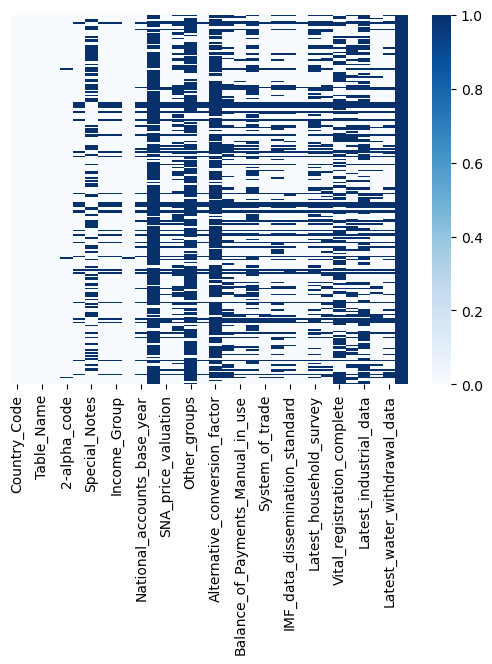

In [9]:
sns.heatmap(country.isnull(), yticklabels = False, cbar = True, cmap='Blues')

In [10]:
#country.describe()

In [11]:
def  missing_val_DF(df):
    '''Avoir un DataFrame des données, avec les valeurs manquantes et leurs pourcentages
    '''
    val_man_count = (df.isna().sum().sort_values(ascending=True))
    val_man_count_pourcent = ((df.isna().sum() / len(df)) * 100).sort_values(ascending=True)
    return pd.DataFrame({'Nombre':val_man_count, 'Pourcentage': val_man_count_pourcent}).style.background_gradient(cmap='Reds')

In [12]:
#missing_val_DF(shift + tab)

In [13]:
 missing_val_DF(country)

,Nombre,Pourcentage
Country_Code,0,0.000000
Short_Name,0,0.000000
Table_Name,0,0.000000
Long_Name,0,0.000000
WB-2_code,1,0.414938
2-alpha_code,3,1.244813
System_of_National_Accounts,26,10.788382
Currency_Unit,26,10.788382
Region,27,11.203320
Income_Group,27,11.203320


In [14]:
#Dupliqué
country.duplicated(subset=['Country_Code', 'Short_Name']).sum()

0

In [15]:
print(country['Country_Code'].nunique())
display(country['Country_Code'].unique())

241


array(['ABW', 'AFG', 'AGO', 'ALB', 'AND', 'ARB', 'ARE', 'ARG', 'ARM',
       'ASM', 'ATG', 'AUS', 'AUT', 'AZE', 'BDI', 'BEL', 'BEN', 'BFA',
       'BGD', 'BGR', 'BHR', 'BHS', 'BIH', 'BLR', 'BLZ', 'BMU', 'BOL',
       'BRA', 'BRB', 'BRN', 'BTN', 'BWA', 'CAF', 'CAN', 'CHE', 'CHI',
       'CHL', 'CHN', 'CIV', 'CMR', 'COD', 'COG', 'COL', 'COM', 'CPV',
       'CRI', 'CUB', 'CUW', 'CYM', 'CYP', 'CZE', 'DEU', 'DJI', 'DMA',
       'DNK', 'DOM', 'DZA', 'EAP', 'EAS', 'ECA', 'ECS', 'ECU', 'EGY',
       'EMU', 'ERI', 'ESP', 'EST', 'ETH', 'EUU', 'FIN', 'FJI', 'FRA',
       'FRO', 'FSM', 'GAB', 'GBR', 'GEO', 'GHA', 'GIB', 'GIN', 'GMB',
       'GNB', 'GNQ', 'GRC', 'GRD', 'GRL', 'GTM', 'GUM', 'GUY', 'HIC',
       'HKG', 'HND', 'HPC', 'HRV', 'HTI', 'HUN', 'IDN', 'IMN', 'IND',
       'IRL', 'IRN', 'IRQ', 'ISL', 'ISR', 'ITA', 'JAM', 'JOR', 'JPN',
       'KAZ', 'KEN', 'KGZ', 'KHM', 'KIR', 'KNA', 'KOR', 'KWT', 'LAC',
       'LAO', 'LBN', 'LBR', 'LBY', 'LCA', 'LCN', 'LDC', 'LIC', 'LIE',
       'LKA', 'LMC',

In [16]:
print(country['Short_Name'].nunique())
display(country['Short_Name'].unique())

241


array(['Aruba', 'Afghanistan', 'Angola', 'Albania', 'Andorra',
       'Arab World', 'United Arab Emirates', 'Argentina', 'Armenia',
       'American Samoa', 'Antigua and Barbuda', 'Australia', 'Austria',
       'Azerbaijan', 'Burundi', 'Belgium', 'Benin', 'Burkina Faso',
       'Bangladesh', 'Bulgaria', 'Bahrain', 'The Bahamas',
       'Bosnia and Herzegovina', 'Belarus', 'Belize', 'Bermuda',
       'Bolivia', 'Brazil', 'Barbados', 'Brunei', 'Bhutan', 'Botswana',
       'Central African Republic', 'Canada', 'Switzerland',
       'Channel Islands', 'Chile', 'China', "Côte d'Ivoire", 'Cameroon',
       'Dem. Rep. Congo', 'Congo', 'Colombia', 'Comoros', 'Cabo Verde',
       'Costa Rica', 'Cuba', 'Curaçao', 'Cayman Islands', 'Cyprus',
       'Czech Republic', 'Germany', 'Djibouti', 'Dominica', 'Denmark',
       'Dominican Republic', 'Algeria',
       'East Asia & Pacific (developing only)',
       'East Asia & Pacific (all income levels)',
       'Europe & Central Asia (developing only)',


In [17]:
print(country['WB-2_code'].nunique())
display(country['WB-2_code'].unique())

240


array(['AW', 'AF', 'AO', 'AL', 'AD', '1A', 'AE', 'AR', 'AM', 'AS', 'AG',
       'AU', 'AT', 'AZ', 'BI', 'BE', 'BJ', 'BF', 'BD', 'BG', 'BH', 'BS',
       'BA', 'BY', 'BZ', 'BM', 'BO', 'BR', 'BB', 'BN', 'BT', 'BW', 'CF',
       'CA', 'CH', 'JG', 'CL', 'CN', 'CI', 'CM', 'ZR', 'CG', 'CO', 'KM',
       'CV', 'CR', 'CU', 'CW', 'KY', 'CY', 'CZ', 'DE', 'DJ', 'DM', 'DK',
       'DO', 'DZ', '4E', 'Z4', '7E', 'Z7', 'EC', 'EG', 'XC', 'ER', 'ES',
       'EE', 'ET', 'EU', 'FI', 'FJ', 'FR', 'FO', 'FM', 'GA', 'GB', 'GE',
       'GH', 'GI', 'GN', 'GM', 'GW', 'GQ', 'GR', 'GD', 'GL', 'GT', 'GU',
       'GY', 'XD', 'HK', 'HN', 'XE', 'HR', 'HT', 'HU', 'ID', 'IM', 'IN',
       'IE', 'IR', 'IQ', 'IS', 'IL', 'IT', 'JM', 'JO', 'JP', 'KZ', 'KE',
       'KG', 'KH', 'KI', 'KN', 'KR', 'KW', 'XJ', 'LA', 'LB', 'LR', 'LY',
       'LC', 'ZJ', 'XL', 'XM', 'LI', 'LK', 'XN', 'XO', 'LS', 'LT', 'LU',
       'LV', 'MO', 'MF', 'MA', 'MC', 'MD', 'MG', 'MV', 'ZQ', 'MX', 'MH',
       'XP', 'MK', 'ML', 'MT', 'MM', 'XQ', 'ME', 'M

In [18]:
print(country['2-alpha_code'].nunique())
#display(country['2-alpha_code'].unique())

238


In [19]:
# list1 = country['2-alpha_code'].unique()
# mask = country['2-alpha_code'].isin(list1)

In [20]:
# country[~mask]

In [21]:
print(country['Currency_Unit'].nunique())
display(country['Currency_Unit'].unique())

152


array(['Aruban florin', 'Afghan afghani', 'Angolan kwanza',
       'Albanian lek', 'Euro', nan, 'U.A.E. dirham', 'Argentine peso',
       'Armenian dram', 'U.S. dollar', 'East Caribbean dollar',
       'Australian dollar', 'New Azeri manat', 'Burundi franc',
       'CFA franc', 'Bangladeshi taka', 'Bulgarian lev', 'Bahraini dinar',
       'Bahamian dollar', 'Bosnia and Herzegovina convertible mark',
       'Belarusian rubel', 'Belize dollar', 'Bermuda dollar',
       'Bolivian Boliviano', 'Brazilian real', 'Barbados dollar',
       'Brunei dollar', 'Bhutanese ngultrum', 'Botswana pula',
       'Canadian dollar', 'Swiss franc', 'Pound sterling', 'Chilean peso',
       'Chinese yuan', 'Congolese franc', 'Colombian peso',
       'Comorian franc', 'Cabo Verde escudo', 'Costa Rican colon',
       'Cuban peso', 'Netherlands Antilles guilder',
       'Cayman Islands dollar', 'Czech koruna', 'Djibouti franc',
       'Danish krone', 'Dominican peso', 'Algerian dinar',
       'Egyptian pound', '

In [22]:
print(country['Special_Notes'].nunique())
#display(country['Special_Notes'].unique())

131


In [23]:
print(country['Region'].nunique())
display(country['Region'].unique())

7


['Latin America & Caribbean', 'South Asia', 'Sub-Saharan Africa', 'Europe & Central Asia', NaN, 'Middle East & North Africa', 'East Asia & Pacific', 'North America']
Categories (7, object): ['East Asia & Pacific', 'Europe & Central Asia', 'Latin America & Caribbean', 'Middle East & North Africa', 'North America', 'South Asia', 'Sub-Saharan Africa']

In [24]:
print(country['Income_Group'].nunique())
display(country['Income_Group'].unique())

5


['High income: nonOECD', 'Low income', 'Upper middle income', NaN, 'Lower middle income', 'High income: OECD']
Categories (5, object): ['High income: OECD', 'High income: nonOECD', 'Low income', 'Lower middle income', 'Upper middle income']

In [25]:
print(country['WB-2_code'].nunique())
#display(country['WB-2_code'].unique())

240


In [26]:
print(country['National_accounts_base_year'].nunique())
display(country['National_accounts_base_year'].unique())

43


array(['2000', '2002/03', '2002',
       'Original chained constant price data are rescaled.', '1990', nan,
       '2007', '2004', '2006', '2005', '1985', '1999', '1995/96', '1974',
       '2003', '2008', '1996', '1991', '1980', '1991/92', '2011', '2001',
       '1986/87', '2004/05', '1997/98', '1988', '1994', '2010', '1995',
       '1997', '2012', '1998', '1984', '1987', '2005/06', '2009',
       '2000/01', '2005/2006', '1954', '1990/91',
       '1981/82. Reporting period switch from fiscal year to calendar year from 1996. Pre-1996 data converted to calendar year.',
       '2010/11', '2001/02', '1982'], dtype=object)

In [27]:
print(country['National_accounts_reference_year'].nunique())
display(country['National_accounts_reference_year'].unique())

11


C:\Users\pouri\anaconda3\lib\site-packages\IPython\lib\pretty.py:778: FutureWarning: Index.ravel returning ndarray is deprecated; in a future version this will return a view on self.
  output = repr(obj)


[NaN, 1996.0, 2012.0, 2002.0, 2000.0, ..., 1995.0, 1987.0, 2001.0, 2003.0, 1997.0]
Length: 12
Categories (11, float64): [1987.0, 1995.0, 1996.0, 1997.0, ..., 2003.0, 2005.0, 2007.0, 2012.0]

In [28]:
print(country['SNA_price_valuation'].nunique())
display(country['SNA_price_valuation'].unique())

2


['Value added at basic prices (VAB)', 'Value added at producer prices (VAP)', NaN]
Categories (2, object): ['Value added at basic prices (VAB)', 'Value added at producer prices (VAP)']

In [29]:
print(country['Lending_category'].nunique())
display(country['Lending_category'].unique())

3


[NaN, 'IDA', 'IBRD', 'Blend']
Categories (3, object): ['Blend', 'IBRD', 'IDA']

In [30]:
print(country['Other_groups'].nunique())
display(country['Other_groups'].unique())

2


[NaN, 'HIPC', 'Euro area']
Categories (2, object): ['Euro area', 'HIPC']

In [31]:
print(country['System_of_National_Accounts'].nunique())
display(country['System_of_National_Accounts'].unique())

3


['Country uses the 1993 System of National Acco..., 'Country uses the 1968 System of National Acco..., NaN, 'Country uses the 2008 System of National Acco...]
Categories (3, object): ['Country uses the 1968 System of National Acco..., 'Country uses the 1993 System of National Acco..., 'Country uses the 2008 System of National Acco...]

In [32]:
print(country['Alternative_conversion_factor'].nunique())
display(country['Alternative_conversion_factor'].unique())

32


array([nan, '1991–96', '1971–84', '1990–95', '1992–95', '1992', '1992–93',
       '1978–89, 1991–92', '1960–85', '1978–93', '1999–2001', '1993',
       '1992–94', '1987–95', '1973–87', '1965–84', '1988–89', '1991',
       '1980–2002', '1997, 2004', '1986', '1971–98', '1965–95', '1985–90',
       '1989', '1987–89, 1992', '1994', '1977–90', '1970–2010',
       '1987–95, 1997–2007', '1990–96', '1990–92', '1991, 1998'],
      dtype=object)

In [33]:
print(country['PPP_survey_year'].nunique())
display(country['PPP_survey_year'].unique())

3


[NaN, '2005', 'Rolling', '2011']
Categories (3, object): ['2005', '2011', 'Rolling']

In [34]:
print(country['Balance_of_Payments_Manual_in_use'].nunique())
display(country['Balance_of_Payments_Manual_in_use'].unique())

1


['IMF Balance of Payments Manual, 6th edition.', NaN]
Categories (1, object): ['IMF Balance of Payments Manual, 6th edition.']

In [35]:
print(country['External_debt_Reporting_status'].nunique())
display(country['External_debt_Reporting_status'].unique())

3


[NaN, 'Actual', 'Preliminary', 'Estimate']
Categories (3, object): ['Actual', 'Estimate', 'Preliminary']

In [36]:
print(country['System_of_trade'].nunique())
display(country['System_of_trade'].unique())

2


['Special trade system', 'General trade system', NaN]
Categories (2, object): ['General trade system', 'Special trade system']

In [37]:
print(country['Government_Accounting_concept'].nunique())
display(country['Government_Accounting_concept'].unique())

2


[NaN, 'Consolidated central government', 'Budgetary central government']
Categories (2, object): ['Budgetary central government', 'Consolidated central government']

In [38]:
print(country['IMF_data_dissemination_standard'].nunique())
display(country['IMF_data_dissemination_standard'].unique())

2


[NaN, 'General Data Dissemination System (GDDS)', 'Special Data Dissemination Standard (SDDS)']
Categories (2, object): ['General Data Dissemination System (GDDS)', 'Special Data Dissemination Standard (SDDS)']

In [39]:
print(country['Latest_population_census'].nunique())
display(country['Latest_population_census'].unique())

27


array(['2010', '1979', '1970', '2011',
       '2011. Population figures compiled from administrative registers.',
       nan, '2009', '2008', '2013', '2006', '2012', '2005', '2003',
       'Guernsey: 2009; Jersey: 2011.', '1998', '1984', '2007',
       '2006. Rolling census based on continuous sample survey.', '2002',
       '1996',
       '2011. The population censuses for 1986 and 1996 were based on a one-in-seven sample of the population, while that for 2006 was based on a one-in-ten sample of the population.',
       '1997', '2004', '1993', '1983', '1987', '2001', '1989'],
      dtype=object)

In [40]:
print(country['Latest_household_survey'].nunique())
#display(country['Latest_household_survey'].unique())

60


In [41]:
print(country['Source_of_most_recent_Income_and_expenditure_data'].nunique())
#display(country['Source_of_most_recent_Income_and_expenditure_data'].unique())

75


In [42]:
print(country['Vital_registration_complete'].nunique())
display(country['Vital_registration_complete'].unique())

2


['Yes', NaN, 'Yes. Vital registration for Guernsey and Jers...]
Categories (2, object): ['Yes', 'Yes. Vital registration for Guernsey and Jers...]

In [43]:
print(country['Latest_agricultural_census'].nunique())
display(country['Latest_agricultural_census'].unique())

35


array([nan, '2013/14', '2015', '2012', '2013', '2007', '2011', '2010',
       '2011/12', '2008', '2006', '2010. Population and Housing Census.',
       '2009', '2011. Population and Housing Census.', '2014', '2012/13',
       '2013/15', '2009/2010', '2013/ 2014', '2008/ 2009', '2011/2012',
       '2009. Population and Housing Census.', '2010/11',
       '2008. Population and Housing Census.', '2013/2014', '2009/ 2010',
       '2006/ 2007', '2004-2008', '2011/ 2012', '2012/ 2013', '2007/2008',
       '2007. Population and Housing Census.', '2010/ 2011', '2014/ 2015',
       '2007/08', '2012 /2013'], dtype=object)

In [44]:
print(country['Latest_industrial_data'].nunique())
display(country['Latest_industrial_data'].unique())

11


array([  nan, 2010., 2002., 2009., 2001., 2007., 2008., 2003., 2004.,
       2005., 2000., 2006.])

In [45]:
print(country['Latest_trade_data'].nunique())
display(country['Latest_trade_data'].unique())

13


array([2012.,   nan, 2006., 2011., 2010., 2007., 2009., 2003., 2008.,
       2005., 1997., 2002., 1995., 2000.])

In [46]:
print(country['Latest_water_withdrawal_data'].nunique())
display(country['Latest_water_withdrawal_data'].unique())

20


array([nan, '2000', '2005', '2006', '2007', '2002', '2001', '2008',
       '2009', '2003', '1994', '1986', '1999', '1997', '2004', '2010',
       '1979', '1993', '2005. Includes South Sudan.', '1975', '1995'],
      dtype=object)

<a id='2'></a>

### **`EdStatsCountry-Series.csv`**
Informations descriptives sur les sources des données du dataframe 'Country-Series'.

[Haut de page](#sommaire)

In [47]:
countrySeries = pd.read_csv('EdStatsCountry-Series.csv')
print("le jeu de données comporte {} lignes et {} colonnes.".format(countrySeries.shape[0], countrySeries.shape[1])) 
display(countrySeries.isna().sum())
countrySeries.head(1)

le jeu de données comporte 613 lignes et 4 colonnes.


CountryCode      0
SeriesCode       0
DESCRIPTION      0
Unnamed: 3     613
dtype: int64

,CountryCode,SeriesCode,DESCRIPTION,Unnamed: 3
0,ABW,SP.POP.TOTL,Data sources : United Nations World Population...,NaN


In [48]:
countrySeries.describe(include=['O'])

,CountryCode,SeriesCode,DESCRIPTION
count,613,613,613
unique,211,21,97
top,MDA,SP.POP.TOTL,Data sources : United Nations World Population...
freq,18,211,154


In [49]:
countrySeries.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 613 entries, 0 to 612
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   CountryCode  613 non-null    object 
 1   SeriesCode   613 non-null    object 
 2   DESCRIPTION  613 non-null    object 
 3   Unnamed: 3   0 non-null      float64
dtypes: float64(1), object(3)
memory usage: 19.3+ KB


In [50]:
countrySeries.duplicated(subset=['CountryCode', 'SeriesCode']).sum()

0

<AxesSubplot:>

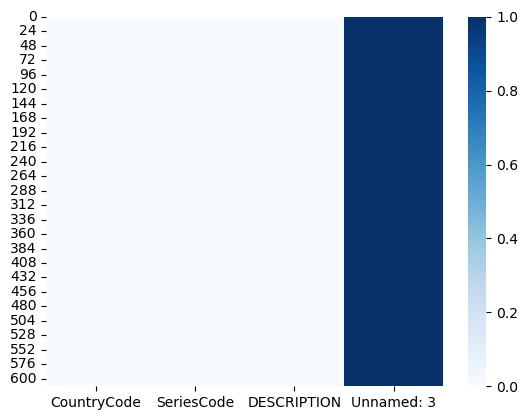

In [51]:
sns.heatmap(countrySeries.isnull(), cmap='Blues')

In [52]:
display(countrySeries['CountryCode'].nunique())
display(countrySeries['CountryCode'].unique())

211

array(['ABW', 'AFG', 'AGO', 'ALB', 'AND', 'ARE', 'ARG', 'ARM', 'ASM',
       'ATG', 'AUS', 'AUT', 'AZE', 'BDI', 'BEL', 'BEN', 'BFA', 'BGD',
       'BGR', 'BHR', 'BHS', 'BIH', 'BLR', 'BLZ', 'BMU', 'BOL', 'BRA',
       'BRB', 'BRN', 'BTN', 'BWA', 'CAF', 'CAN', 'CHE', 'CHI', 'CHL',
       'CHN', 'CIV', 'CMR', 'COD', 'COG', 'COL', 'COM', 'CPV', 'CRI',
       'CUB', 'CYM', 'CYP', 'CZE', 'DEU', 'DJI', 'DMA', 'DNK', 'DOM',
       'DZA', 'ECU', 'EGY', 'ERI', 'ESP', 'EST', 'ETH', 'FIN', 'FJI',
       'FRA', 'FRO', 'FSM', 'GAB', 'GBR', 'GEO', 'GHA', 'GIB', 'GIN',
       'GMB', 'GNB', 'GNQ', 'GRC', 'GRD', 'GRL', 'GTM', 'GUM', 'GUY',
       'HKG', 'HND', 'HRV', 'HTI', 'HUN', 'IDN', 'IMN', 'IND', 'IRL',
       'IRN', 'IRQ', 'ISL', 'ISR', 'ITA', 'JAM', 'JOR', 'JPN', 'KAZ',
       'KEN', 'KGZ', 'KHM', 'KIR', 'KNA', 'KOR', 'KWT', 'LAO', 'LBN',
       'LBR', 'LBY', 'LCA', 'LIE', 'LKA', 'LSO', 'LTU', 'LUX', 'LVA',
       'MAC', 'MAR', 'MCO', 'MDA', 'MDG', 'MDV', 'MEX', 'MHL', 'MKD',
       'MLI', 'MLT',

In [53]:
display(countrySeries['SeriesCode'].nunique())
display(countrySeries['SeriesCode'].unique())

21

array(['SP.POP.TOTL', 'SP.POP.GROW', 'NY.GDP.PCAP.PP.CD',
       'NY.GDP.MKTP.PP.KD', 'NY.GNP.MKTP.PP.CD', 'NY.GDP.MKTP.PP.CD',
       'NY.GDP.PCAP.PP.KD', 'NY.GNP.PCAP.PP.CD', 'SP.POP.1564.TO.ZS',
       'SP.POP.TOTL.MA.ZS', 'SP.POP.TOTL.FE.ZS', 'SP.POP.0014.TO.ZS',
       'NY.GNP.PCAP.CD', 'NY.GDP.PCAP.CD', 'NY.GDP.PCAP.KD',
       'SP.POP.1564.MA.IN', 'SP.POP.0014.TO', 'SP.POP.1564.TO',
       'SP.POP.1564.FE.IN', 'SP.POP.0014.MA.IN', 'SP.POP.0014.FE.IN'],
      dtype=object)

<AxesSubplot:ylabel='SeriesCode'>

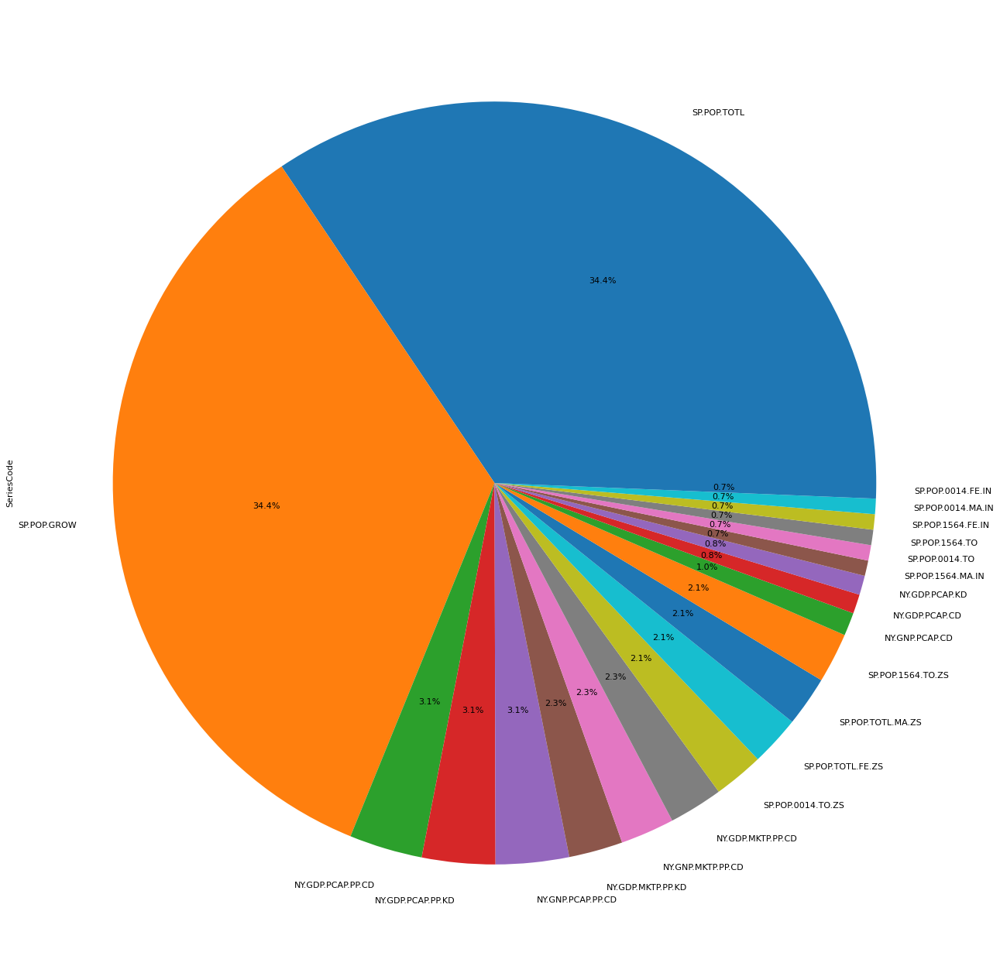

In [54]:
from matplotlib.pyplot import figure

figure(figsize=(20, 20), dpi=80)
countrySeries["SeriesCode"].value_counts(normalize=True).plot(kind='pie', autopct='%1.1f%%')

In [55]:
display(countrySeries['DESCRIPTION'].nunique())
#display(countrySeries['DESCRIPTION'].unique())

97

In [56]:
country[~country['Country_Code'].isin(countrySeries['CountryCode'].unique())]#[['Short_Name']]

,Country_Code,Short_Name,Table_Name,Long_Name,2-alpha_code,Currency_Unit,Special_Notes,Region,Income_Group,WB-2_code,...,IMF_data_dissemination_standard,Latest_population_census,Latest_household_survey,Source_of_most_recent_Income_and_expenditure_data,Vital_registration_complete,Latest_agricultural_census,Latest_industrial_data,Latest_trade_data,Latest_water_withdrawal_data,Unnamed:_31
5,ARB,Arab World,Arab World,Arab World,1A,NaN,Arab World aggregate. Arab World is composed o...,NaN,NaN,1A,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
47,CUW,Curaçao,Curaçao,Curaçao,CW,Netherlands Antilles guilder,NaN,Latin America & Caribbean,High income: nonOECD,CW,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
57,EAP,East Asia & Pacific (developing only),East Asia & Pacific,East Asia & Pacific (developing only),4E,NaN,East Asia and Pacific regional aggregate (does...,NaN,NaN,4E,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
58,EAS,East Asia & Pacific (all income levels),East Asia & Pacific (all income levels),East Asia & Pacific (all income levels),Z4,NaN,East Asia and Pacific regional aggregate (incl...,NaN,NaN,Z4,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
59,ECA,Europe & Central Asia (developing only),Europe & Central Asia,Europe & Central Asia (developing only),7E,NaN,Europe and Central Asia regional aggregate (do...,NaN,NaN,7E,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
60,ECS,Europe & Central Asia (all income levels),Europe & Central Asia (all income levels),Europe & Central Asia (all income levels),Z7,NaN,Europe and Central Asia regional aggregate (in...,NaN,NaN,Z7,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
63,EMU,Euro area,Euro area,Euro area,XC,NaN,Euro area aggregate.,NaN,NaN,XC,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
68,EUU,European Union,European Union,European Union,EU,NaN,European Union aggregate.,NaN,NaN,EU,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
89,HIC,High income,High income,High income,XD,NaN,High income group aggregate. High-income econo...,NaN,NaN,XD,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
92,HPC,Heavily indebted poor countries (HIPC),Heavily indebted poor countries (HIPC),Heavily indebted poor countries (HIPC),XE,NaN,Heavily indebted poor countries aggregate.,NaN,NaN,XE,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


<a id='3'></a>

### **`EdStatsData.csv`**
Informations sur l'évolution de nombreux indicateurs pour chaque pays du Monde, avec des spécificités par zone géographique.

[Haut de page](#sommaire)

In [57]:
#Chargement de 'EdStatsData.csv'
data = pd.read_csv('EdStatsData.csv')
print("le jeu de données comporte {} lignes et {} colonnes.".format(data.shape[0], data.shape[1])) 
data_top = data.copy()
data.head(3)

le jeu de données comporte 886930 lignes et 70 colonnes.


,Country Name,Country Code,Indicator Name,Indicator Code,1970,1971,1972,1973,1974,1975,...,2060,2065,2070,2075,2080,2085,2090,2095,2100,Unnamed: 69
0,Arab World,ARB,"Adjusted net enrolment rate, lower secondary, ...",UIS.NERA.2,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Arab World,ARB,"Adjusted net enrolment rate, lower secondary, ...",UIS.NERA.2.F,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Arab World,ARB,"Adjusted net enrolment rate, lower secondary, ...",UIS.NERA.2.GPI,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [58]:
data.describe(include=['O'])

,Country Name,Country Code,Indicator Name,Indicator Code
count,886930,886930,886930,886930
unique,242,242,3665,3665
top,Arab World,ARB,"Adjusted net enrolment rate, lower secondary, ...",UIS.NERA.2
freq,3665,3665,242,242


In [59]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 886930 entries, 0 to 886929
Data columns (total 70 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   Country Name    886930 non-null  object 
 1   Country Code    886930 non-null  object 
 2   Indicator Name  886930 non-null  object 
 3   Indicator Code  886930 non-null  object 
 4   1970            72288 non-null   float64
 5   1971            35537 non-null   float64
 6   1972            35619 non-null   float64
 7   1973            35545 non-null   float64
 8   1974            35730 non-null   float64
 9   1975            87306 non-null   float64
 10  1976            37483 non-null   float64
 11  1977            37574 non-null   float64
 12  1978            37576 non-null   float64
 13  1979            36809 non-null   float64
 14  1980            89122 non-null   float64
 15  1981            38777 non-null   float64
 16  1982            37511 non-null   float64
 17  1983      

In [60]:
#Val manquant
data_miss_full = missing_val_DF(data)
data_miss_full

,Nombre,Pourcentage
Country Name,0,0.000000
Country Code,0,0.000000
Indicator Name,0,0.000000
Indicator Code,0,0.000000
2010,644488,72.665036
2005,702822,79.242105
2000,710254,80.080051
2012,739666,83.396209
2011,740918,83.537370
2009,744822,83.977541


In [61]:
# mask_data = data_miss_full['Pourcentage'] <= 86
# data_miss_full[mask_data].reset_index().sort_values(by='index')

<AxesSubplot:>

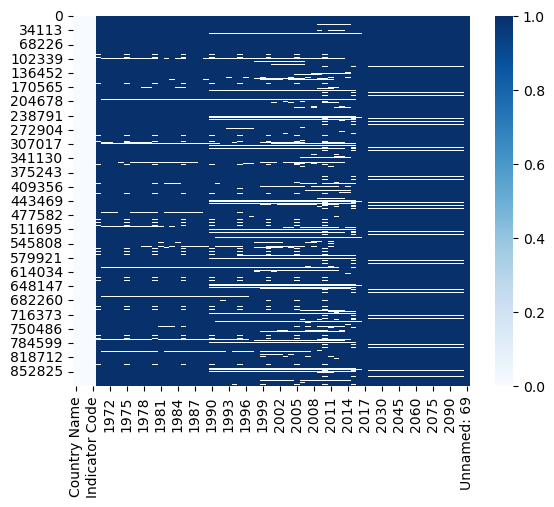

In [62]:
sns.heatmap(data.isnull(), cmap='Blues')

In [63]:
#msno.matrix(data)

In [64]:
display(data.isna().sum().sort_values(ascending=False))

Unnamed: 69       886930
2017              886787
2016              870470
1971              851393
1973              851385
                   ...  
2010              644488
Country Code           0
Indicator Code         0
Indicator Name         0
Country Name           0
Length: 70, dtype: int64

In [65]:
print(data['Country Name'].nunique())
#display(data['Country Name'].unique())

242


In [66]:
print(data['Country Code'].nunique())
#display(data['Country Code'].unique())

242


In [67]:
print(data['Indicator Name'].nunique())
#display(data['Indicator Name'].unique().tolist())

3665


In [68]:
print(data['Indicator Code'].nunique())
#display(data['Indicator Code'].unique().tolist())

3665


In [69]:
data['Indicator Code'].value_counts().sort_values()

UIS.NERA.2                  242
UIS.AFR.PBR.1.G3.PU.MATH    242
UIS.NIRA.1.F                242
UIS.NERA.2.GPI              242
UIS.NERA.2.M                242
                           ... 
UIS.LP.AG15T24              242
UIS.LP.AG15T24.F            242
UIS.LP.AG15T24.M            242
SE.ADT.1524.LT.FE.ZS        242
SE.ADT.1524.LT.MA.ZS        242
Name: Indicator Code, Length: 3665, dtype: int64

In [70]:
data.duplicated(subset=['Country Code', 'Indicator Code'], keep=False).sum()

0

<a id='4'></a>

### **`EdStatsFootNote.csv`**
Informations sur l'année d'origine des données, avec description des données.

[Haut de page](#sommaire)

In [71]:
footnote = pd.read_csv('EdStatsFootNote.csv')
print("le jeu de données comporte {} lignes et {} colonnes.".format(footnote.shape[0], footnote.shape[1])) 
footnote.head()

le jeu de données comporte 643638 lignes et 5 colonnes.


,CountryCode,SeriesCode,Year,DESCRIPTION,Unnamed: 4
0,ABW,SE.PRE.ENRL.FE,YR2001,Country estimation.,NaN
1,ABW,SE.TER.TCHR.FE,YR2005,Country estimation.,NaN
2,ABW,SE.PRE.TCHR.FE,YR2000,Country estimation.,NaN
3,ABW,SE.SEC.ENRL.GC,YR2004,Country estimation.,NaN
4,ABW,SE.PRE.TCHR,YR2006,Country estimation.,NaN


In [72]:
footnote.describe(include=['O'])

,CountryCode,SeriesCode,Year,DESCRIPTION
count,643638,643638,643638,643638
unique,239,1558,56,9102
top,LIC,SH.DYN.MORT,YR2004,Country Data
freq,7320,9226,27128,191188


In [73]:
footnote.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 643638 entries, 0 to 643637
Data columns (total 5 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   CountryCode  643638 non-null  object 
 1   SeriesCode   643638 non-null  object 
 2   Year         643638 non-null  object 
 3   DESCRIPTION  643638 non-null  object 
 4   Unnamed: 4   0 non-null       float64
dtypes: float64(1), object(4)
memory usage: 24.6+ MB


<AxesSubplot:>

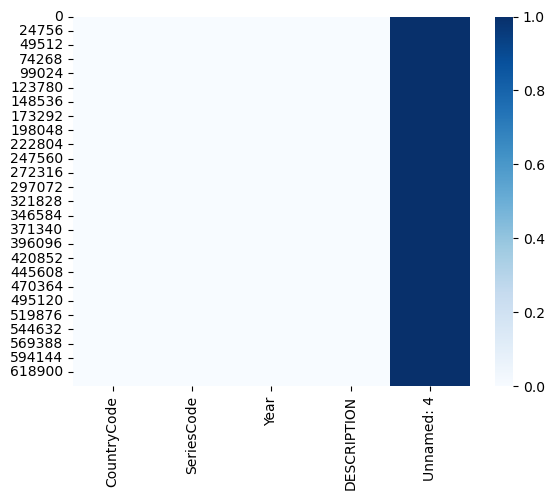

In [74]:
sns.heatmap(footnote.isnull(), cmap='Blues')

In [75]:
#Val manquant
missing_val_DF(footnote)

,Nombre,Pourcentage
CountryCode,0,0.000000
SeriesCode,0,0.000000
Year,0,0.000000
DESCRIPTION,0,0.000000
Unnamed: 4,643638,100.000000


In [76]:
print(footnote['CountryCode'].nunique())
display(footnote['CountryCode'].unique())

239


array(['ABW', 'AFG', 'AGO', 'ALB', 'AND', 'ARB', 'ARE', 'ARG', 'ARM',
       'ASM', 'ATG', 'AUS', 'AUT', 'AZE', 'BDI', 'BEL', 'BEN', 'BFA',
       'BGD', 'BGR', 'BHR', 'BHS', 'BIH', 'BLR', 'BLZ', 'BMU', 'BOL',
       'BRA', 'BRB', 'BRN', 'BTN', 'BWA', 'CAF', 'CAN', 'CHE', 'CHI',
       'CHL', 'CHN', 'CIV', 'CMR', 'COD', 'COG', 'COL', 'COM', 'CPV',
       'CRI', 'CUB', 'CUW', 'CYM', 'CYP', 'CZE', 'DEU', 'DJI', 'DMA',
       'DNK', 'DOM', 'DZA', 'EAP', 'EAS', 'ECA', 'ECS', 'ECU', 'EGY',
       'EMU', 'ERI', 'ESP', 'EST', 'ETH', 'EUU', 'FIN', 'FJI', 'FRA',
       'FRO', 'FSM', 'GAB', 'GBR', 'GEO', 'GHA', 'GIB', 'GIN', 'GMB',
       'GNB', 'GNQ', 'GRC', 'GRD', 'GTM', 'GUM', 'GUY', 'HIC', 'HKG',
       'HND', 'HPC', 'HRV', 'HTI', 'HUN', 'IDN', 'IMN', 'IND', 'IRL',
       'IRN', 'IRQ', 'ISL', 'ISR', 'ITA', 'JAM', 'JOR', 'JPN', 'KAZ',
       'KEN', 'KGZ', 'KHM', 'KIR', 'KNA', 'KOR', 'KWT', 'LAC', 'LAO',
       'LBN', 'LBR', 'LBY', 'LCA', 'LCN', 'LDC', 'LIC', 'LIE', 'LKA',
       'LMC', 'LMY',

In [77]:
print(footnote['SeriesCode'].nunique())
display(footnote['SeriesCode'].unique())

1558


array(['SE.PRE.ENRL.FE', 'SE.TER.TCHR.FE', 'SE.PRE.TCHR.FE', ...,
       'UIS.AFR.GTCTR.2.F', 'UIS.AFR.GTCTR.2.M', 'UIS.AFR.GTCTR.2.T'],
      dtype=object)

In [78]:
ind = footnote['SeriesCode'].value_counts()
mask_ind = ind[:] > 500
print(len(mask_ind))
ind[mask_ind]

1558


SH.DYN.MORT          9226
SE.PRM.AGES          8771
SE.PRM.DURS          8771
SE.SEC.DURS          8619
SE.SEC.AGES          8581
                     ... 
SE.PRM.CMPL.MA.ZS     505
SE.PRM.CMPL.FE.ZS     505
UIS.FOFSTP.1          504
UIS.PTRHC.2           503
UIS.TEP.6             501
Name: SeriesCode, Length: 279, dtype: int64

In [79]:
print(footnote['Year'].nunique())
display(footnote['Year'].sort_values().unique())

56


array(['YR1970', 'YR1971', 'YR1972', 'YR1973', 'YR1974', 'YR1975',
       'YR1976', 'YR1977', 'YR1978', 'YR1979', 'YR1980', 'YR1981',
       'YR1982', 'YR1983', 'YR1984', 'YR1985', 'YR1986', 'YR1987',
       'YR1988', 'YR1989', 'YR1990', 'YR1991', 'YR1992', 'YR1993',
       'YR1994', 'YR1995', 'YR1996', 'YR1997', 'YR1998', 'YR1999',
       'YR2000', 'YR2001', 'YR2002', 'YR2003', 'YR2004', 'YR2005',
       'YR2006', 'YR2007', 'YR2008', 'YR2009', 'YR2010', 'YR2011',
       'YR2012', 'YR2013', 'YR2014', 'YR2015', 'YR2016', 'YR2017',
       'YR2020', 'YR2025', 'YR2030', 'YR2035', 'YR2040', 'YR2045',
       'YR2050', 'yr2012'], dtype=object)

In [80]:
footnote['Year'] = [y[2:] for y in footnote['Year']]
footnote['Year'].sort_values().unique()

array(['1970', '1971', '1972', '1973', '1974', '1975', '1976', '1977',
       '1978', '1979', '1980', '1981', '1982', '1983', '1984', '1985',
       '1986', '1987', '1988', '1989', '1990', '1991', '1992', '1993',
       '1994', '1995', '1996', '1997', '1998', '1999', '2000', '2001',
       '2002', '2003', '2004', '2005', '2006', '2007', '2008', '2009',
       '2010', '2011', '2012', '2013', '2014', '2015', '2016', '2017',
       '2020', '2025', '2030', '2035', '2040', '2045', '2050'],
      dtype=object)

In [81]:
display(footnote['SeriesCode'].nunique())
#display(footnote['DESCRIPTION'].unique().tolist())

1558

In [82]:
len(footnote.groupby('Year')['Year'].count().sort_values(ascending=False))

55

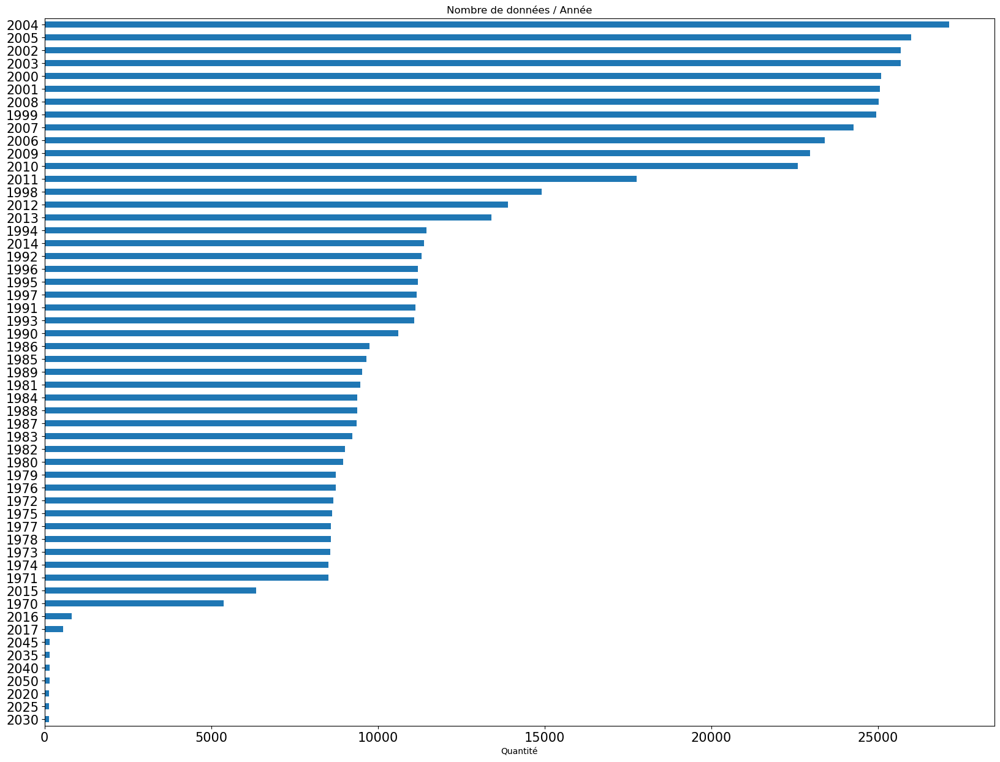

In [83]:
plt.figure(figsize=(20, 15))
footnote.groupby('Year')['Year'].count().sort_values().plot(kind='barh', width=0.5, fontsize=15)
plt.title('Nombre de données / Année')
plt.xlabel('Quantité')
plt.ylabel('')
plt.show()

<a id='5'></a>

### **`EdStatsSeries.csv`**
Informations descriptives sur les indicateurs socio économiques rencontrés sur les jeux de données précédents.

[Haut de page](#sommaire)

In [84]:
#Chargement de 'EdStatsSeries.csv'
seriesCode = pd.read_csv('EdStatsSeries.csv')

#Chengement type les colmns
seriesCode['Topic'] = seriesCode['Topic'].astype("category")
seriesCode['Periodicity'] = seriesCode['Periodicity'].astype("category")
seriesCode['Base Period'] = seriesCode['Base Period'].astype("category")
seriesCode['Other notes'] = seriesCode['Other notes'].astype("category")
seriesCode['Aggregation method'] = seriesCode['Aggregation method'].astype("category")
seriesCode['Limitations and exceptions'] = seriesCode['Limitations and exceptions'].astype("category")
seriesCode['General comments'] = seriesCode['General comments'].astype("category")
seriesCode['Source'] = seriesCode['Source'].astype("category")
seriesCode['Statistical concept and methodology'] = seriesCode['Statistical concept and methodology'].astype("category")
seriesCode['Development relevance'] = seriesCode['Development relevance'].astype("category")
seriesCode['Related source links'] = seriesCode['Related source links'].astype("category")

print("le jeu de données comporte {} lignes et {} colonnes.".format(seriesCode.shape[0], seriesCode.shape[1])) 
seriesCode.head(1)

le jeu de données comporte 3665 lignes et 21 colonnes.


,Series Code,Topic,Indicator Name,Short definition,Long definition,Unit of measure,Periodicity,Base Period,Other notes,Aggregation method,...,Notes from original source,General comments,Source,Statistical concept and methodology,Development relevance,Related source links,Other web links,Related indicators,License Type,Unnamed: 20
0,BAR.NOED.1519.FE.ZS,Attainment,Barro-Lee: Percentage of female population age...,Percentage of female population age 15-19 with...,Percentage of female population age 15-19 with...,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,Robert J. Barro and Jong-Wha Lee: http://www.b...,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [85]:
seriesCode.describe(include=['O'])

,Series Code,Indicator Name,Short definition,Long definition
count,3665,3665,2156,3665
unique,3665,3665,1169,2060
top,BAR.NOED.1519.FE.ZS,Barro-Lee: Percentage of female population age...,Data Interpretation: 1=Latent; 2=Emerging; 3=E...,Data Interpretation: 1=Latent; 2=Emerging; 3=E...
freq,1,1,215,215


In [86]:
seriesCode.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3665 entries, 0 to 3664
Data columns (total 21 columns):
 #   Column                               Non-Null Count  Dtype   
---  ------                               --------------  -----   
 0   Series Code                          3665 non-null   object  
 1   Topic                                3665 non-null   category
 2   Indicator Name                       3665 non-null   object  
 3   Short definition                     2156 non-null   object  
 4   Long definition                      3665 non-null   object  
 5   Unit of measure                      0 non-null      float64 
 6   Periodicity                          99 non-null     category
 7   Base Period                          314 non-null    category
 8   Other notes                          552 non-null    category
 9   Aggregation method                   47 non-null     category
 10  Limitations and exceptions           14 non-null     category
 11  Notes from origin

In [87]:
seriesCode.duplicated('Series Code').sum()

0

<AxesSubplot:>

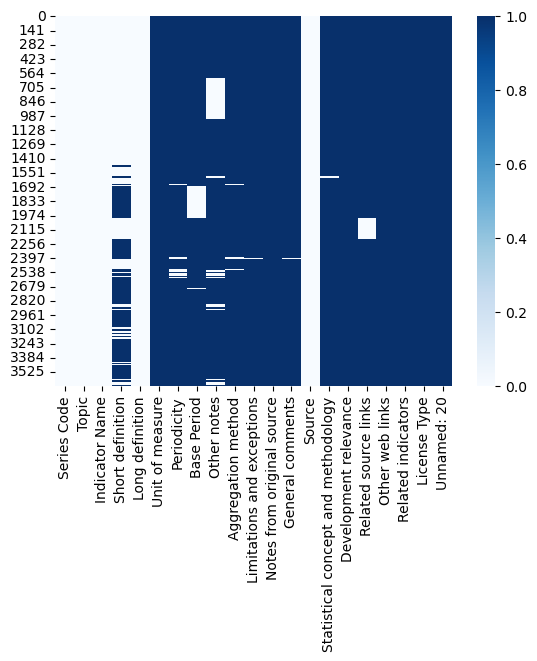

In [88]:
sns.heatmap(seriesCode.isnull(), cmap='Blues')

In [89]:
#Val manquant
missing_val_DF(seriesCode)

,Nombre,Pourcentage
Series Code,0,0.000000
Topic,0,0.000000
Indicator Name,0,0.000000
Long definition,0,0.000000
Source,0,0.000000
Short definition,1509,41.173261
Other notes,3113,84.938608
Base Period,3351,91.432469
Related source links,3450,94.133697
Periodicity,3566,97.298772


In [90]:
display(seriesCode['Series Code'].nunique())
#display(seriesCode['Series Code'].unique().tolist())

3665

In [91]:
seriesCode["Series Code"].value_counts()

BAR.NOED.1519.FE.ZS            1
SP.POP.0710.FE.UN              1
SP.POP.0710.TO.UN              1
SP.POP.0711.FE.UN              1
SP.POP.0711.MA.UN              1
                              ..
LO.PASEC.MAT5.LO.MA            1
LO.PASEC.MAT5.MA               1
LO.PASEC.REA.2                 1
LO.PASEC.REA.2.FE              1
XGDP.56.FSGOV.FDINSTADM.FFD    1
Name: Series Code, Length: 3665, dtype: int64

In [92]:
display(seriesCode['Long definition'].nunique())
#display(seriesCode['Long definition'].unique())#.tolist()

2060

In [93]:
display(seriesCode['Topic'].nunique())
display(seriesCode['Topic'].unique())#.tolist()

37

['Attainment', 'Education Equality', 'Infrastructure: Communications', 'Learning Outcomes', 'Economic Policy & Debt: National accounts: US..., ..., 'Health: Population: Structure', 'Population', 'Health: Population: Dynamics', 'EMIS', 'Post-Secondary/Non-Tertiary']
Length: 37
Categories (37, object): ['Attainment', 'Background', 'EMIS', 'Early Child Development (SABER)', ..., 'Teachers (SABER)', 'Tertiary', 'Tertiary Education (SABER)', 'Workforce Development (SABER)']

In [94]:
display(seriesCode['Indicator Name'].nunique())
display(seriesCode['Indicator Name'].unique())

3665

array(['Barro-Lee: Percentage of female population age 15-19 with no education',
       'Barro-Lee: Percentage of population age 15-19 with no education',
       'Barro-Lee: Percentage of female population age 15+ with no education',
       ..., 'Government expenditure per tertiary student (constant US$)',
       'Government expenditure in secondary institutions education as % of GDP (%)',
       'Government expenditure in tertiary institutions as % of GDP (%)'],
      dtype=object)

In [95]:
display(seriesCode['Periodicity'].nunique())
display(seriesCode['Periodicity'].unique())

1

[NaN, 'Annual']
Categories (1, object): ['Annual']

In [96]:
display(seriesCode['Base Period'].nunique())
display(seriesCode['Base Period'].unique())

4

[NaN, '2010', '2011', 'Projections (2010 to 2100)', '14']
Categories (4, object): ['14', '2010', '2011', 'Projections (2010 to 2100)']

In [97]:
display(seriesCode['Other notes'].nunique())
display(seriesCode['Other notes'].unique())

14

[NaN, 'EGRA', 'PISA', 'Proficiency', 'All Levels', ..., 'Single Level Attainment/ Not Cumulative', 'Cumulative Attainment', 'Mean Years of Schooling', 'Pre-Primary', 'Post-secondary']
Length: 15
Categories (14, object): ['All Levels', 'Cumulative Attainment', 'EGRA', 'Health: Population: Structure', ..., 'Secondary', 'Single Level Attainment/ Not Cumulative', 'Social Protection & Labor: Unemployment', 'Tertiary']

In [98]:
display(seriesCode['Aggregation method'].nunique())
display(seriesCode['Aggregation method'].unique())

3

[NaN, 'Weighted average', 'Gap-filled total', 'Sum']
Categories (3, object): ['Gap-filled total', 'Sum', 'Weighted average']

In [99]:
display(seriesCode['Limitations and exceptions'].nunique())
display(seriesCode['Limitations and exceptions'].unique())

9

[NaN, 'Operators have traditionally been the main so..., 'Gross domestic product (GDP), though widely t..., 'Each industry's contribution to growth in the..., 'The limited availability of data on health st..., 'Complete vital registration systems are fairl..., 'Data should be used cautiously because of dif..., 'The criteria for people considered to be seek..., 'Because the five-year age group is the cohort..., 'Current population estimates for developing c...]
Categories (9, object): ['Because the five-year age group is the cohort..., 'Complete vital registration systems are fairl..., 'Current population estimates for developing c..., 'Data should be used cautiously because of dif..., ..., 'Gross domestic product (GDP), though widely t..., 'Operators have traditionally been the main so..., 'The criteria for people considered to be seek..., 'The limited availability of data on health st...]

In [100]:
display(seriesCode['General comments'].nunique())
display(seriesCode['General comments'].unique())

8

[NaN, 'Restricted use: Please cite the International..., 'Please cite the International Telecommunicati..., 'Given that data on the incidence and prevalen..., 'Data up to 2016 are estimates while data from..., 'When NEET rates are available for more than t..., 'Data up to 2016 are estimates while data from..., 'Relevance to gender indicator: Knowing how ma..., 'Relevance to gender indicator: disaggregating...]
Categories (8, object): ['Data up to 2016 are estimates while data from..., 'Data up to 2016 are estimates while data from..., 'Given that data on the incidence and prevalen..., 'Please cite the International Telecommunicati..., 'Relevance to gender indicator: Knowing how ma..., 'Relevance to gender indicator: disaggregating..., 'Restricted use: Please cite the International..., 'When NEET rates are available for more than t...]

In [101]:
display(seriesCode['Source'].nunique())
display(seriesCode['Source'].unique())

31

['Robert J. Barro and Jong-Wha Lee: http://www...., 'Demographic and Health Surveys (DHS)', 'World Bank staff calculations based on Multip..., 'Multiple Indicator Cluster Surveys (MICS)', 'International Telecommunication Union, World ..., ..., 'World Bank staff estimates based on age/sex d..., 'UNESCO Institute for Statistics (Derived)', 'UNESCO Institute for Statistics.', 'Derived from total population. Population sou..., '(1) United Nations Population Division. World...]
Length: 31
Categories (31, object): ['(1) United Nations Population Division. World..., 'Demographic and Health Surveys (DHS)', 'Derived from total population. Population sou..., 'Derived using data from International Labour ..., ..., 'World Bank staff calculations based on Multip..., 'World Bank staff estimates based on age/sex d..., 'World Bank staff estimates using the World Ba..., 'World Bank, International Comparison Program ...]

In [102]:
display(seriesCode['Statistical concept and methodology'].nunique())
display(seriesCode['Statistical concept and methodology'].unique())

2

[NaN, 'TIMSS', 'The standard definition of unemployed persons...]
Categories (2, object): ['TIMSS', 'The standard definition of unemployed persons...]

In [103]:
display(seriesCode['Development relevance'].nunique())
display(seriesCode['Development relevance'].unique())

1

[NaN, 'Unemployment and total employment are the bro...]
Categories (1, object): ['Unemployment and total employment are the bro...]

In [104]:
display(seriesCode['Related source links'].nunique())
display(seriesCode['Related source links'].unique())

1

[NaN, 'http://saber.worldbank.org/index.cfm']
Categories (1, object): ['http://saber.worldbank.org/index.cfm']

<a id='p2'></a>

## Analyse des données

<a id='7'></a>

### Préparation de DataFrame

[Haut de page](#sommaire)

 **`EdStatsCountry.csv`**


In [105]:
country = pd.read_csv('EdStatsCountry.csv').dropna(how='all', axis='columns')
print("le jeu de données comporte {} lignes et {} colonnes.".format(country.shape[0], country.shape[1])) 
country.head(1)

le jeu de données comporte 241 lignes et 31 colonnes.


,Country Code,Short Name,Table Name,Long Name,2-alpha code,Currency Unit,Special Notes,Region,Income Group,WB-2 code,...,Government Accounting concept,IMF data dissemination standard,Latest population census,Latest household survey,Source of most recent Income and expenditure data,Vital registration complete,Latest agricultural census,Latest industrial data,Latest trade data,Latest water withdrawal data
0,ABW,Aruba,Aruba,Aruba,AW,Aruban florin,SNA data for 2000-2011 are updated from offici...,Latin America & Caribbean,High income: nonOECD,AW,...,NaN,NaN,2010,NaN,NaN,Yes,NaN,NaN,2012.0,NaN


In [106]:
#country.columns

In [107]:
col_supp = ['WB-2 code', 'Table Name', '2-alpha code', 'Special Notes',
       'National accounts base year', 'National accounts reference year',
       'SNA price valuation', 'Lending category', 'Other groups',
       'System of National Accounts', 'Alternative conversion factor',
       'PPP survey year', 'Balance of Payments Manual in use',
       'External debt Reporting status', 'System of trade',
       'Government Accounting concept', 'IMF data dissemination standard',
       'Latest population census', 'Latest household survey',
       'Source of most recent Income and expenditure data',
       'Vital registration complete', 'Latest agricultural census',
       'Latest industrial data', 'Latest trade data',
       'Latest water withdrawal data']


In [108]:
country = country.drop(col_supp, axis=1)
country

,Country Code,Short Name,Long Name,Currency Unit,Region,Income Group
0,ABW,Aruba,Aruba,Aruban florin,Latin America & Caribbean,High income: nonOECD
1,AFG,Afghanistan,Islamic State of Afghanistan,Afghan afghani,South Asia,Low income
2,AGO,Angola,People's Republic of Angola,Angolan kwanza,Sub-Saharan Africa,Upper middle income
3,ALB,Albania,Republic of Albania,Albanian lek,Europe & Central Asia,Upper middle income
4,AND,Andorra,Principality of Andorra,Euro,Europe & Central Asia,High income: nonOECD
...,...,...,...,...,...,...
236,XKX,Kosovo,Republic of Kosovo,Euro,Europe & Central Asia,Lower middle income
237,YEM,Yemen,Republic of Yemen,Yemeni rial,Middle East & North Africa,Lower middle income
238,ZAF,South Africa,Republic of South Africa,South African rand,Sub-Saharan Africa,Upper middle income
239,ZMB,Zambia,Republic of Zambia,New Zambian kwacha,Sub-Saharan Africa,Lower middle income


In [109]:
#sns.heatmap(country.isnull())

<AxesSubplot:>

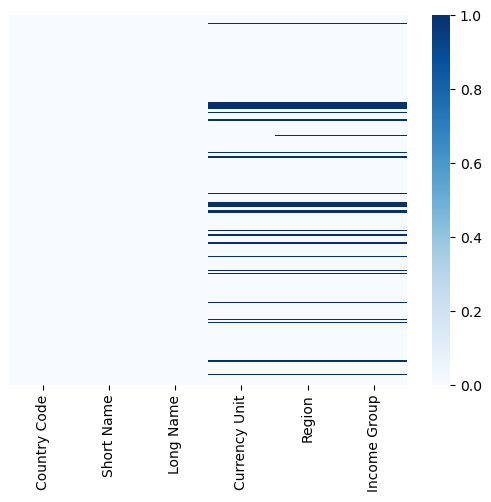

In [110]:
sns.heatmap(country.isnull(), yticklabels = False, cbar = True, cmap='Blues')

In [111]:
check_for_any_nan= country['Region'].isna()
print(len(country[check_for_any_nan]))
country[check_for_any_nan]

27


,Country Code,Short Name,Long Name,Currency Unit,Region,Income Group
5,ARB,Arab World,Arab World,NaN,NaN,NaN
57,EAP,East Asia & Pacific (developing only),East Asia & Pacific (developing only),NaN,NaN,NaN
58,EAS,East Asia & Pacific (all income levels),East Asia & Pacific (all income levels),NaN,NaN,NaN
59,ECA,Europe & Central Asia (developing only),Europe & Central Asia (developing only),NaN,NaN,NaN
60,ECS,Europe & Central Asia (all income levels),Europe & Central Asia (all income levels),NaN,NaN,NaN
63,EMU,Euro area,Euro area,NaN,NaN,NaN
68,EUU,European Union,European Union,NaN,NaN,NaN
78,GIB,Gibraltar,Gibraltar,Gibraltar pound,NaN,NaN
89,HIC,High income,High income,NaN,NaN,NaN
92,HPC,Heavily indebted poor countries (HIPC),Heavily indebted poor countries (HIPC),NaN,NaN,NaN


In [112]:
not_country = country[check_for_any_nan].index
country = country.drop(not_country, axis = 0)
country

,Country Code,Short Name,Long Name,Currency Unit,Region,Income Group
0,ABW,Aruba,Aruba,Aruban florin,Latin America & Caribbean,High income: nonOECD
1,AFG,Afghanistan,Islamic State of Afghanistan,Afghan afghani,South Asia,Low income
2,AGO,Angola,People's Republic of Angola,Angolan kwanza,Sub-Saharan Africa,Upper middle income
3,ALB,Albania,Republic of Albania,Albanian lek,Europe & Central Asia,Upper middle income
4,AND,Andorra,Principality of Andorra,Euro,Europe & Central Asia,High income: nonOECD
...,...,...,...,...,...,...
236,XKX,Kosovo,Republic of Kosovo,Euro,Europe & Central Asia,Lower middle income
237,YEM,Yemen,Republic of Yemen,Yemeni rial,Middle East & North Africa,Lower middle income
238,ZAF,South Africa,Republic of South Africa,South African rand,Sub-Saharan Africa,Upper middle income
239,ZMB,Zambia,Republic of Zambia,New Zambian kwacha,Sub-Saharan Africa,Lower middle income


In [113]:
#sns.heatmap(country.isnull())

<AxesSubplot:>

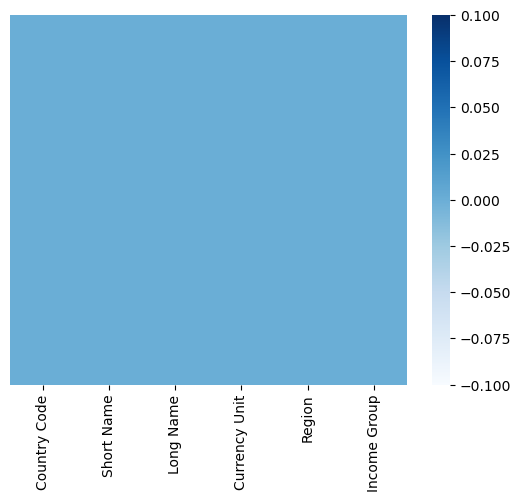

In [114]:
sns.heatmap(country.isnull(), yticklabels = False, cbar = True, cmap='Blues')

 **`EdStatsCountry-Series.csv`**


[Haut de page](#sommaire)

In [115]:
countrySeries = pd.read_csv('EdStatsCountry-Series.csv').dropna(how='all', axis='columns')
print("le jeu de données comporte {} lignes et {} colonnes.".format(countrySeries.shape[0], countrySeries.shape[1])) 
countrySeries.head(1)

le jeu de données comporte 613 lignes et 3 colonnes.


,CountryCode,SeriesCode,DESCRIPTION
0,ABW,SP.POP.TOTL,Data sources : United Nations World Population...


In [116]:
countrySeries.drop(['DESCRIPTION'], axis = 1)

,CountryCode,SeriesCode
0,ABW,SP.POP.TOTL
1,ABW,SP.POP.GROW
2,AFG,SP.POP.GROW
3,AFG,NY.GDP.PCAP.PP.CD
4,AFG,SP.POP.TOTL
...,...,...
608,ZAF,SP.POP.GROW
609,ZMB,SP.POP.GROW
610,ZMB,SP.POP.TOTL
611,ZWE,SP.POP.TOTL


**`EdStatsData.csv`**

In [117]:
data = pd.read_csv('EdStatsData.csv').dropna(how='all', axis='columns')
print("le jeu de données comporte {} lignes et {} colonnes.".format(data.shape[0], data.shape[1])) 
data.head(1)

le jeu de données comporte 886930 lignes et 69 colonnes.


,Country Name,Country Code,Indicator Name,Indicator Code,1970,1971,1972,1973,1974,1975,...,2055,2060,2065,2070,2075,2080,2085,2090,2095,2100
0,Arab World,ARB,"Adjusted net enrolment rate, lower secondary, ...",UIS.NERA.2,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [118]:
#data.columns

In [119]:
data_cols_supp = ['1970', '1971', '1972', '1973', '1974', '1975', '1976', '1977', '1978',
       '1979', '1980', '1981', '1982', '1983', '1984', '1985', '1986', '1987',
       '1988', '1989', '1990', '1991', '1992', '1993', '1994', '1995', '1996',
       '1997', '1998', '1999', '2016', '2017', '2020', '2025', '2030', '2035', '2040', '2045',
       '2050', '2055', '2060', '2065', '2070', '2075', '2080', '2085', '2090',
       '2095', '2100' ]

In [120]:
years = ['2000', '2001', '2002', '2003', '2004', '2005', '2006', '2007', '2008',
       '2009', '2010', '2011', '2012', '2013', '2014', '2015']

#Supprimer les cols pas utile
data_existe = data.drop(data_cols_supp, axis=1)

#Supprimer les rows sans valeur
data_existe.dropna(how='all',inplace=True, subset=years)

print("le jeu de données comporte {} lignes et {} colonnes.".format(data_existe.shape[0], data_existe.shape[1])) 
data_existe.head(1)

le jeu de données comporte 348113 lignes et 20 colonnes.


,Country Name,Country Code,Indicator Name,Indicator Code,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015
4,Arab World,ARB,"Adjusted net enrolment rate, primary, both sex...",SE.PRM.TENR,77.245682,78.800522,80.051399,80.805389,81.607063,82.489487,82.685509,83.280342,84.011871,84.195961,85.211998,85.24514,86.101669,85.51194,85.320152,NaN


In [121]:
# data_existe.isnull().sum()

In [122]:
#sns.heatmap(data_existe.isna())

<AxesSubplot:>

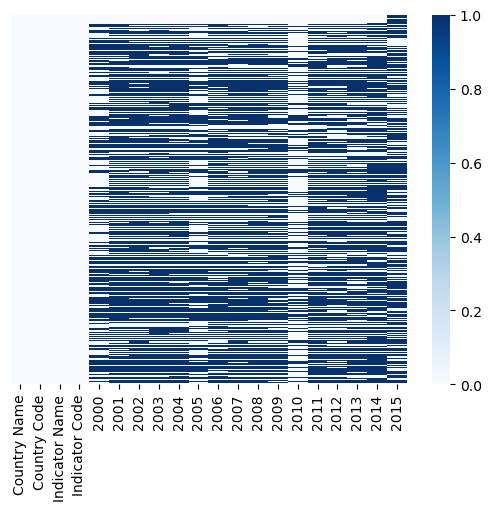

In [123]:
sns.heatmap(data_existe.isnull(), yticklabels = False, cbar = True, cmap='Blues')

In [124]:
data_existe2 = data_existe.iloc[:,4:]
data_existe2.tail()

,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015
886925,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,166679.00000,NaN,NaN,199464.00000,NaN
886926,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,90.93070,NaN,NaN,90.42812,NaN
886927,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,92.12456,NaN,NaN,93.18835,NaN
886928,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.02828,NaN,NaN,1.06389,NaN
886929,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,89.59058,NaN,NaN,87.59186,NaN


In [125]:
data_existe2.fillna(method = 'ffill', axis = 1, inplace = True)
data_existe2.tail()

,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015
886925,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,166679.00000,166679.00000,166679.00000,199464.00000,199464.00000
886926,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,90.93070,90.93070,90.93070,90.42812,90.42812
886927,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,92.12456,92.12456,92.12456,93.18835,93.18835
886928,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.02828,1.02828,1.02828,1.06389,1.06389
886929,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,89.59058,89.59058,89.59058,87.59186,87.59186


In [126]:
#sns.heatmap(data_existe2.isna())

<AxesSubplot:>

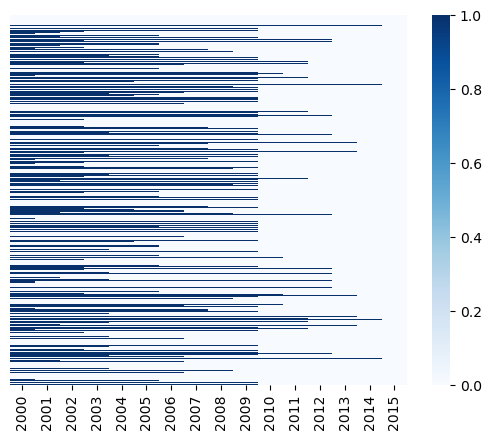

In [127]:
sns.heatmap(data_existe2.isnull(), yticklabels = False, cbar = True, cmap='Blues')

In [128]:
data_existe['Value'] = data_existe2['2015']

In [129]:
#data_existe.columns

In [130]:
existe_col = ['Country Name', 'Country Code', 'Indicator Name', 'Indicator Code', 'Value']
data_existe_final = data_existe[existe_col]
data_existe_final

,Country Name,Country Code,Indicator Name,Indicator Code,Value
4,Arab World,ARB,"Adjusted net enrolment rate, primary, both sex...",SE.PRM.TENR,85.320152
5,Arab World,ARB,"Adjusted net enrolment rate, primary, female (%)",SE.PRM.TENR.FE,83.820831
6,Arab World,ARB,"Adjusted net enrolment rate, primary, gender p...",UIS.NERA.1.GPI,0.966200
7,Arab World,ARB,"Adjusted net enrolment rate, primary, male (%)",SE.PRM.TENR.MA,86.753387
12,Arab World,ARB,Adjusted net intake rate to Grade 1 of primary...,UIS.NIRA.1,76.620567
...,...,...,...,...,...
886925,Zimbabwe,ZWE,"Youth illiterate population, 15-24 years, male...",UIS.LP.AG15T24.M,199464.000000
886926,Zimbabwe,ZWE,"Youth literacy rate, population 15-24 years, b...",SE.ADT.1524.LT.ZS,90.428120
886927,Zimbabwe,ZWE,"Youth literacy rate, population 15-24 years, f...",SE.ADT.1524.LT.FE.ZS,93.188350
886928,Zimbabwe,ZWE,"Youth literacy rate, population 15-24 years, g...",SE.ADT.1524.LT.FM.ZS,1.063890


In [131]:
#dtale.show(data)

<AxesSubplot:>

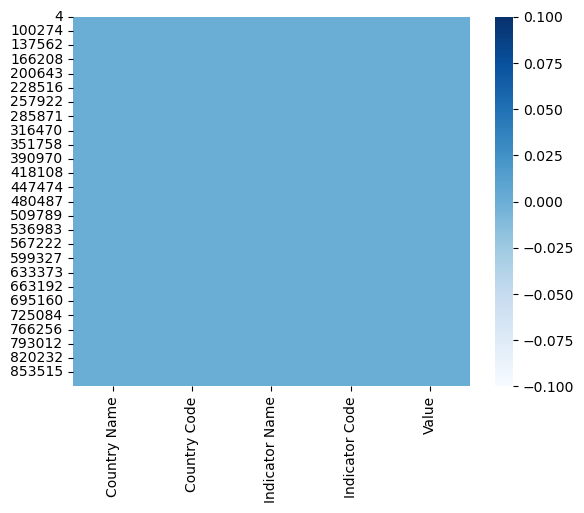

In [132]:
sns.heatmap(data_existe_final.isna(), cbar = True, cmap='Blues')

**Préparation de DataFrame**

[Haut de page](#sommaire)

In [133]:
#Merge deux DataFrame principaux 
df_final = pd.merge(data_existe_final, country[['Country Code', 'Region', 'Income Group']], how= 'left', on = 'Country Code' )
df_final

,Country Name,Country Code,Indicator Name,Indicator Code,Value,Region,Income Group
0,Arab World,ARB,"Adjusted net enrolment rate, primary, both sex...",SE.PRM.TENR,85.320152,NaN,NaN
1,Arab World,ARB,"Adjusted net enrolment rate, primary, female (%)",SE.PRM.TENR.FE,83.820831,NaN,NaN
2,Arab World,ARB,"Adjusted net enrolment rate, primary, gender p...",UIS.NERA.1.GPI,0.966200,NaN,NaN
3,Arab World,ARB,"Adjusted net enrolment rate, primary, male (%)",SE.PRM.TENR.MA,86.753387,NaN,NaN
4,Arab World,ARB,Adjusted net intake rate to Grade 1 of primary...,UIS.NIRA.1,76.620567,NaN,NaN
...,...,...,...,...,...,...,...
348108,Zimbabwe,ZWE,"Youth illiterate population, 15-24 years, male...",UIS.LP.AG15T24.M,199464.000000,Sub-Saharan Africa,Low income
348109,Zimbabwe,ZWE,"Youth literacy rate, population 15-24 years, b...",SE.ADT.1524.LT.ZS,90.428120,Sub-Saharan Africa,Low income
348110,Zimbabwe,ZWE,"Youth literacy rate, population 15-24 years, f...",SE.ADT.1524.LT.FE.ZS,93.188350,Sub-Saharan Africa,Low income
348111,Zimbabwe,ZWE,"Youth literacy rate, population 15-24 years, g...",SE.ADT.1524.LT.FM.ZS,1.063890,Sub-Saharan Africa,Low income


columns_name = country.columns
country.columns = [columns_name.replace(" ", "_") for columns_name in country.columns ]

In [134]:
#Supprimer les rows inutile
df_final.dropna(how = 'any', subset=['Region'], inplace = True)

#Chengement le nom de cols
columnsN = df_final.columns
df_final.columns =  [columnN.replace(' ','_') for columnN in df_final.columns]

#Chengement type (avant memory usage: 20.6+ MB)
df_final['Income_Group'] = df_final['Income_Group'].astype("category")

   
print(f"le jeu de données comporte {df_final.shape[0]} lignes et {df_final.shape[1]} colonnes." ) 

display(df_final.head(3))


le jeu de données comporte 338100 lignes et 7 colonnes.


,Country_Name,Country_Code,Indicator_Name,Indicator_Code,Value,Region,Income_Group
9308,Afghanistan,AFG,"Adjusted net enrolment rate, lower secondary, ...",UIS.NERA.2,50.627232,South Asia,Low income
9309,Afghanistan,AFG,"Adjusted net enrolment rate, lower secondary, ...",UIS.NERA.2.F,37.641541,South Asia,Low income
9310,Afghanistan,AFG,"Adjusted net enrolment rate, lower secondary, ...",UIS.NERA.2.GPI,0.598370,South Asia,Low income


In [135]:
df_final.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 338100 entries, 9308 to 348112
Data columns (total 7 columns):
 #   Column          Non-Null Count   Dtype   
---  ------          --------------   -----   
 0   Country_Name    338100 non-null  object  
 1   Country_Code    338100 non-null  object  
 2   Indicator_Name  338100 non-null  object  
 3   Indicator_Code  338100 non-null  object  
 4   Value           338100 non-null  float64 
 5   Region          338100 non-null  object  
 6   Income_Group    338100 non-null  category
dtypes: category(1), float64(1), object(5)
memory usage: 18.4+ MB


<a id='8'></a>
---

### Choix des indicateurs

[Haut de page](#sommaire)

In [136]:
df_final['Indicator_Group'] = df_final['Indicator_Code'].apply(lambda x: x.split('.')[0])

df_final.head(3)

,Country_Name,Country_Code,Indicator_Name,Indicator_Code,Value,Region,Income_Group,Indicator_Group
9308,Afghanistan,AFG,"Adjusted net enrolment rate, lower secondary, ...",UIS.NERA.2,50.627232,South Asia,Low income,UIS
9309,Afghanistan,AFG,"Adjusted net enrolment rate, lower secondary, ...",UIS.NERA.2.F,37.641541,South Asia,Low income,UIS
9310,Afghanistan,AFG,"Adjusted net enrolment rate, lower secondary, ...",UIS.NERA.2.GPI,0.598370,South Asia,Low income,UIS


**Nombre d'indicateurs par groupe**

In [137]:
#indicator len
indi_total =pd.DataFrame(df_final['Indicator_Group'].value_counts()).reset_index()
indi_total.rename(columns = {'index': 'Indicator_Group', 'Indicator_Group':'Indic_len'}, inplace = True)


#indicator counts
indic_group = df_final.loc[:, ['Indicator_Group', 'Indicator_Code']].\
    drop_duplicates().groupby('Indicator_Group').count().\
    reset_index().\
    rename(columns={'Indicator_Code':'Indic_Count'}).sort_values(by='Indic_Count', ascending= False)

indic_group = pd.DataFrame(indic_group.fillna(""))



#indicator merge DF
indics = pd.merge(indi_total, indic_group, how = 'left', on = 'Indicator_Group' )
indics

,Indicator_Group,Indic_len,Indic_Count
0,UIS,122412,1047
1,BAR,51840,360
2,PRJ,51128,308
3,SP,41408,215
4,SE,29167,173
5,LO,22036,1034
6,HH,11218,250
7,SABER,2795,197
8,NY,2368,12
9,SL,1962,17


In [138]:
df_data = data.copy()
df_data['Indicator Group'] = df_data.loc[:,'Indicator Code'].apply(lambda x: x.split('.')[0])

In [139]:
# Valeurs non null par années
years_not_null = df_data.loc[:, '1970':'2100'].notnull()

# Ajout de la colonne des groupes d'indicateurs
temp = pd.concat([df_data[['Indicator Group']], years_not_null], axis=1)

# Proportion de données présentes pour chaque groupe
group_indic_null = temp.groupby(['Indicator Group']).mean()

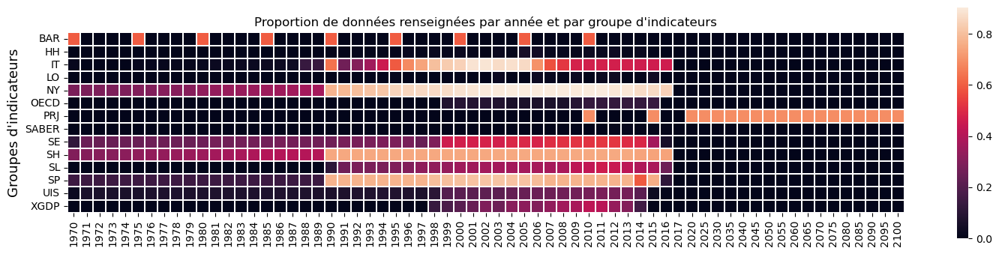

In [140]:
# Heatmap des données présentes par groupe d'indicateurs
fig = plt.figure(figsize=(18,4))

sns.heatmap(group_indic_null, square=True, linewidths=0.1)
plt.title("Proportion de données renseignées par année et par groupe d'indicateurs")
plt.ylabel('Groupes d\'indicateurs', fontsize=13)
plt.show()

**PRJ**

In [141]:
mask_PRJ = df_final['Indicator_Group'] == 'PRJ'
print(len(df_final[mask_PRJ]['Indicator_Name'].unique().tolist()))
#df_final[mask_PRJ]['Indicator_Name'].unique().tolist()

308


In [142]:
PRJ_choix=['Wittgenstein Projection: Percentage of the total population by highest level of educational attainment. Post Secondary. Total']

In [143]:
#Trouver le code correspondant PRJ
PRJ_choix_code = list(df_final[df_final['Indicator_Name'].isin(PRJ_choix)]['Indicator_Code'].unique())
PRJ_choix_code

['PRJ.ATT.ALL.4.MF']

**UIS**

In [144]:
# mask_usi = df_final['Indicator_Group'] == 'UIS'
# print(len(df_final[mask_usi]['Indicator_Name'].unique().tolist()))
# df_final[mask_usi]['Indicator_Name'].unique().tolist()

**BAR**

In [145]:
# mask_BAR = df_final['Indicator_Group'] == 'BAR'
# print(len(df_final[mask_BAR]['Indicator_Name'].unique().tolist()))
# df_final[mask_BAR]['Indicator_Name'].unique().tolist()

**SP**

In [146]:
mask_SP = df_final['Indicator_Group'] == 'SP'
print(len(df_final[mask_SP]['Indicator_Name'].unique().tolist()))
#df_final[mask_SP]['Indicator_Name'].unique()#.tolist()

215


In [147]:
SP_choix = ['Population of the official age for secondary education, both sexes (number)',
            'Population of the official age for tertiary education, both sexes (number)']

In [148]:
#Trouver le code correspondant SP
SP_choix_code = list(df_final[df_final['Indicator_Name'].isin(SP_choix)]['Indicator_Code'].unique())
SP_choix_code

['SP.SEC.TOTL.IN', 'SP.TER.TOTL.IN']

**SE**

In [149]:
mask_SE = df_final['Indicator_Group'] == 'SE'
print(len(df_final[mask_SE]['Indicator_Name'].unique().tolist()))
#df_final[mask_SE]['Indicator_Name'].unique()#.tolist()

173


In [150]:
SE_choix = [ 'Enrolment in secondary education, both sexes (number)',
            'Enrolment in tertiary education, all programmes, both sexes (number)']     


In [151]:
#Trouver le code correspondant SE
SE_choix_code = list(df_final[df_final['Indicator_Name'].isin(SE_choix)]['Indicator_Code'].unique())
SE_choix_code

['SE.SEC.ENRL', 'SE.TER.ENRL']

**LO**

In [152]:
# mask_LO = df_final['Indicator_Group'] == 'LO'
# print(len(df_final[mask_LO]['Indicator_Name'].unique().tolist()))
# df_final[mask_LO]['Indicator_Name'].unique().tolist()

**HH**

In [153]:
# mask_HH = df_final['Indicator_Group'] == 'HH'
# print(len(df_final[mask_HH]['Indicator_Name'].unique().tolist()))
# df_final[mask_HH]['Indicator_Name'].unique().tolist()

**SABER**

In [154]:
# mask_SABER = df_final['Indicator_Group'] == 'SABER'
# print(len(df_final[mask_SABER]['Indicator_Name'].unique().tolist()))
# df_final[mask_SABER]['Indicator_Name'].unique().tolist()

**NY**

In [155]:
mask_NY = df_final['Indicator_Group'] == 'NY'
print(len(df_final[mask_NY]['Indicator_Name'].unique().tolist()))
df_final[mask_NY]['Indicator_Name'].unique().tolist()

12


['GDP at market prices (constant 2005 US$)',
 'GDP at market prices (current US$)',
 'GDP per capita (constant 2005 US$)',
 'GDP per capita (current US$)',
 'GDP per capita, PPP (constant 2011 international $)',
 'GDP per capita, PPP (current international $)',
 'GDP, PPP (constant 2011 international $)',
 'GDP, PPP (current international $)',
 'GNI (current US$)',
 'GNI per capita, Atlas method (current US$)',
 'GNI per capita, PPP (current international $)',
 'GNI, PPP (current international $)']

In [156]:
NY_choix = [ 'GDP per capita (current US$)']

In [157]:
#Trouver le code correspondant NY
NY_choix_code = list(df_final[df_final['Indicator_Name'].isin(NY_choix)]['Indicator_Code'].unique())
NY_choix_code

['NY.GDP.PCAP.CD']

**SL**

In [158]:
# mask_SL = df_final['Indicator_Group'] == 'SL'
# print(len(df_final[mask_SL]['Indicator_Name'].unique().tolist()))
# df_final[mask_SL]['Indicator_Name'].unique().tolist()

**OECD**

In [159]:
# mask_OECD = df_final['Indicator_Group'] == 'OECD'
# print(len(df_final[mask_OECD]['Indicator_Name'].unique().tolist()))
# df_final[mask_OECD]['Indicator_Name'].unique().tolist()

**IT**

In [160]:
mask_IT = df_final['Indicator_Group'] == 'IT'
print(len(df_final[mask_IT]['Indicator_Name'].unique().tolist()))
df_final[mask_IT]['Indicator_Name'].unique().tolist()

2


['Internet users (per 100 people)', 'Personal computers (per 100 people)']

In [161]:
IT_choix = ['Internet users (per 100 people)', 'Personal computers (per 100 people)']

In [162]:
#Trouver le code correspondant IT
IT_choix_code = df_final[df_final['Indicator_Name'].isin(IT_choix)]['Indicator_Code'].unique()
IT_choix_code = list(IT_choix_code)
IT_choix_code

['IT.NET.USER.P2', 'IT.CMP.PCMP.P2']

**XGDP**

In [163]:
# mask_XGDP = df_final['Indicator_Group'] == 'XGDP'
# print(len(df_final[mask_XGDP]['Indicator_Name'].unique().tolist()))
# df_final[mask_XGDP]['Indicator_Name'].unique().tolist()

**SH**

In [164]:
# mask_SH = df_final['Indicator_Group'] == 'SH'
# print(len(df_final[mask_SH]['Indicator_Name'].unique().tolist()))
# df_final[mask_SH]['Indicator_Name'].unique().tolist()

**PRJ**

In [165]:
PRJ_choix = ['Wittgenstein Projection: Population in thousands by highest level of educational attainment. Post Secondary. Total']


In [166]:
indicators_choix = SP_choix_code + SE_choix_code + NY_choix_code + IT_choix_code
print(f'Indicators choisies sont:\n {indicators_choix}')

Indicators choisies sont:
 ['SP.SEC.TOTL.IN', 'SP.TER.TOTL.IN', 'SE.SEC.ENRL', 'SE.TER.ENRL', 'NY.GDP.PCAP.CD', 'IT.NET.USER.P2', 'IT.CMP.PCMP.P2']



<div style='background-color: #ffc0cb ; padding: 10px; border: 5px solid black;'>
    
**SP**
- 'Population of the official age for secondary education, both sexes (number)', ✅**SP.SEC.TOTL.IN** (Population d'âge officiel pour l'enseignement secondaire) 
-  'Population of the official age for tertiary education, both sexes (number)' , ✅**SP.TER.TOTL.IN** (Population d'âge officiel pour l'enseignement supérieur) 
________________________________________________________________________________________________________________________
**SE**
- 'Enrolment in secondary education, both sexes (number)' ✅**SE.SEC.ENRL**(Inscription dans l'enseignement secondaire) 
- 'Enrolment in tertiary education, all programmes, both sexes (number)' ✅**SE.TER.ENRL**(Inscription dans l'enseignement  supérieur) 
________________________________________________________________________________________________________________________

**NY**
-  'GDP per capita (current US$)', ✅**NY.GDP.PCAP.CD** (PIB par habitant (USD courants))	
________________________________________________________________________________________________________________________

**IT**
- 'Internet users (per 100 people)', ✅**IT.NET.USER.P2**
- 'Personal computers (per 100 people)' , ✅**IT.CMP.PCMP.P2**

 </div>

In [167]:
#Mask pour les 7 indicateurs
final_mask_indic = df_final['Indicator_Code'].isin(indicators_choix)

#Mask pour les pays Low income
final_mask_low = df_final['Income_Group'] != 'Low income'

df_final_indic_notlow = df_final[final_mask_indic & final_mask_low]

print(f'Nan --> {df_final_indic_notlow.isna().sum().sum()}')
df_final_indic_notlow

Nan --> 0


,Country_Name,Country_Code,Indicator_Name,Indicator_Code,Value,Region,Income_Group,Indicator_Group
11215,Albania,ALB,"Enrolment in secondary education, both sexes (...",SE.SEC.ENRL,3.150790e+05,Europe & Central Asia,Upper middle income,SE
11228,Albania,ALB,"Enrolment in tertiary education, all programme...",SE.TER.ENRL,1.605270e+05,Europe & Central Asia,Upper middle income,SE
11262,Albania,ALB,GDP per capita (current US$),NY.GDP.PCAP.CD,3.934895e+03,Europe & Central Asia,Upper middle income,NY
11381,Albania,ALB,Internet users (per 100 people),IT.NET.USER.P2,6.325293e+01,Europe & Central Asia,Upper middle income,IT
11728,Albania,ALB,Personal computers (per 100 people),IT.CMP.PCMP.P2,4.593538e+00,Europe & Central Asia,Upper middle income,IT
...,...,...,...,...,...,...,...,...
344895,Zambia,ZMB,GDP per capita (current US$),NY.GDP.PCAP.CD,1.313890e+03,Sub-Saharan Africa,Lower middle income,NY
344959,Zambia,ZMB,Internet users (per 100 people),IT.NET.USER.P2,2.100000e+01,Sub-Saharan Africa,Lower middle income,IT
345075,Zambia,ZMB,Personal computers (per 100 people),IT.CMP.PCMP.P2,1.142108e+00,Sub-Saharan Africa,Lower middle income,IT
345089,Zambia,ZMB,Population of the official age for secondary e...,SP.SEC.TOTL.IN,1.821221e+06,Sub-Saharan Africa,Lower middle income,SP


<a id='p3'></a>

## Visualisation

<a id='10'></a>

### Indicateur sur les ressources informatiques

[Haut de page](#sommaire)

In [168]:
data_region = pd.merge(data, country[['Country Code','Region']], how='left', left_on='Country Code', right_on='Country Code')
data_region.head(3)

,Country Name,Country Code,Indicator Name,Indicator Code,1970,1971,1972,1973,1974,1975,...,2060,2065,2070,2075,2080,2085,2090,2095,2100,Region
0,Arab World,ARB,"Adjusted net enrolment rate, lower secondary, ...",UIS.NERA.2,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Arab World,ARB,"Adjusted net enrolment rate, lower secondary, ...",UIS.NERA.2.F,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Arab World,ARB,"Adjusted net enrolment rate, lower secondary, ...",UIS.NERA.2.GPI,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


**`IT.NET.USER.P2`**

In [169]:
df_it_net = df_final_indic_notlow[df_final_indic_notlow['Indicator_Code'] == 'IT.NET.USER.P2'].sort_values('Value', ascending = False)
print(df_it_net.shape)
print(f'Nan --> {df_it_net.isna().sum().sum()}')
df_it_net.head(3)

(170, 8)
Nan --> 0


,Country_Name,Country_Code,Indicator_Name,Indicator_Code,Value,Region,Income_Group,Indicator_Group
41849,Bermuda,BMU,Internet users (per 100 people),IT.NET.USER.P2,98.32361,North America,High income: nonOECD,IT
144129,Iceland,ISL,Internet users (per 100 people),IT.NET.USER.P2,98.20000,Europe & Central Asia,High income: OECD,IT
189944,Luxembourg,LUX,Internet users (per 100 people),IT.NET.USER.P2,97.33410,Europe & Central Asia,High income: OECD,IT


In [170]:
#Boxplot
fig_it_net_box =px.box(df_it_net, x='Region', y = 'Value', points='all')
fig_it_net_box.update_layout(
    title={"text": "Internautes (pour 100 personnes)", "font": {"size": 24}},
    xaxis_title="Region",
    yaxis_title="Valeur"
)

#Heatmap
fig_it_net_heat = px.density_heatmap(df_it_net, x='Region', y='Country_Name', z='Value',  color_continuous_scale='cividis')
fig_it_net_heat.update_layout(
    title=dict(
        text="Internautes (pour 100 personnes)",
        font=dict(
            family="Courier New, monospace",
            size=18,
            color="#7f7f7f"
        )
    )
)



fig_it_net_box.show()
fig_it_net_heat.show()

In [171]:
data_region_net_mask = data_region['Indicator Code'] == 'IT.NET.USER.P2'
data_region_net = data_region[data_region_net_mask]
data_region_net.head(1)

,Country Name,Country Code,Indicator Name,Indicator Code,1970,1971,1972,1973,1974,1975,...,2060,2065,2070,2075,2080,2085,2090,2095,2100,Region
1375,Arab World,ARB,Internet users (per 100 people),IT.NET.USER.P2,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


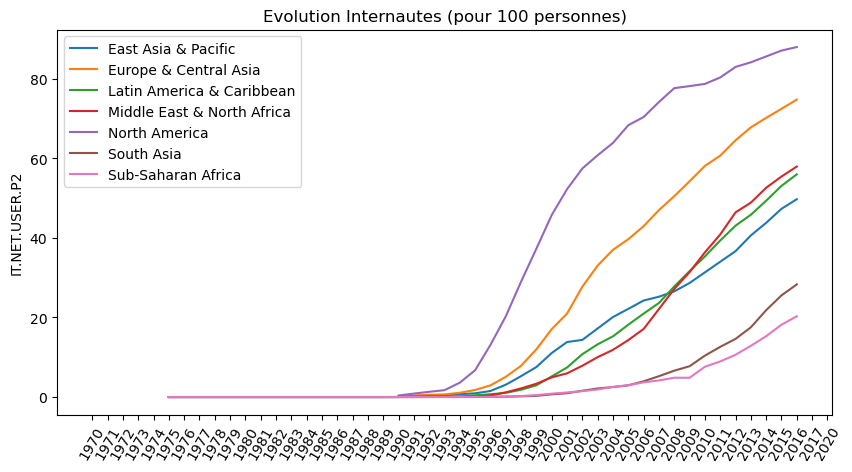

In [172]:
# Série temporelle
plt.figure(figsize=(10,5))
series_it = data_region_net.groupby("Region").mean()
for region in series_it.index :
    plt.plot(series_it.loc[region, :], label=region)
plt.xticks(rotation=60)
plt.title("Evolution Internautes (pour 100 personnes)")
plt.ylabel('IT.NET.USER.P2')
plt.legend()
plt.show()

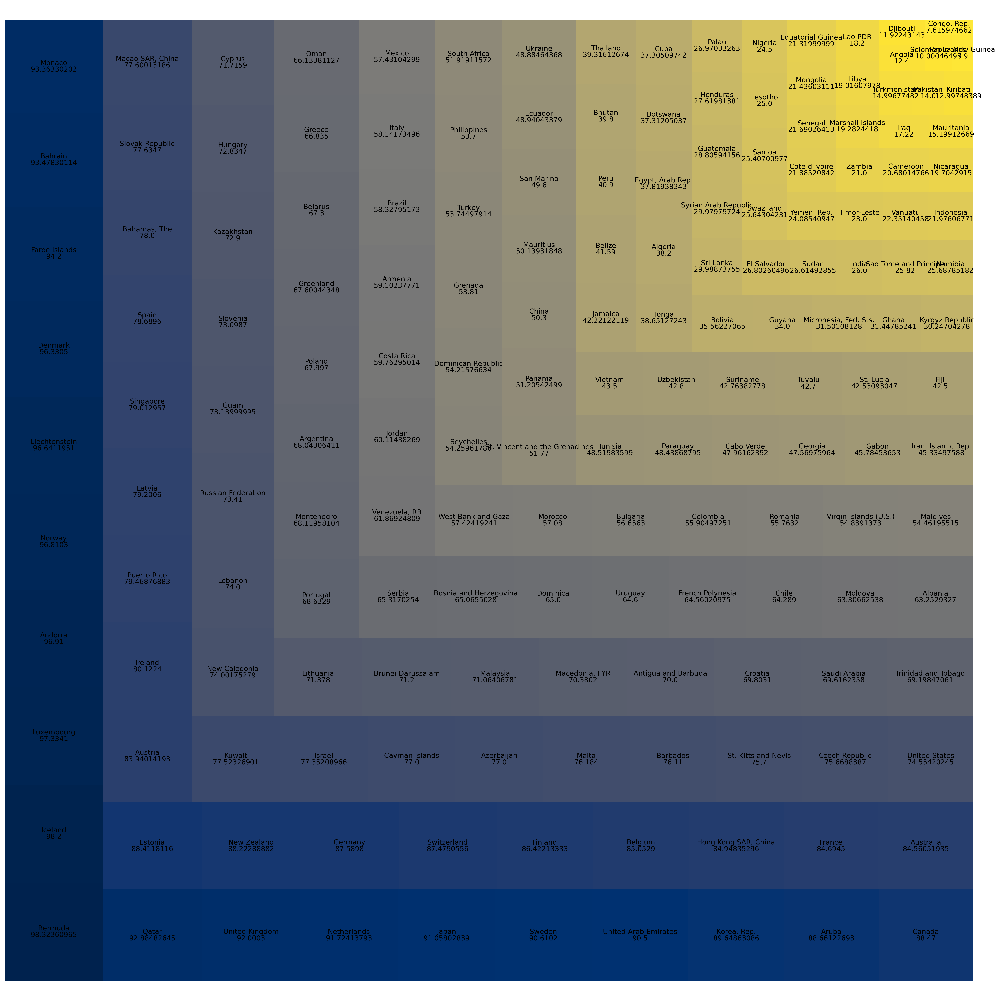

In [173]:
import squarify
import matplotlib.cm as cm

plt.figure(figsize=(25,25), dpi=300)

# Define the data for the treemap
data = df_it_net.Value
labels = df_it_net.Country_Name

# Create a color map based on the data values
data_unique = np.unique(labels)
colormap = cm.get_cmap('cividis', len(data_unique))
color = colormap(np.arange(len(data_unique)))
data_color = [color[i] for i in range(len(data))]

# Plot the treemap with sizes proportional to the values
squarify.plot(sizes=data, label=labels, color=data_color, value=data)

# Add a title to the treemap and set the font color to white
plt.gca().set_title("Title", fontdict={'fontsize': 20, 'fontweight': 'bold', 'color': 'white'})

# Show the plot
plt.axis('off')
plt.show()

In [174]:
print(f"data size: {len(data)}")
print(f"labels size: {len(labels)}")
print(f"data_color size: {len(data_color)}")

data size: 170
labels size: 170
data_color size: 170


**`IT.CMP.PCMP.P2`**

In [175]:
df_it_CMP = df_final_indic_notlow[df_final_indic_notlow['Indicator_Code'] == 'IT.CMP.PCMP.P2'].sort_values('Value', ascending = False)
print(df_it_CMP.shape)
print(f'Nan --> {df_it_CMP.isna().sum().sum()}')
df_it_CMP.head(3)

(159, 8)
Nan --> 0


,Country_Name,Country_Code,Indicator_Name,Indicator_Code,Value,Region,Income_Group,Indicator_Group
302284,Switzerland,CHE,Personal computers (per 100 people),IT.CMP.PCMP.P2,96.170657,Europe & Central Asia,High income: OECD,IT
64759,Canada,CAN,Personal computers (per 100 people),IT.CMP.PCMP.P2,94.446705,North America,High income: OECD,IT
229510,Netherlands,NLD,Personal computers (per 100 people),IT.CMP.PCMP.P2,90.987849,Europe & Central Asia,High income: OECD,IT


In [176]:
#Boxplot
fig_it_CMP_box =px.box(df_it_CMP, x='Region', y = 'Value', points='all')
fig_it_CMP_box.update_layout(
    title={"text": "Ordinateurs personnels (pour 100 personnes)", "font": {"size": 24}},
    xaxis_title="Region",
    yaxis_title="Valeur"
)

#Heatmap
fig_it_CMP_heat = px.density_heatmap(df_it_CMP, x='Region', y='Country_Name', z='Value',  color_continuous_scale='cividis')
fig_it_CMP_heat.update_layout(
    title=dict(
        text="Ordinateurs personnels (pour 100 personnes)",
        font=dict(
            family="Courier New, monospace",
            size=18,
            color="#7f7f7f"
        )
    )
)



fig_it_CMP_box.show()
fig_it_CMP_heat.show()

In [177]:
data_region_PCM_mask = data_region['Indicator Code'] == 'IT.CMP.PCMP.P2'
data_region_PCM = data_region[data_region_PCM_mask]
data_region_PCM.head(1)

,Country Name,Country Code,Indicator Name,Indicator Code,1970,1971,1972,1973,1974,1975,...,2060,2065,2070,2075,2080,2085,2090,2095,2100,Region
2084,Arab World,ARB,Personal computers (per 100 people),IT.CMP.PCMP.P2,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


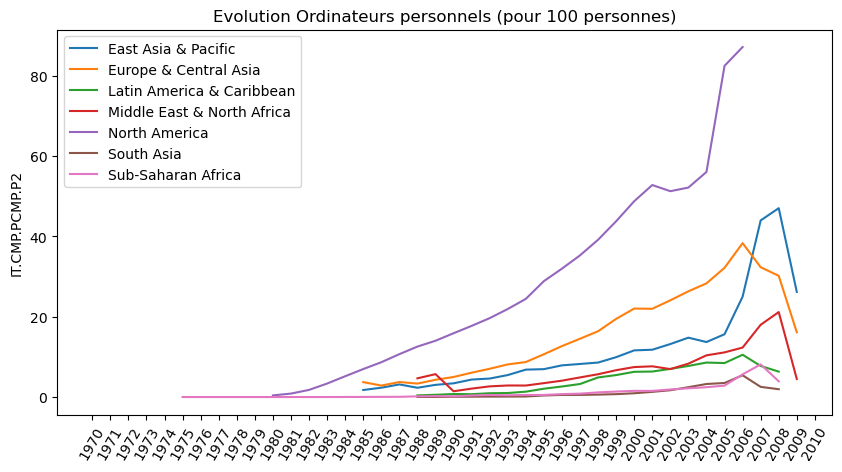

In [178]:
# Série temporelle
plt.figure(figsize=(10,5))
seriesPCMP = data_region_PCM.groupby("Region").mean()
for region in seriesPCMP.index :
    plt.plot(seriesPCMP.loc[region, :], label=region)
plt.xticks(rotation=60)
plt.title("Evolution Ordinateurs personnels (pour 100 personnes)")
plt.ylabel('IT.CMP.PCMP.P2')
plt.legend()
plt.show()

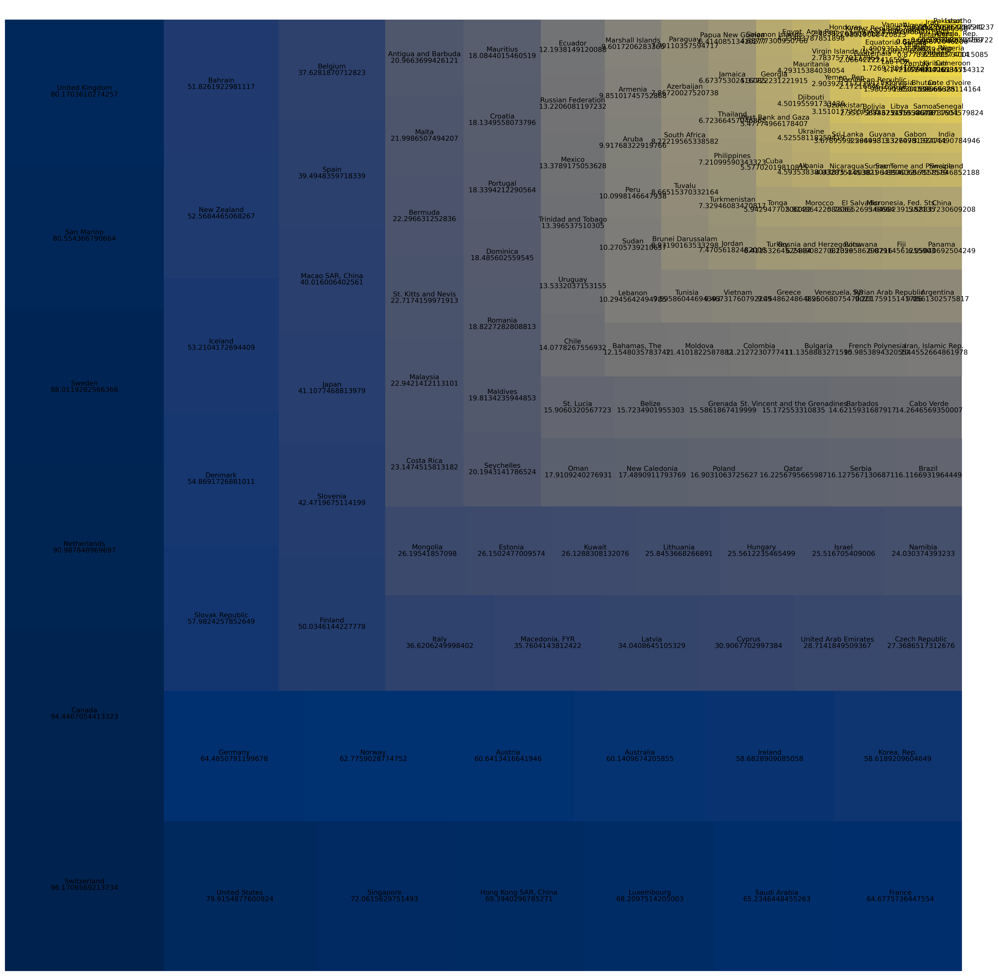

In [179]:
plt.figure(figsize=(25,25), dpi=300)
# Define the data for the treemap
data = df_it_CMP.Value
labels = df_it_CMP.Country_Name

# Create a color map based on the data values
data_unique = np.unique(labels)
colormap = cm.get_cmap('cividis', len(data_unique))
color = colormap(np.arange(len(data_unique)))
data_color = [color[i] for i in range(len(data))]

# Plot the treemap with sizes proportional to the values
squarify.plot(sizes=data, label=labels, color=data_color, value=data)

# Add a title to the treemap and set the font color to white
plt.gca().set_title("Title", fontdict={'fontsize': 20, 'fontweight': 'bold', 'color': 'white'})

# Show the plot
plt.axis('off')
plt.show()

<a id='11'></a>

### Indicateurs sur richesse des pays

[Haut de page](#sommaire)

**`NY.GDP.PCAP.CD`**


In [180]:
df_it_GBP = df_final_indic_notlow[df_final_indic_notlow['Indicator_Code'] == 'NY.GDP.PCAP.CD'].sort_values('Value', ascending = False)
print(df_it_GBP.shape)
print(f'Nan --> {df_it_GBP.isna().sum().sum()}')
df_it_GBP.head(3)

(176, 8)
Nan --> 0


,Country_Name,Country_Code,Indicator_Name,Indicator_Code,Value,Region,Income_Group,Indicator_Group
186420,Liechtenstein,LIE,GDP per capita (current US$),NY.GDP.PCAP.CD,168146.015281,Europe & Central Asia,High income: nonOECD,NY
215106,Monaco,MCO,GDP per capita (current US$),NY.GDP.PCAP.CD,162009.877819,Europe & Central Asia,High income: nonOECD,NY
189825,Luxembourg,LUX,GDP per capita (current US$),NY.GDP.PCAP.CD,101446.786303,Europe & Central Asia,High income: OECD,NY


In [181]:
#Boxplot
fig_GBP_box =px.box(df_it_GBP, x='Region', y = 'Value', points='all')
fig_GBP_box.update_layout(
    title={"text": "PIB par habitant (USD courants)", "font": {"size": 24}},
    xaxis_title="Region",
    yaxis_title="Valeur"
)

#Heatmap
fig_GBP_heat = px.density_heatmap(df_it_GBP, x='Region', y='Country_Name', z='Value',  color_continuous_scale='cividis')
fig_GBP_heat.update_layout(
    title=dict(
        text="PIB par habitant (USD courants)",
        font=dict(
            family="Courier New, monospace",
            size=18,
            color="#7f7f7f"
        )
    )
)



fig_GBP_box.show()
fig_GBP_heat.show()

In [182]:
data_region_GDP_mask = data_region['Indicator Code'] == 'NY.GDP.PCAP.CD'
data_region_GDP = data_region[data_region_GDP_mask]
data_region_GDP.head(1)

,Country Name,Country Code,Indicator Name,Indicator Code,1970,1971,1972,1973,1974,1975,...,2060,2065,2070,2075,2080,2085,2090,2095,2100,Region
1245,Arab World,ARB,GDP per capita (current US$),NY.GDP.PCAP.CD,250.488643,283.248047,328.69287,406.804635,758.562998,817.393647,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


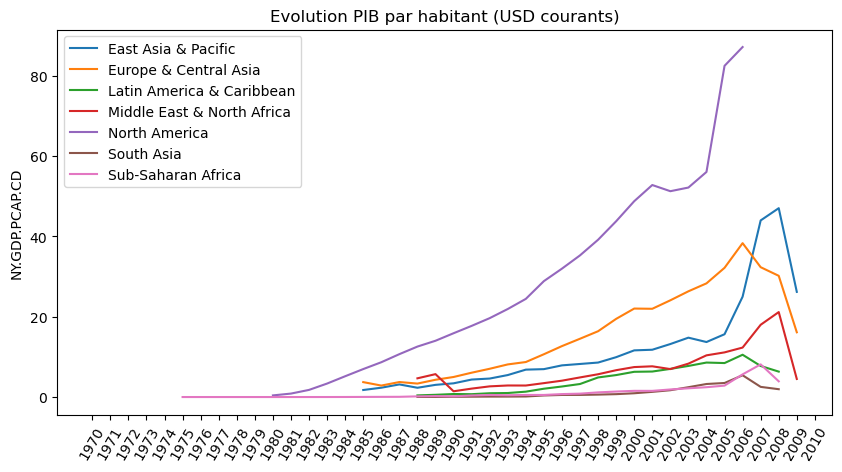

In [183]:
# Série temporelle
plt.figure(figsize=(10,5))
seriesGDP = data_region_GDP.groupby("Region").mean()
for region in seriesPCMP.index :
    plt.plot(seriesPCMP.loc[region, :], label=region)
plt.xticks(rotation=60)
plt.title("Evolution PIB par habitant (USD courants)")
plt.ylabel('NY.GDP.PCAP.CD')
plt.legend()
plt.show()

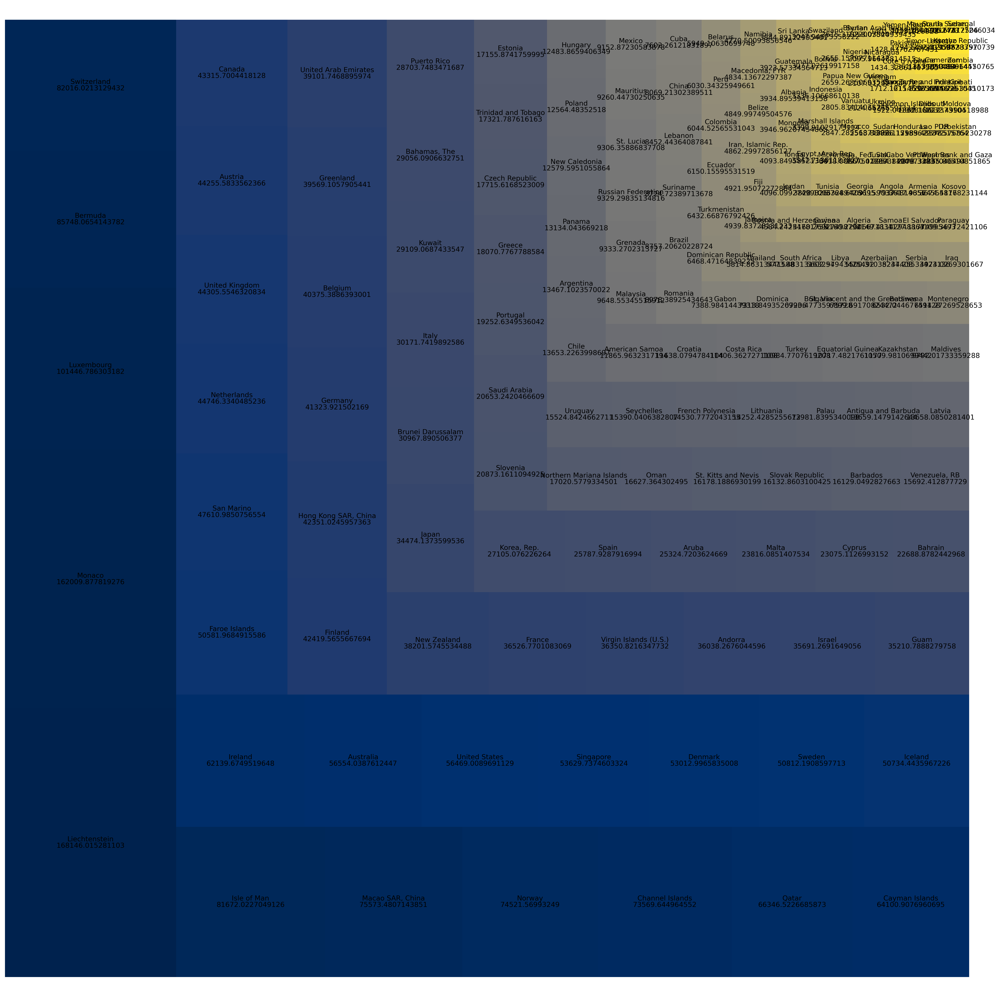

In [184]:
plt.figure(figsize=(25,25), dpi=300)

# Define the data for the treemap
data = df_it_GBP.Value
labels = df_it_GBP.Country_Name

# Create a color map based on the data values
data_unique = np.unique(labels)
colormap = cm.get_cmap('cividis', len(data_unique))
color = colormap(np.arange(len(data_unique)))
data_color = [color[i] for i in range(len(data))]

# Plot the treemap with sizes proportional to the values
squarify.plot(sizes=data, label=labels, color=data_color, value=data)

# Add a title to the treemap and set the font color to white
plt.gca().set_title("Title", fontdict={'fontsize': 20, 'fontweight': 'bold', 'color': 'white'})

# Show the plot
plt.axis('off')
plt.show()

<a id='13'></a>

### Indicateurs relatifs à l'éducation

[Haut de page](#sommaire)

**`SE.SEC.ENRL`**


In [185]:
df_SEC = df_final_indic_notlow[df_final_indic_notlow['Indicator_Code'] == 'SE.SEC.ENRL'].sort_values('Value', ascending = False)
print(df_SEC.shape)
print(f'Nan --> {df_SEC.isna().sum().sum()}')
df_SEC.head(3)

(164, 8)
Nan --> 0


,Country_Name,Country_Code,Indicator_Name,Indicator_Code,Value,Region,Income_Group,Indicator_Group
145778,India,IND,"Enrolment in secondary education, both sexes (...",SE.SEC.ENRL,129542056.0,South Asia,Lower middle income,SE
72633,China,CHN,"Enrolment in secondary education, both sexes (...",SE.SEC.ENRL,86127200.0,East Asia & Pacific,Upper middle income,SE
331764,United States,USA,"Enrolment in secondary education, both sexes (...",SE.SEC.ENRL,24229776.0,North America,High income: OECD,SE


In [186]:
#Boxplot
fig_CEC_box =px.box(df_SEC, x='Region', y = 'Value', points='all')
fig_CEC_box.update_layout(
    title={"text": "Inscription dans l'enseignement supérieur(Secondaire)", "font": {"size": 24}},
    xaxis_title="Region",
    yaxis_title="Valeur"
)

#Heatmap
fig_SEC_heat = px.density_heatmap(df_SEC, x='Region', y='Country_Name', z='Value',  color_continuous_scale='cividis')
fig_SEC_heat.update_layout(
    title=dict(
        text="Inscription dans l'enseignement supérieur(Secondaire)",
        font=dict(
            family="Courier New, monospace",
            size=18,
            color="#7f7f7f"
        )
    )
)



fig_CEC_box.show()
fig_SEC_heat.show()

In [187]:
data_region_SEC_mask = data_region['Indicator Code'] == 'SE.SEC.ENRL'
data_region_SEC = data_region[data_region_SEC_mask]
data_region_SEC.head(1)

,Country Name,Country Code,Indicator Name,Indicator Code,1970,1971,1972,1973,1974,1975,...,2060,2065,2070,2075,2080,2085,2090,2095,2100,Region
1191,Arab World,ARB,"Enrolment in secondary education, both sexes (...",SE.SEC.ENRL,4842861.5,4981843.5,5270417.5,5593058.5,5938865.5,6437610.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


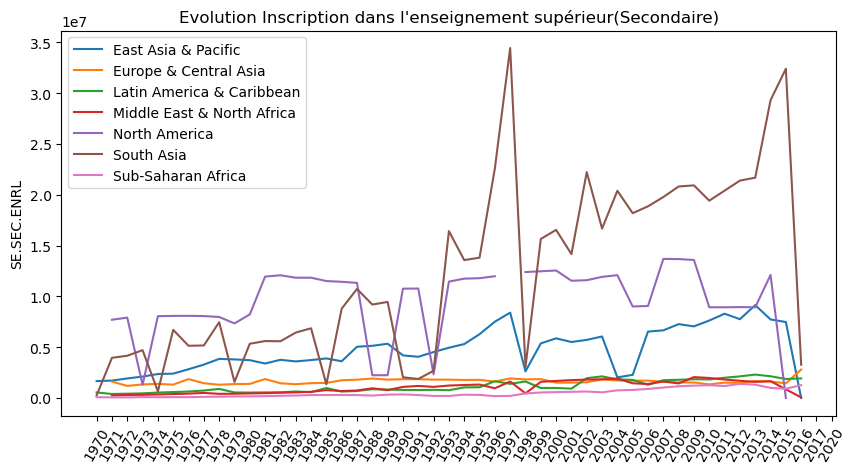

In [188]:
# Série temporelle
plt.figure(figsize=(10,5))
seriesSEC = data_region_SEC.groupby("Region").mean()
for region in seriesSEC.index :
    plt.plot(seriesSEC.loc[region, :], label=region)
plt.xticks(rotation=60)
plt.title("Evolution Inscription dans l'enseignement supérieur(Secondaire)")
plt.ylabel('SE.SEC.ENRL')
plt.legend()
plt.show()

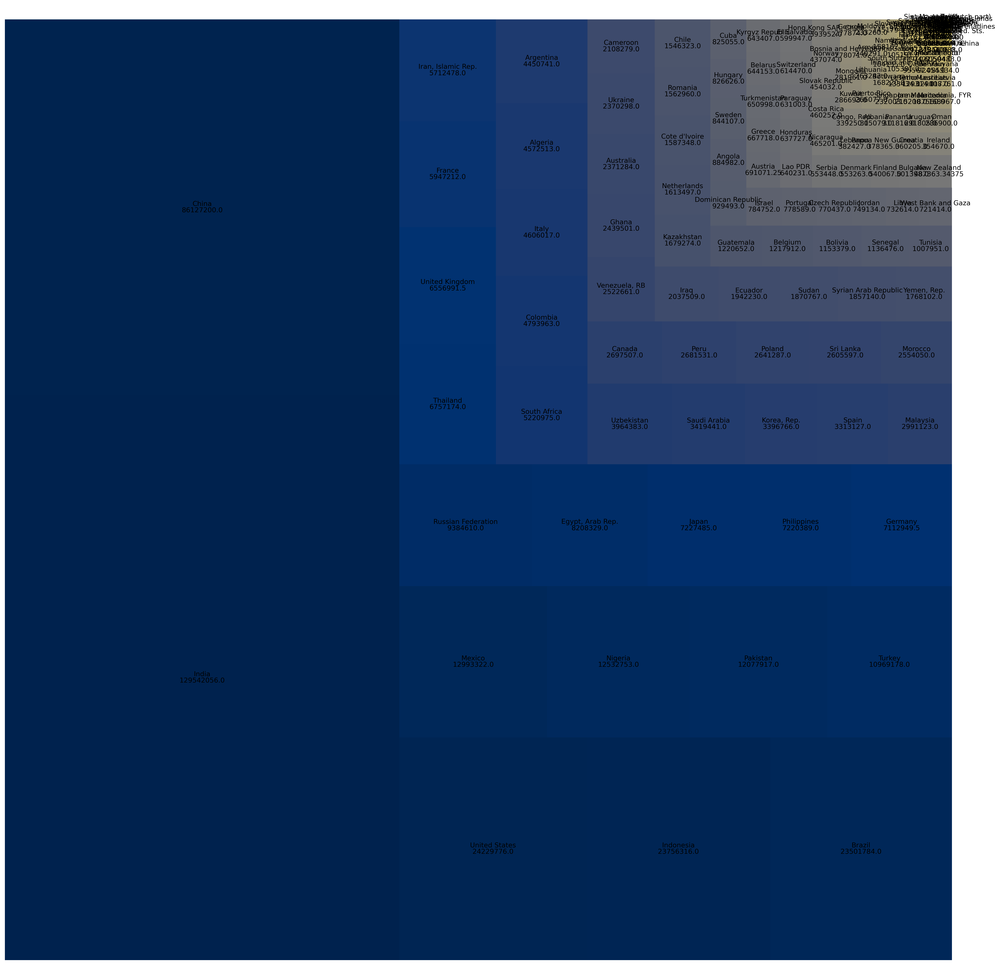

In [189]:
plt.figure(figsize=(25,25), dpi=300)
# Define the data for the treemap
data = df_SEC.Value
labels = df_SEC.Country_Name

# Create a color map based on the data values
data_unique = np.unique(labels)
colormap = cm.get_cmap('cividis', len(data_unique))
color = colormap(np.arange(len(data_unique)))
data_color = [color[i] for i in range(len(data))]

# Plot the treemap with sizes proportional to the values
squarify.plot(sizes=data, label=labels, color=data_color, value=data)

# Add a title to the treemap and set the font color to white
plt.gca().set_title("Title", fontdict={'fontsize': 20, 'fontweight': 'bold', 'color': 'white'})

# Show the plot
plt.axis('off')
plt.show()

**`SE.TER.ENRL`**

In [190]:
df_TER = df_final_indic_notlow[df_final_indic_notlow['Indicator_Code'] == 'SE.TER.ENRL'].sort_values('Value', ascending = False)
print(df_TER.shape)
print(f'Nan --> {df_TER.isna().sum().sum()}')
df_TER.head(3)

(161, 8)
Nan --> 0


,Country_Name,Country_Code,Indicator_Name,Indicator_Code,Value,Region,Income_Group,Indicator_Group
72646,China,CHN,"Enrolment in tertiary education, all programme...",SE.TER.ENRL,43367392.0,East Asia & Pacific,Upper middle income,SE
145791,India,IND,"Enrolment in tertiary education, all programme...",SE.TER.ENRL,32107420.0,South Asia,Lower middle income,SE
331775,United States,USA,"Enrolment in tertiary education, all programme...",SE.TER.ENRL,19531728.0,North America,High income: OECD,SE


In [191]:
#Boxplot
fig_TER_box =px.box(df_TER, x='Region', y = 'Value', points='all')
fig_TER_box.update_layout(
    title={"text": "Inscription dans l'enseignement supérieur(Tertiaire)", "font": {"size": 24}},
    xaxis_title="Region",
    yaxis_title="Valeur"
)

#Heatmap
fig_TER_heat = px.density_heatmap(df_TER, x='Region', y='Country_Name', z='Value',  color_continuous_scale='cividis')
fig_TER_heat.update_layout(
    title=dict(
        text="Inscription dans l'enseignement supérieur(Tertiaire)",
        font=dict(
            family="Courier New, monospace",
            size=18,
            color="#7f7f7f"
        )
    )
)



fig_TER_box.show()
fig_TER_heat.show()

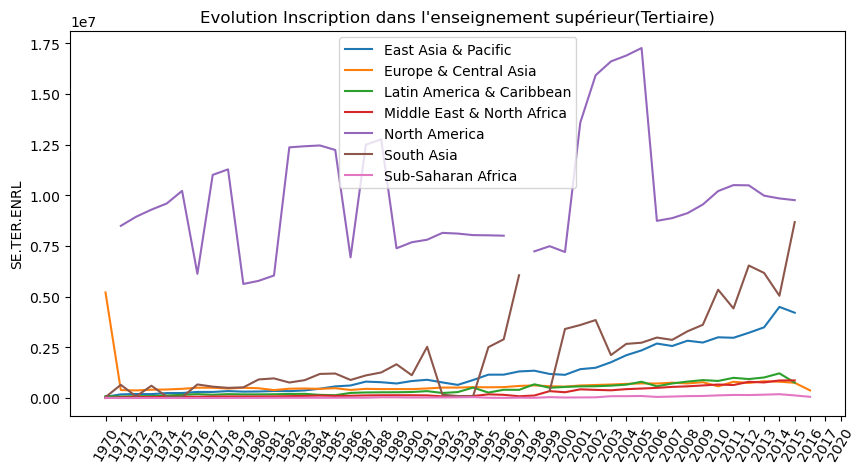

In [192]:
data_region_TER_mask = data_region['Indicator Code'] == 'SE.TER.ENRL'
data_region_TER = data_region[data_region_TER_mask]
#data_region_TER.head(1)

# Série temporelle
plt.figure(figsize=(10,5))
seriesTER = data_region_TER.groupby("Region").mean()
for region in seriesTER.index :
    plt.plot(seriesTER.loc[region, :], label=region)
plt.xticks(rotation=60)
plt.title("Evolution Inscription dans l'enseignement supérieur(Tertiaire)")
plt.ylabel('SE.TER.ENRL')
plt.legend()
plt.show()

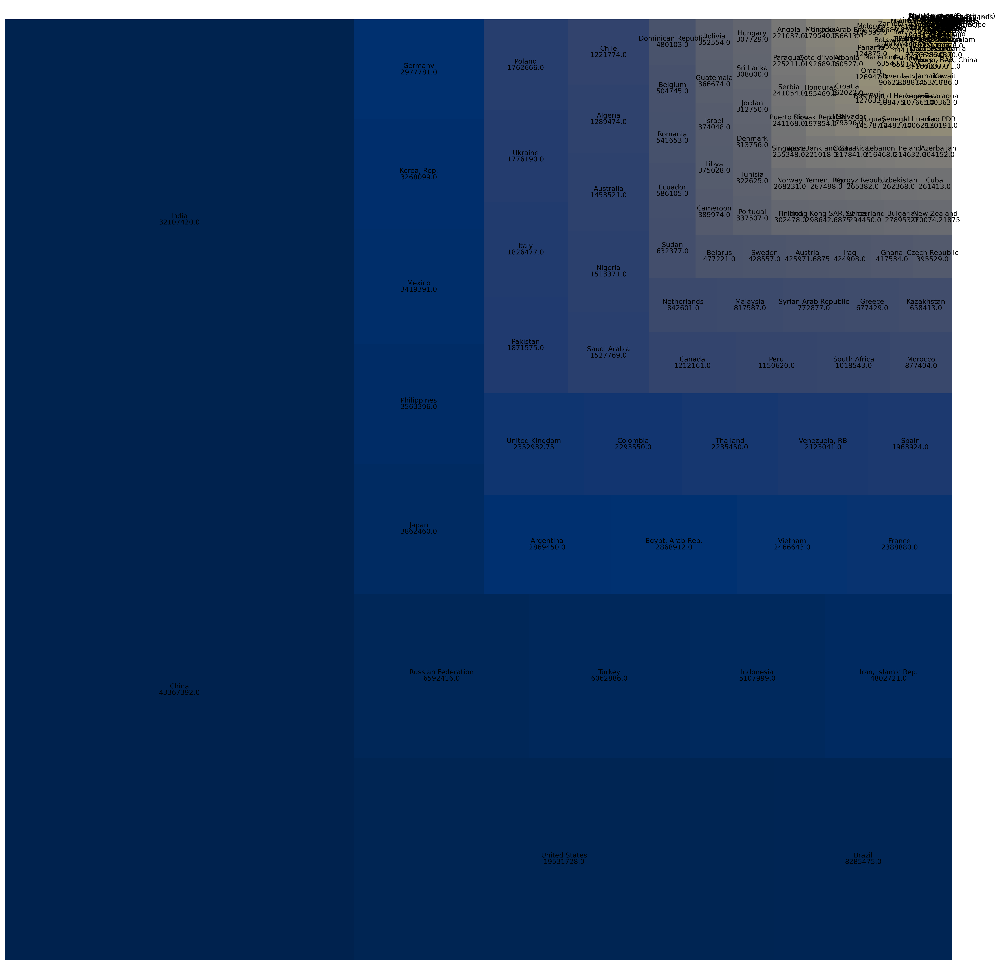

In [193]:
plt.figure(figsize=(25,25), dpi=300)

# Define the data for the treemap
data = df_TER.Value
labels = df_TER.Country_Name

# Create a color map based on the data values
data_unique = np.unique(labels)
colormap = cm.get_cmap('cividis', len(data_unique))
color = colormap(np.arange(len(data_unique)))
data_color = [color[i] for i in range(len(data))]

# Plot the treemap with sizes proportional to the values
squarify.plot(sizes=data, label=labels, color=data_color, value=data)

# Add a title to the treemap and set the font color to white
plt.gca().set_title("Title", fontdict={'fontsize': 20, 'fontweight': 'bold', 'color': 'white'})

# Show the plot
plt.axis('off')
plt.show()

**`SP.SEC.TOTL.IN`**

In [194]:
df_SEC_totl = df_final_indic_notlow[df_final_indic_notlow['Indicator_Code'] == 'SP.SEC.TOTL.IN'].sort_values('Value', ascending = False)
print(df_SEC_totl.shape)
print(f'Nan --> {df_SEC_totl.isna().sum().sum()}')
df_SEC_totl.head(3)

(161, 8)
Nan --> 0


,Country_Name,Country_Code,Indicator_Name,Indicator_Code,Value,Region,Income_Group,Indicator_Group
146197,India,IND,Population of the official age for secondary e...,SP.SEC.TOTL.IN,175129728.0,South Asia,Lower middle income,SP
73014,China,CHN,Population of the official age for secondary e...,SP.SEC.TOTL.IN,91333960.0,East Asia & Pacific,Upper middle income,SP
148265,Indonesia,IDN,Population of the official age for secondary e...,SP.SEC.TOTL.IN,27674442.0,East Asia & Pacific,Lower middle income,SP


In [195]:
#Boxplot
fig_CEC_totl_box =px.box(df_SEC_totl, x='Region', y = 'Value', points='all')
fig_CEC_totl_box.update_layout(
    title={"text": "Population d'âge officiel pour l'enseignement supérieur(Secondaire)", "font": {"size": 24}},
    xaxis_title="Region",
    yaxis_title="Valeur"
)

#Heatmap
fig_SEC_totl_heat = px.density_heatmap(df_SEC_totl, x='Region', y='Country_Name', z='Value',  color_continuous_scale='cividis')
fig_SEC_totl_heat.update_layout(
    title=dict(
        text="Population d'âge officiel pour l'enseignement supérieur(Secondaire)",
        font=dict(
            family="Courier New, monospace",
            size=18,
            color="#7f7f7f"
        )
    )
)



fig_CEC_totl_box.show()
fig_SEC_totl_heat.show()

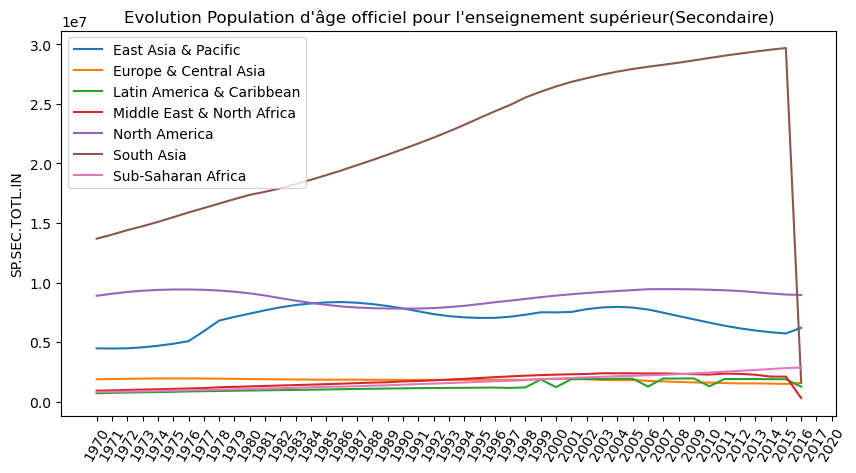

In [196]:
data_region_SECTOTL_mask = data_region['Indicator Code'] == 'SP.SEC.TOTL.IN'
data_region_SECTOTL = data_region[data_region_SECTOTL_mask]
#data_region_SECTOTL.head(1)

# Série temporelle
plt.figure(figsize=(10,5))
seriesSECTOTL = data_region_SECTOTL.groupby("Region").mean()
for region in seriesSECTOTL.index :
    plt.plot(seriesSECTOTL.loc[region, :], label=region)
plt.xticks(rotation=60)
plt.title("Evolution Population d'âge officiel pour l'enseignement supérieur(Secondaire)")
plt.ylabel('SP.SEC.TOTL.IN')
plt.legend()
plt.show()

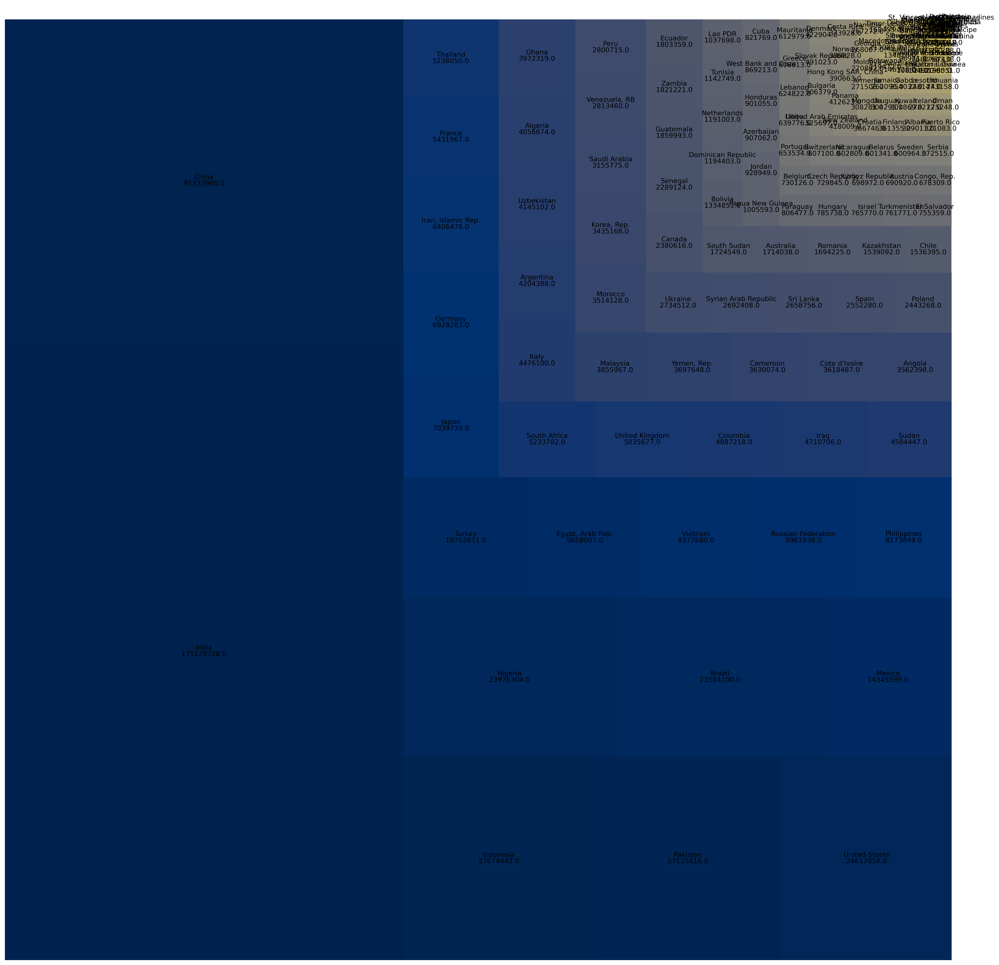

In [197]:
plt.figure(figsize=(25,25), dpi=300)
# Define the data for the treemap
data = df_SEC_totl.Value
labels = df_SEC_totl.Country_Name

# Create a color map based on the data values
data_unique = np.unique(labels)
colormap = cm.get_cmap('cividis', len(data_unique))
color = colormap(np.arange(len(data_unique)))
data_color = [color[i] for i in range(len(data))]

# Plot the treemap with sizes proportional to the values
squarify.plot(sizes=data, label=labels, color=data_color, value=data)

# Add a title to the treemap and set the font color to white
plt.gca().set_title("Title", fontdict={'fontsize': 20, 'fontweight': 'bold', 'color': 'white'})

# Show the plot
plt.axis('off')
plt.show()

**`SP.TER.TOTL.IN`**


In [198]:
df_TER_totl = df_final_indic_notlow[df_final_indic_notlow['Indicator_Code'] == 'SP.TER.TOTL.IN'].sort_values('Value', ascending = False)
print(df_TER_totl.shape)
print(f'Nan --> {df_TER_totl.isna().sum().sum()}')
df_TER_totl.head(3)

(162, 8)
Nan --> 0


,Country_Name,Country_Code,Indicator_Name,Indicator_Code,Value,Region,Income_Group,Indicator_Group
146200,India,IND,Population of the official age for tertiary ed...,SP.TER.TOTL.IN,119469984.0,South Asia,Lower middle income,SP
73017,China,CHN,Population of the official age for tertiary ed...,SP.TER.TOTL.IN,99943816.0,East Asia & Pacific,Upper middle income,SP
332360,United States,USA,Population of the official age for tertiary ed...,SP.TER.TOTL.IN,22765372.0,North America,High income: OECD,SP


In [199]:
#Boxplot
fig_TER_totl_box =px.box(df_TER_totl, x='Region', y = 'Value', points='all')
fig_TER_totl_box.update_layout(
    title={"text": "Population d'âge officiel pour l'enseignement supérieur(Tertiaire)", "font": {"size": 24}},
    xaxis_title="Region",
    yaxis_title="Valeur"
)

#Heatmap
fig_TER_totl_heat = px.density_heatmap(df_TER_totl, x='Region', y='Country_Name', z='Value',  color_continuous_scale='cividis')
fig_TER_totl_heat.update_layout(
    title=dict(
        text="Population d'âge officiel pour l'enseignement supérieur(Tertiaire)",
        font=dict(
            family="Courier New, monospace",
            size=18,
            color="#7f7f7f"
        )
    )
)



fig_TER_totl_box.show()
fig_TER_totl_heat.show()

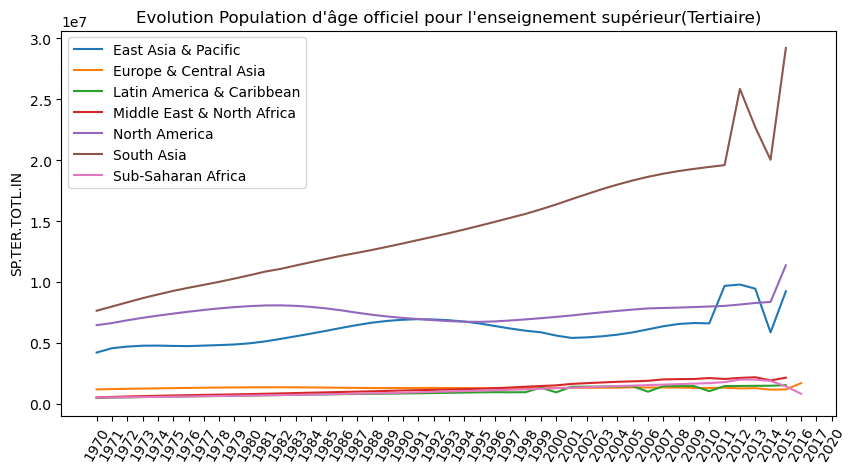

In [200]:
data_region_TERTOTL_mask = data_region['Indicator Code'] == 'SP.TER.TOTL.IN'
data_region_TERTOTL = data_region[data_region_TERTOTL_mask]
#data_region_TERTOTL.head(1)

# Série temporelle
plt.figure(figsize=(10,5))
seriesTERTOTL = data_region_TERTOTL.groupby("Region").mean()
for region in seriesTERTOTL.index :
    plt.plot(seriesTERTOTL.loc[region, :], label=region)
plt.xticks(rotation=60)
plt.title("Evolution Population d'âge officiel pour l'enseignement supérieur(Tertiaire)")
plt.ylabel('SP.TER.TOTL.IN')
plt.legend()
plt.show()

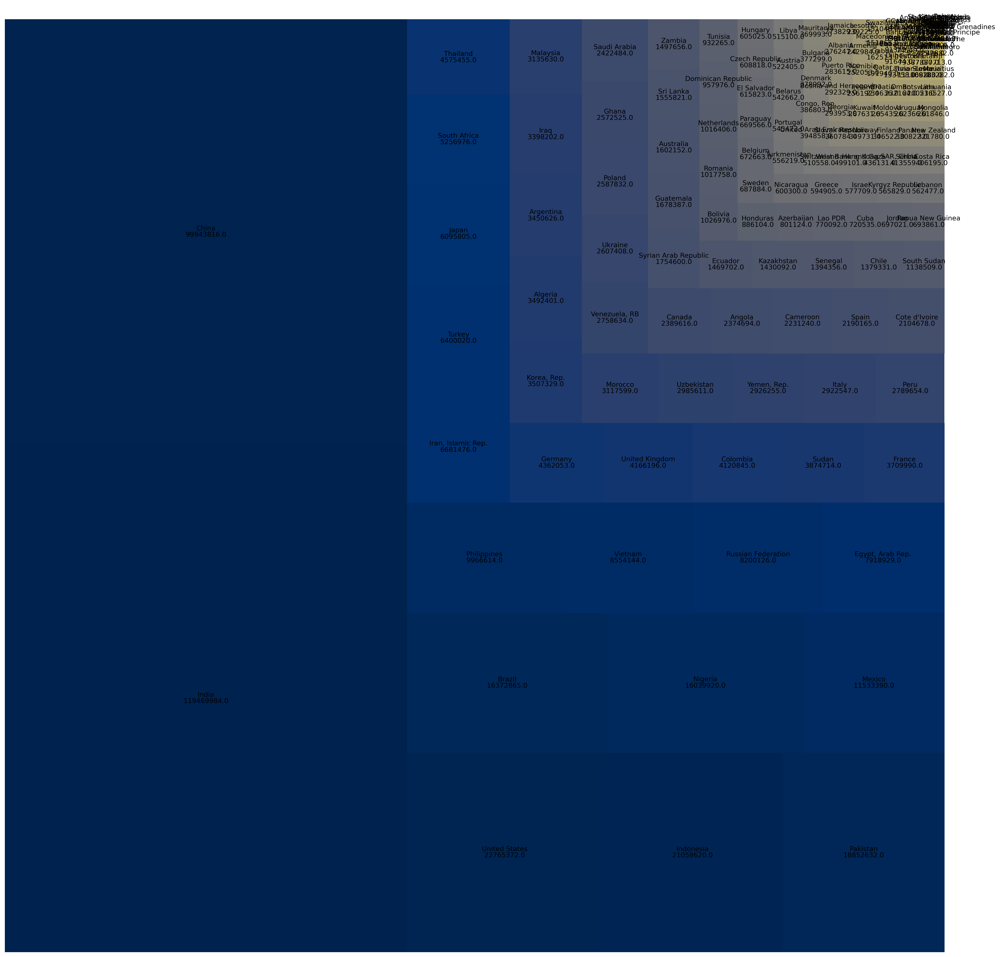

In [201]:
plt.figure(figsize=(25,25), dpi=300)
# Define the data for the treemap
data = df_TER_totl.Value
labels = df_TER_totl.Country_Name

# Create a color map based on the data values
data_unique = np.unique(labels)
colormap = cm.get_cmap('cividis', len(data_unique))
color = colormap(np.arange(len(data_unique)))
data_color = [color[i] for i in range(len(data))]

# Plot the treemap with sizes proportional to the values
squarify.plot(sizes=data, label=labels, color=data_color, value=data)

# Add a title to the treemap and set the font color to white
plt.gca().set_title("Title", fontdict={'fontsize': 20, 'fontweight': 'bold', 'color': 'white'})

# Show the plot
plt.axis('off')
plt.show()

### Créer le DataFrame des indicateurs

In [202]:
#Créer le pivot table de pays et indicateurs
pays_indicateurs = df_final_indic_notlow.pivot_table(index='Country_Name', columns='Indicator_Code', 
                                      values='Value', aggfunc='mean')
print(f'shape -->{pays_indicateurs.shape}')
print(f'Nan --> {pays_indicateurs.isna().sum().sum()}')
pays_indicateurs.head(3)

shape -->(179, 7)
Nan --> 100


Indicator_Code,IT.CMP.PCMP.P2,IT.NET.USER.P2,NY.GDP.PCAP.CD,SE.SEC.ENRL,SE.TER.ENRL,SP.SEC.TOTL.IN,SP.TER.TOTL.IN
Country_Name,,,,,,,
Albania,4.593538,63.252933,3934.895394,315079.0,160527.0,329011.0,276247.0
Algeria,1.030597,38.200000,4160.220067,4572513.0,1289474.0,4056674.0,3492401.0
American Samoa,NaN,NaN,11865.963232,NaN,1607.0,NaN,NaN


<a id='8'></a>

In [203]:
pays_indicateurs.isnull().sum()

Indicator_Code
IT.CMP.PCMP.P2    20
IT.NET.USER.P2     9
NY.GDP.PCAP.CD     3
SE.SEC.ENRL       15
SE.TER.ENRL       18
SP.SEC.TOTL.IN    18
SP.TER.TOTL.IN    17
dtype: int64

### Remplir les valeurs manquantes

[Haut de page](#sommaire)

In [204]:
from sklearn.impute import KNNImputer

imputer = KNNImputer(n_neighbors=2)
pays_indicateurs_rempli = imputer.fit_transform(pays_indicateurs)
pays_indicateurs_rempli

array([[4.59353838e+00, 6.32529327e+01, 3.93489539e+03, ...,
        1.60527000e+05, 3.29011000e+05, 2.76247000e+05],
       [1.03059686e+00, 3.82000000e+01, 4.16022007e+03, ...,
        1.28947400e+06, 4.05667400e+06, 3.49240100e+06],
       [9.49001315e+00, 4.76608764e+01, 1.18659632e+04, ...,
        1.60700000e+03, 5.68435000e+04, 4.27225000e+04],
       ...,
       [5.47774966e+00, 5.74241924e+01, 2.86580511e+03, ...,
        2.21018000e+05, 8.69213000e+05, 4.99101000e+05],
       [2.90392172e+00, 2.40854095e+01, 1.40190332e+03, ...,
        2.67498000e+05, 3.69764800e+06, 2.92625500e+06],
       [1.14210766e+00, 2.10000000e+01, 1.31388965e+03, ...,
        5.66800000e+04, 1.82122100e+06, 1.49765600e+06]])

In [205]:
pays_indicateurs_rempli = pd.DataFrame(pays_indicateurs_rempli, index = pays_indicateurs.index, columns = pays_indicateurs.columns)
pays_indicateurs_rempli.head(3)

Indicator_Code,IT.CMP.PCMP.P2,IT.NET.USER.P2,NY.GDP.PCAP.CD,SE.SEC.ENRL,SE.TER.ENRL,SP.SEC.TOTL.IN,SP.TER.TOTL.IN
Country_Name,,,,,,,
Albania,4.593538,63.252933,3934.895394,315079.0,160527.0,329011.0,276247.0
Algeria,1.030597,38.200000,4160.220067,4572513.0,1289474.0,4056674.0,3492401.0
American Samoa,9.490013,47.660876,11865.963232,18381.5,1607.0,56843.5,42722.5


In [206]:
print(f'shape -->{pays_indicateurs_rempli.shape}')
print(f'Nan --> {pays_indicateurs_rempli.isna().sum().sum()}')
pays_indicateurs_rempli.head(3)

shape -->(179, 7)
Nan --> 0


Indicator_Code,IT.CMP.PCMP.P2,IT.NET.USER.P2,NY.GDP.PCAP.CD,SE.SEC.ENRL,SE.TER.ENRL,SP.SEC.TOTL.IN,SP.TER.TOTL.IN
Country_Name,,,,,,,
Albania,4.593538,63.252933,3934.895394,315079.0,160527.0,329011.0,276247.0
Algeria,1.030597,38.200000,4160.220067,4572513.0,1289474.0,4056674.0,3492401.0
American Samoa,9.490013,47.660876,11865.963232,18381.5,1607.0,56843.5,42722.5


In [207]:
pays_indicateurs_rempli.describe()

Indicator_Code,IT.CMP.PCMP.P2,IT.NET.USER.P2,NY.GDP.PCAP.CD,SE.SEC.ENRL,SE.TER.ENRL,SP.SEC.TOTL.IN,SP.TER.TOTL.IN
count,179.000000,179.000000,179.000000,1.790000e+02,1.790000e+02,1.790000e+02,1.790000e+02
mean,21.244021,56.518650,19750.453351,2.987788e+06,1.175557e+06,3.610778e+06,2.925700e+06
std,22.923684,24.731751,26393.393251,1.201737e+07,4.369946e+06,1.521813e+07,1.196742e+07
min,0.259626,7.615975,910.774777,1.289000e+03,1.940000e+02,1.403000e+03,1.042000e+03
25%,5.427486,37.565717,3730.217330,6.736550e+04,1.262750e+04,8.878800e+04,7.863350e+04
50%,12.154804,57.431043,9152.872306,4.370740e+05,1.926890e+05,5.256970e+05,3.948580e+05
75%,26.782035,76.147000,26446.502509,1.812621e+06,5.638790e+05,2.411942e+06,1.716494e+06
max,96.170657,98.323610,168146.015281,1.295421e+08,4.336739e+07,1.751297e+08,1.194700e+08


### Verification Corrélation

[Haut de page](#sommaire)

C:\Users\pouri\AppData\Local\Temp\ipykernel_30816\234756244.py:2: DeprecationWarning:

`np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



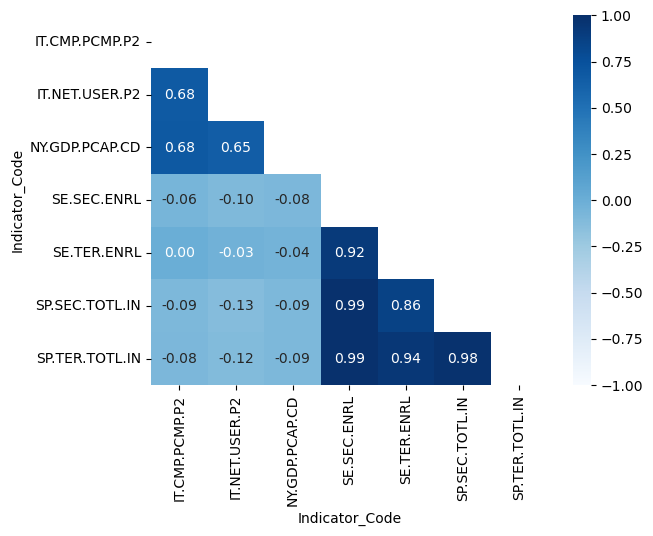

In [208]:
corr = pays_indicateurs_rempli.corr()
mask = np.triu(np.ones_like(corr, dtype=np.bool))
sns.heatmap(corr, annot=True, mask=mask, fmt=".2f", cmap='Blues', vmin = -1 , vmax = 1) 
plt.show()

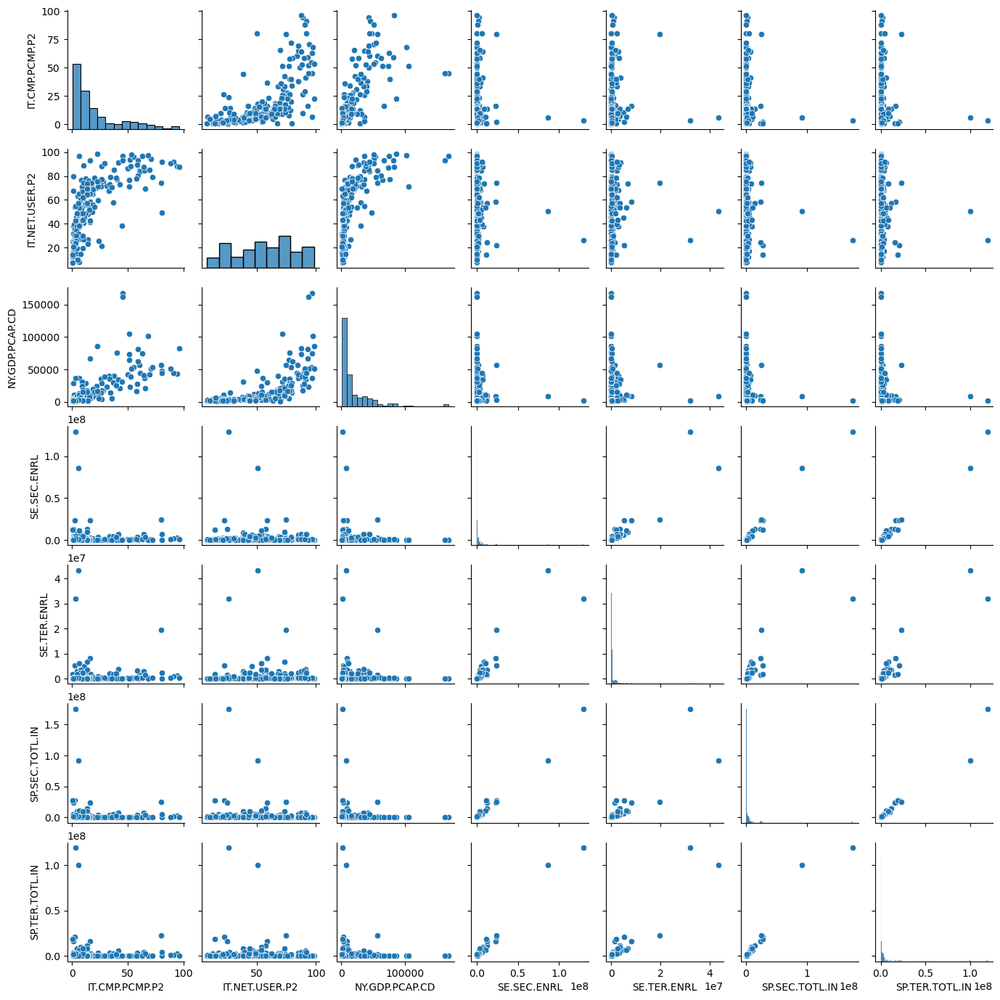

In [209]:
sns.pairplot(pays_indicateurs_rempli, height=2)
plt.show()

<a id='p4'></a>

## Décisions d'ouverture vers de nouveaux pays

<a id='14'></a> 

### Fonctionnement d'addition aux valeurs standardisées des indicateurs de chaque pays.

In [210]:
# Initialiser le MinMaxScaler
scaler = MinMaxScaler()

# Ajuster le MinMaxScaler aux données
scaler.fit(pays_indicateurs_rempli)

# Transformer les données à l'aide du MinMaxScaler
scaled_data = scaler.transform(pays_indicateurs_rempli)

# Les données sont maintenant normalisées à une plage spécifiée entre 0 et 1
print(scaled_data)

[[4.51867937e-02 6.13365766e-01 1.80830345e-02 ... 3.69710305e-03
  1.87067398e-03 2.30356941e-03]
 [8.03839170e-03 3.37171456e-01 1.94303861e-02 ... 2.97293821e-02
  2.31559972e-02 2.92239886e-02]
 [9.62390527e-02 4.41472228e-01 6.55076551e-02 ... 3.25822295e-05
  3.16570720e-04 3.48881469e-04]
 ...
 [5.44058718e-02 5.49107225e-01 1.16903012e-02 ... 5.09195913e-03
  4.95528065e-03 4.16894125e-03]
 [2.75702938e-02 1.81566136e-01 2.93675269e-03 ... 6.16373693e-03
  2.11059233e-02 2.44851336e-02]
 [9.20104005e-03 1.47551255e-01 2.41046604e-03 ... 1.30250518e-03
  1.03913402e-02 1.25272223e-02]]


In [211]:
pays_indicateurs_rempli_scale = pd.DataFrame(scaled_data, index = pays_indicateurs_rempli.index, 
                                             columns = pays_indicateurs_rempli.columns )

pays_indicateurs_rempli_scale.head()

Indicator_Code,IT.CMP.PCMP.P2,IT.NET.USER.P2,NY.GDP.PCAP.CD,SE.SEC.ENRL,SE.TER.ENRL,SP.SEC.TOTL.IN,SP.TER.TOTL.IN
Country_Name,,,,,,,
Albania,0.045187,0.613366,0.018083,0.002422,0.003697,0.001871,0.002304
Algeria,0.008038,0.337171,0.019430,0.035288,0.029729,0.023156,0.029224
American Samoa,0.096239,0.441472,0.065508,0.000132,0.000033,0.000317,0.000349
Andorra,0.063508,0.984416,0.210048,0.000024,0.000007,0.000048,0.000069
Angola,0.004029,0.052741,0.016653,0.006822,0.005092,0.020334,0.019868


In [212]:
pays_indicateurs_rempli_scale_direct = pays_indicateurs_rempli_scale.copy()
pays_indicateurs_rempli_scale_direct['potentiel'] = np.sum(pays_indicateurs_rempli_scale_direct,axis=1)
pays_indicateurs_rempli_scale_direct.head()

Indicator_Code,IT.CMP.PCMP.P2,IT.NET.USER.P2,NY.GDP.PCAP.CD,SE.SEC.ENRL,SE.TER.ENRL,SP.SEC.TOTL.IN,SP.TER.TOTL.IN,potentiel
Country_Name,,,,,,,,
Albania,0.045187,0.613366,0.018083,0.002422,0.003697,0.001871,0.002304,0.686929
Algeria,0.008038,0.337171,0.019430,0.035288,0.029729,0.023156,0.029224,0.482038
American Samoa,0.096239,0.441472,0.065508,0.000132,0.000033,0.000317,0.000349,0.604049
Andorra,0.063508,0.984416,0.210048,0.000024,0.000007,0.000048,0.000069,1.258120
Angola,0.004029,0.052741,0.016653,0.006822,0.005092,0.020334,0.019868,0.125539


In [213]:
pays_indicateurs_rempli_scale_direct['Rank'] = pays_indicateurs_rempli_scale_direct['potentiel'].rank(ascending=False)
pays_indicateurs_rempli_scale_direct

Indicator_Code,IT.CMP.PCMP.P2,IT.NET.USER.P2,NY.GDP.PCAP.CD,SE.SEC.ENRL,SE.TER.ENRL,SP.SEC.TOTL.IN,SP.TER.TOTL.IN,potentiel,Rank
Country_Name,,,,,,,,,
Albania,0.045187,0.613366,0.018083,0.002422,0.003697,0.001871,0.002304,0.686929,110.0
Algeria,0.008038,0.337171,0.019430,0.035288,0.029729,0.023156,0.029224,0.482038,133.0
American Samoa,0.096239,0.441472,0.065508,0.000132,0.000033,0.000317,0.000349,0.604049,120.0
Andorra,0.063508,0.984416,0.210048,0.000024,0.000007,0.000048,0.000069,1.258120,46.0
Angola,0.004029,0.052741,0.016653,0.006822,0.005092,0.020334,0.019868,0.125539,174.0
...,...,...,...,...,...,...,...,...,...
Vietnam,0.096002,0.395601,0.007153,0.031685,0.056874,0.053539,0.071593,0.712447,104.0
Virgin Islands (U.S.),0.026317,0.520608,0.211917,0.000050,0.000053,0.000120,0.000176,0.759242,97.0
West Bank and Gaza,0.054406,0.549107,0.011690,0.005559,0.005092,0.004955,0.004169,0.634979,115.0


In [214]:
pays_indicateurs_rempli_scale_direct[['potentiel', 'Rank']].nlargest(30, 'potentiel')

Indicator_Code,potentiel,Rank
Country_Name,,
India,3.977706,1.0
China,3.591863,2.0
United States,2.869203,3.0
Liechtenstein,2.450617,4.0
Switzerland,2.384664,5.0
Monaco,2.377839,6.0
Luxembourg,2.299747,7.0
Canada,2.209299,8.0
United Kingdom,2.191417,9.0


In [215]:
list_near_far = ['Switzerland',  'Netherlands',  'Sweden',  'Faroe Islands',  'Germany',  'Spain',  'United Kingdom',
                 'United States',  'Canada',  'Australia',  'Singapore', 'China', 'Japan', 'India']
#data_top.loc[list_near, :]
data_top_index = data_top.set_index('Country Name')
data_top_index_near = data_top_index.loc[list_near_far, :]

In [216]:
data_top_index_near.drop(['Country Code', 'Indicator Name', 'Unnamed: 69'], axis = 1, inplace = True)
data_top_index_near.head(1)

,Indicator Code,1970,1971,1972,1973,1974,1975,1976,1977,1978,...,2055,2060,2065,2070,2075,2080,2085,2090,2095,2100
Country Name,,,,,,,,,,,,,,,,,,,,,
Switzerland,UIS.NERA.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


#### Visualisation pour les top pays

In [217]:
m_cmp = data_top_index_near['Indicator Code'] == 'IT.CMP.PCMP.P2'
m_net = data_top_index_near['Indicator Code'] == 'IT.NET.USER.P2'
m_ny = data_top_index_near['Indicator Code'] == 'NY.GDP.PCAP.CD'
m_sec = data_top_index_near['Indicator Code'] == 'SE.SEC.ENRL'
m_ter = data_top_index_near['Indicator Code'] == 'SE.TER.ENRL'
m_sect = data_top_index_near['Indicator Code'] == 'SP.SEC.TOTL.IN'
m_tert = data_top_index_near['Indicator Code'] == 'SP.TER.TOTL.IN'
m_PRJ = data_top_index_near['Indicator Code'] == 'PRJ.ATT.ALL.4.MF'

#IT.CMP.PCMP.P2
df_cmp_top = data_top_index_near[m_cmp].iloc[:, 1:]
df_cmp_top.fillna(method = 'ffill', axis = 1, inplace = True)
#IT.NET.USER.P2
df_net_top = data_top_index_near[m_net].iloc[:, 1:] 
df_net_top.fillna(method = 'ffill', axis = 1, inplace = True)
#NY.GDP.PCAP.CD
df_ny_top = data_top_index_near[m_ny].iloc[:, 1:] 
df_ny_top.fillna(method = 'ffill', axis = 1, inplace = True)
#SE.SEC.ENRL
df_sec_top = data_top_index_near[m_sec].iloc[:, 1:] 
df_sec_top.fillna(method = 'ffill', axis = 1, inplace = True)
#SE.TER.ENRL
df_ter_top = data_top_index_near[m_ter].iloc[:, 1:] 
df_ter_top.fillna(method = 'ffill', axis = 1, inplace = True)
#SP.SEC.TOTL.IN
df_sect_top = data_top_index_near[m_sect].iloc[:, 1:] 
df_sect_top.fillna(method = 'ffill', axis = 1, inplace = True)
#SP.TER.TOTL.IN
df_tert_top = data_top_index_near[m_tert].iloc[:, 1:] 
df_tert_top.fillna(method = 'ffill', axis = 1, inplace = True)
#PRJ.ATT.ALL.4.MF
df_PRJ_top = data_top_index_near[m_PRJ].iloc[:, 1:] 
df_PRJ_top.fillna(method = 'ffill', axis = 1, inplace = True)

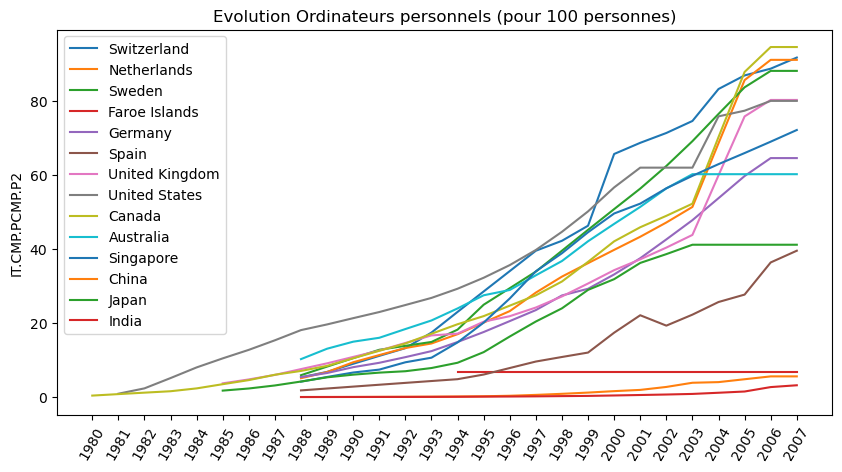

In [218]:
# Série temporelle
plt.figure(figsize=(10,5))
#series_cmp2 = data_region_net.groupby("Region").mean()
for pays in df_cmp_top.index :
    plt.plot(df_cmp_top.loc[pays, '1980':'2007'], label=pays)
plt.xticks(rotation=60)
plt.title("Evolution Ordinateurs personnels (pour 100 personnes)")
plt.ylabel('IT.CMP.PCMP.P2')
plt.legend()
plt.show()

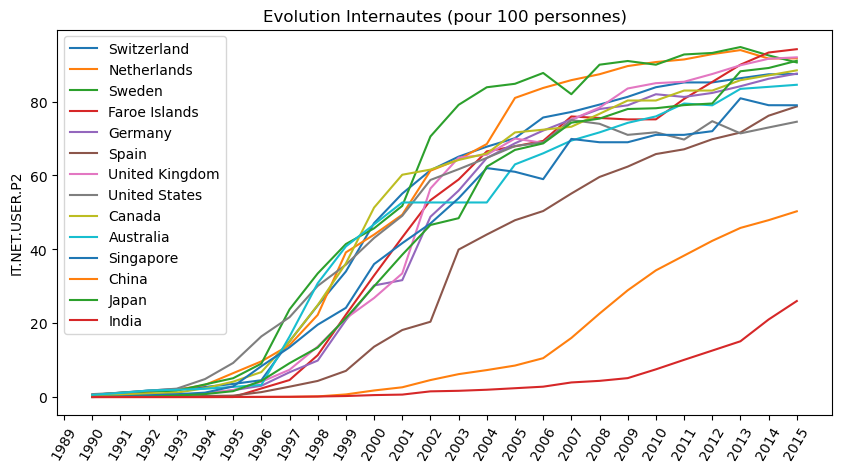

In [219]:
# Série temporelle
plt.figure(figsize=(10,5))

for pays in df_net_top.index :
    plt.plot(df_net_top.loc[pays, '1980':'2015' ], label=pays)
plt.xticks(rotation=60)
plt.title("Evolution Internautes (pour 100 personnes)")
plt.ylabel('IT.NET.USER.P2')
plt.legend()
plt.show()

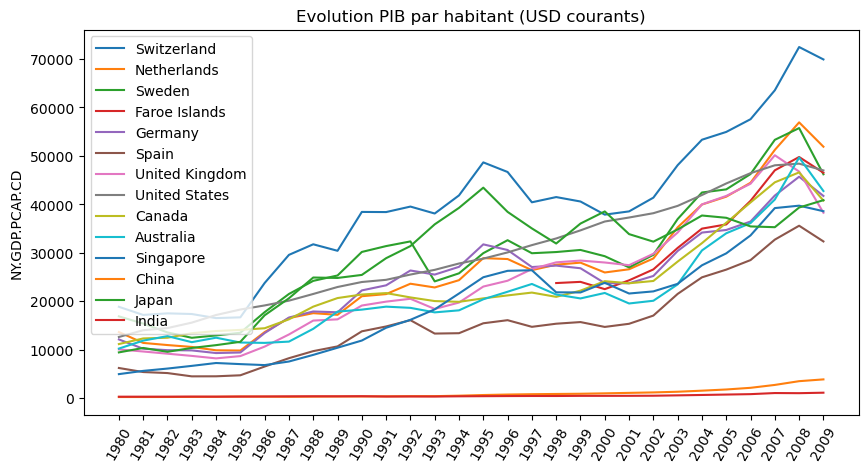

In [220]:
# Série temporelle
plt.figure(figsize=(10,5))

for pays in df_ny_top.index :
    plt.plot(df_ny_top.loc[pays, '1980':'2009' ], label=pays)
plt.xticks(rotation=60)
plt.title("Evolution PIB par habitant (USD courants)")
plt.ylabel('NY.GDP.PCAP.CD')
plt.legend()
plt.show()

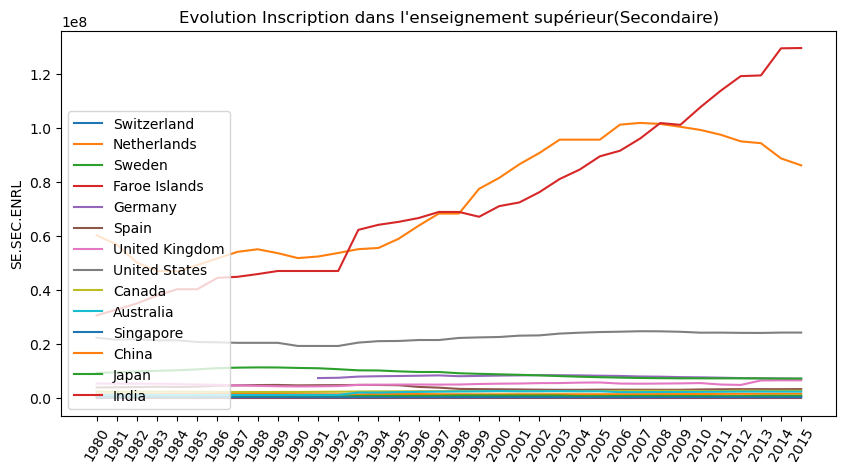

In [221]:
# Série temporelle
plt.figure(figsize=(10,5))

for pays in df_sec_top.index :
    plt.plot(df_sec_top.loc[pays, '1980':'2015' ], label=pays)
plt.xticks(rotation=60)
plt.title("Evolution Inscription dans l'enseignement supérieur(Secondaire)")
plt.ylabel('SE.SEC.ENRL')
plt.legend(loc=3)
plt.show()

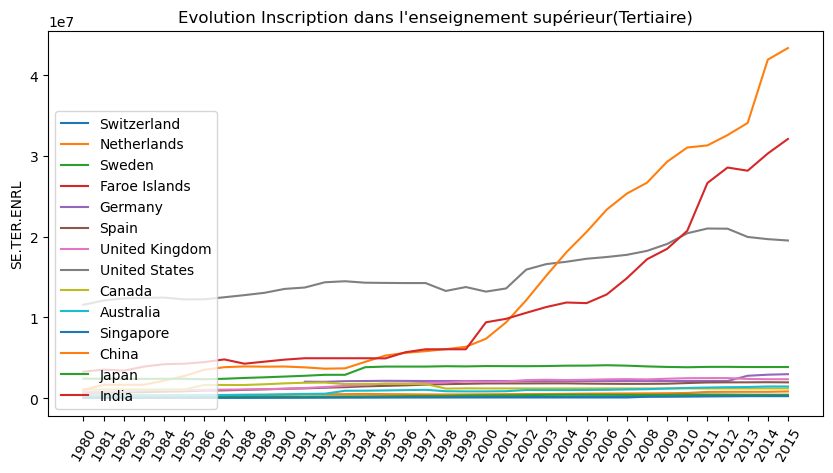

In [222]:
# Série temporelle
plt.figure(figsize=(10,5))

for pays in df_ter_top.index :
    plt.plot(df_ter_top.loc[pays, '1980': '2015' ], label=pays)
plt.xticks(rotation=60)
plt.title("Evolution Inscription dans l'enseignement supérieur(Tertiaire)")
plt.ylabel('SE.TER.ENRL')
plt.legend(loc=3)
plt.show()

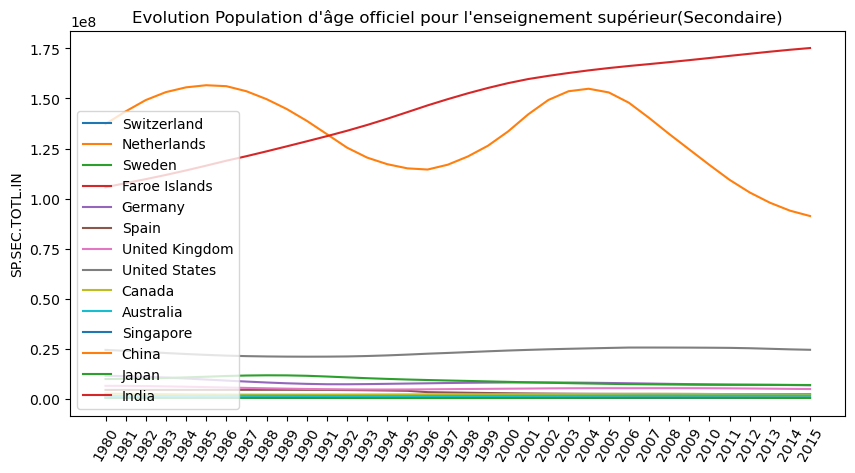

In [223]:
# Série temporelle
plt.figure(figsize=(10,5))

for pays in df_sect_top.index :
    plt.plot(df_sect_top.loc[pays, '1980': '2015'  ], label=pays)
plt.xticks(rotation=60)
plt.title("Evolution Population d'âge officiel pour l'enseignement supérieur(Secondaire)")
plt.ylabel('SP.SEC.TOTL.IN')
plt.legend(loc=3)
plt.show()

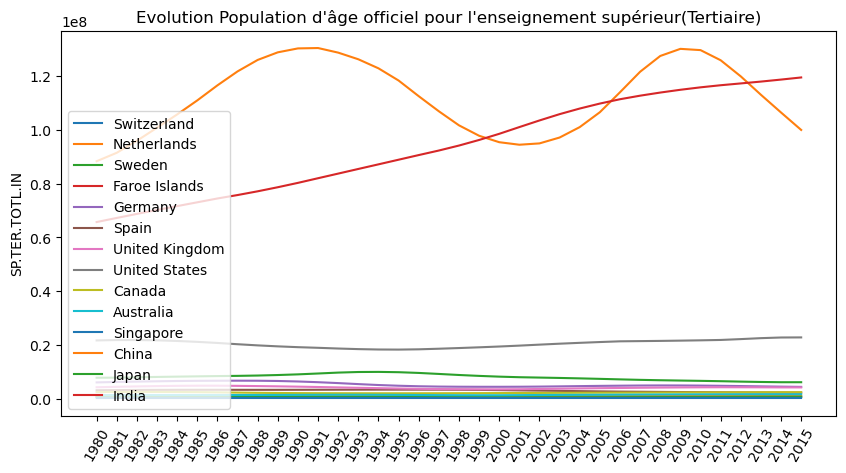

In [224]:
# Série temporelle
plt.figure(figsize=(10,5))

for pays in df_tert_top.index :
    plt.plot(df_tert_top.loc[pays, '1980': '2015'  ], label=pays)
plt.xticks(rotation=60)
plt.title("Evolution Population d'âge officiel pour l'enseignement supérieur(Tertiaire)")
plt.ylabel('SP.TER.TOTL.IN')
plt.legend(loc=3)
plt.show()

Notion d'évolution dans les prochaines années avec l'indicateur : ✅**PRJ.POP.ALL.4.MF**  
- "Wittgenstein Projection: Population in thousands by highest level of educational attainment. Post Secondary."\
Cet indicateur pourra servir de repère pour les années futures. En effet, l'indicateur donne une projection sur l'évolution de la réussite en enseignement supérieur. Dans notre contexte, on pourra prendre un intervalle de 10 ans, de 2020 à 2030 par exemple.

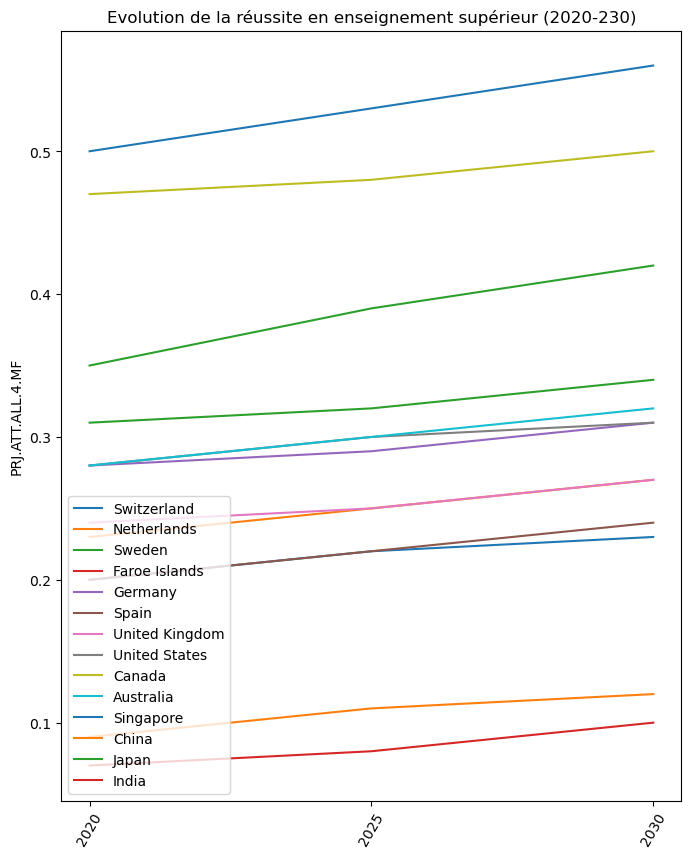

In [225]:
# Série temporelle
plt.figure(figsize=(8,10))

for pays in df_PRJ_top.index :
    plt.plot(df_PRJ_top.loc[pays, '2020': '2031'  ], label=pays)
plt.xticks(rotation=60)
plt.title("Evolution de la réussite en enseignement supérieur (2020-230)")
plt.ylabel('PRJ.ATT.ALL.4.MF')
plt.legend(loc=3)
plt.show()

### ACP (Analyse en composantes principales )

[Haut de page](#sommaire)

In [226]:
# Instancier PCA
pca = PCA(n_components=2)

# Ajuster PCA aux données
pca.fit(pays_indicateurs_rempli_scale)

# Transformer les données en deux composantes principales
X_pca = pca.transform(pays_indicateurs_rempli_scale)

print("Variance expliquée :", pca.explained_variance_ratio_)
print("Composantes principales :\n", pca.components_)
#print("Données transformées :\n", X_pca)

Variance expliquée : [0.65074882 0.17948678]
Composantes principales :
 [[ 0.59808069  0.71613858  0.35362868 -0.03268171 -0.01501329 -0.03793968
  -0.04072921]
 [ 0.09765105 -0.00339227  0.01821335  0.4905531   0.51656154  0.44911407
   0.53003719]]


In [227]:
#pays_indicateurs_rempli.columns

In [228]:
components = pca.components_
col = ['IT.CMP.PCMP.P2', 'IT.NET.USER.P2', 'NY.GDP.PCAP.CD', 'SE.SEC.ENRL',
       'SE.TER.ENRL', 'SP.SEC.TOTL.IN', 'SP.TER.TOTL.IN']
pd.DataFrame(components, columns = col)

,IT.CMP.PCMP.P2,IT.NET.USER.P2,NY.GDP.PCAP.CD,SE.SEC.ENRL,SE.TER.ENRL,SP.SEC.TOTL.IN,SP.TER.TOTL.IN
0,0.598081,0.716139,0.353629,-0.032682,-0.015013,-0.037940,-0.040729
1,0.097651,-0.003392,0.018213,0.490553,0.516562,0.449114,0.530037


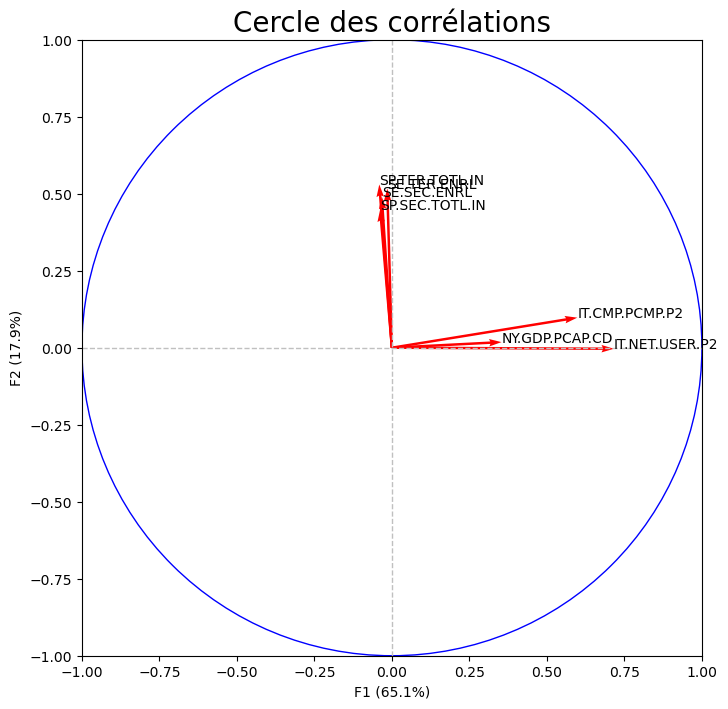

In [229]:
#Cercle des corrélations
fig = plt.subplots(figsize=(8,8))
plt.xlim(-1,1)
plt.ylim(-1,1)

plt.quiver(np.zeros(components.shape[1]), np.zeros(components.shape[1]),
           components[0,:], components[1,:], 
           angles='xy', scale_units='xy', scale=1, color='r', width= 0.004)

for i, (x, y) in enumerate(zip(components[0, :], components[1, :])):
    plt.text(x, y, pays_indicateurs_rempli_scale.iloc[:, :].columns[i], fontsize=10)
    
circle = plt.Circle((0,0), 1, facecolor='none', edgecolor='b')
plt.gca().add_artist(circle)

plt.plot([-1,1],[0,0],color='silver',linestyle='--',linewidth=1)
plt.plot([0,0],[-1,1],color='silver',linestyle='--',linewidth=1)

plt.title('Cercle des corrélations', fontsize=20)
plt.xlabel('F{} ({}%)'.format(1, round(100*pca.explained_variance_ratio_[0],1)))
plt.ylabel('F{} ({}%)'.format(2, round(100*pca.explained_variance_ratio_[1],1)))

plt.show()

In [230]:
pays_indicateurs_pca = pd.DataFrame(X_pca, index = pays_indicateurs_rempli_scale.index, columns = ['PCA1', 'PCA2'] )
pays_indicateurs_pca

,PCA1,PCA2
Country_Name,,
Albania,-0.081465,-0.061309
Algeria,-0.304368,-0.010577
American Samoa,-0.156992,-0.059627
Andorra,0.263394,-0.062368
Angola,-0.509652,-0.042972
...,...,...
Vietnam,-0.217425,0.045948
Virgin Islands (U.S.),-0.090346,-0.064267
West Bank and Gaza,-0.124546,-0.055674


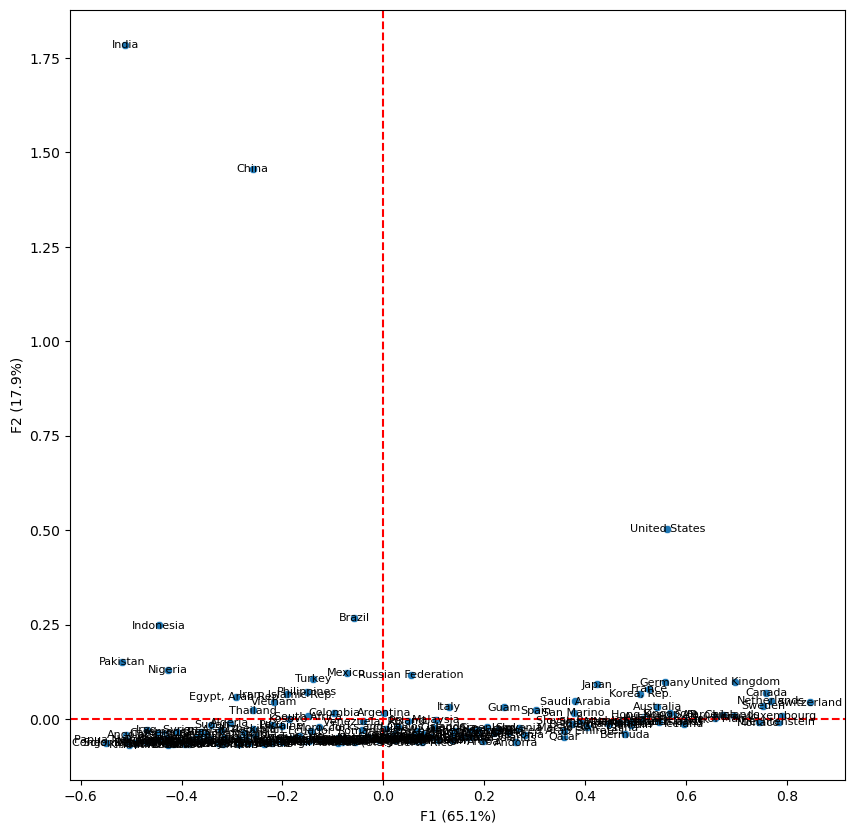

In [231]:
plt.figure(figsize=(10, 10))

sns.scatterplot(x=X_pca[:, 0], y=X_pca[:, 1])

for i, country in enumerate(pays_indicateurs_rempli_scale.index):
    plt.text(X_pca[i, 0], X_pca[i, 1], country, ha='center', va='center', fontsize=8)

plt.xlabel('F{} ({}%)'.format(1, round(100*pca.explained_variance_ratio_[0],1)))
plt.ylabel('F{} ({}%)'.format(2, round(100*pca.explained_variance_ratio_[1],1)))

plt.axhline(y=0, color='red', linestyle='--' )
plt.axvline(x=0, color='red', linestyle='--' )


plt.show()

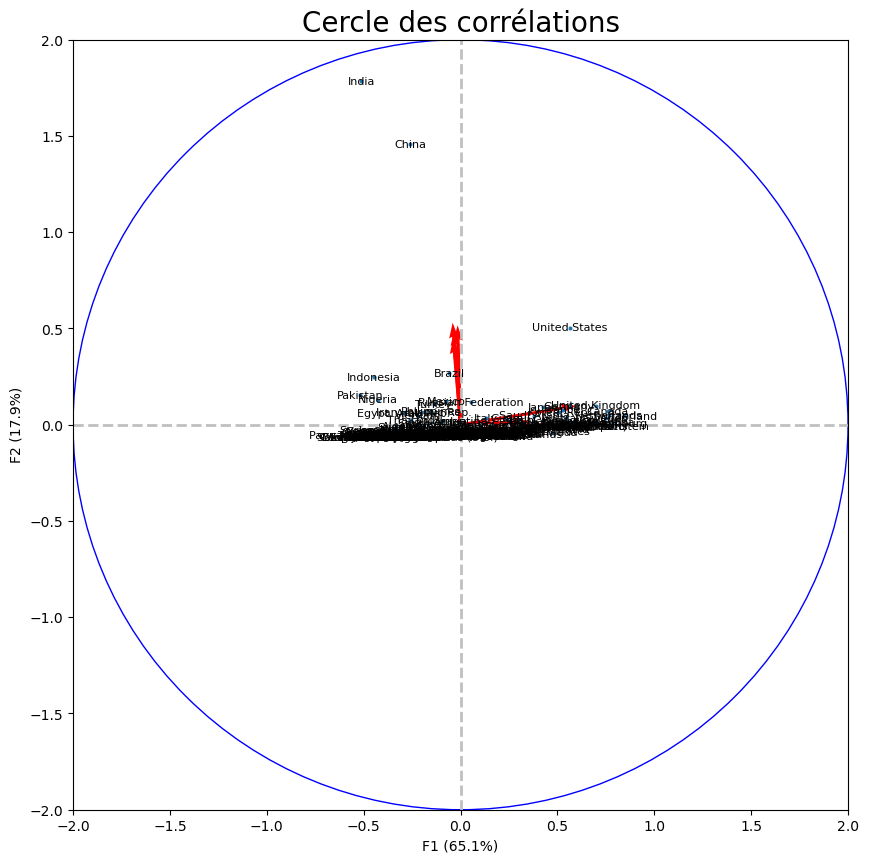

In [232]:
#Cercle des corrélations
fig = plt.subplots(figsize=(10,10))
plt.xlim(-2,2)
plt.ylim(-2,2)

plt.quiver(np.zeros(components.shape[1]), np.zeros(components.shape[1]),
           components[0,:], components[1,:], 
           angles='xy', scale_units='xy', scale=1, color='r', width= 0.004)


 
circle = plt.Circle((0,0), 2, facecolor='none', edgecolor='b')
plt.gca().add_artist(circle)

plt.plot([-2,2],[0,0],color='silver',linestyle='--',linewidth=2)
plt.plot([0,0],[-2,2],color='silver',linestyle='--',linewidth=2)

plt.title('Cercle des corrélations', fontsize=20)
plt.xlabel('F{} ({}%)'.format(1, round(100*pca.explained_variance_ratio_[0],1)))
plt.ylabel('F{} ({}%)'.format(2, round(100*pca.explained_variance_ratio_[1],1)))

sns.scatterplot(x=X_pca[:, 0], y=X_pca[:, 1], s=10)

for i, country in enumerate(pays_indicateurs_pca.index):
    plt.text(X_pca[i, 0], X_pca[i, 1], country, ha='center', va='center', fontsize=8)

plt.show()

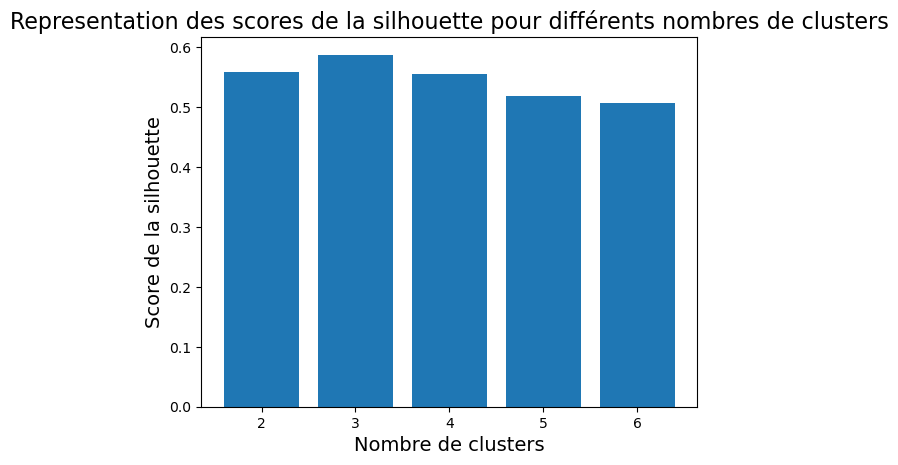

In [233]:
import warnings
warnings.filterwarnings('ignore')
os.environ["OMP_NUM_THREADS"] = "1"

# Boucle pour tester différents nombres de clusters
n_clusters = [2, 3, 4, 5, 6]
silhouette_scores = []
for n in n_clusters:
    kmeans = KMeans(n_clusters=n, random_state=0)
    kmeans.fit(X_pca)
    score = silhouette_score(X_pca, kmeans.labels_)
    silhouette_scores.append(score)

# Créer le graphique en barres pour représenter les scores de la silhouette
plt.bar(n_clusters, silhouette_scores)

# Ajouter les étiquettes pour les axes et le titre
plt.xlabel("Nombre de clusters", fontsize=14)
plt.ylabel("Score de la silhouette", fontsize=14)
plt.title("Representation des scores de la silhouette pour différents nombres de clusters", fontsize=16)

# Afficher le graphique
plt.show()



<a id='15'></a>

### HAC (Hierarchical Agglomerative Clustering) choix de <font color = 'green'>"3 Clusters "</font> 


[Haut de page](#sommaire)

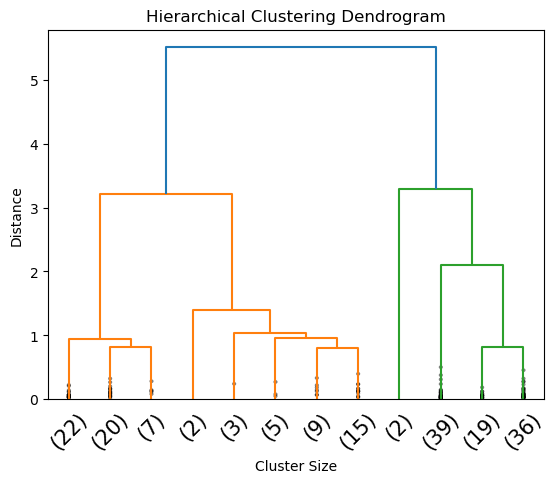

In [234]:
# linkage matrix
Z = linkage(pays_indicateurs_rempli_scale, method='ward')

# dendrogram
dendrogram(Z, truncate_mode='lastp', p=12, leaf_rotation=45., leaf_font_size=15., show_contracted=True)
plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Cluster Size")
plt.ylabel("Distance")
plt.show()

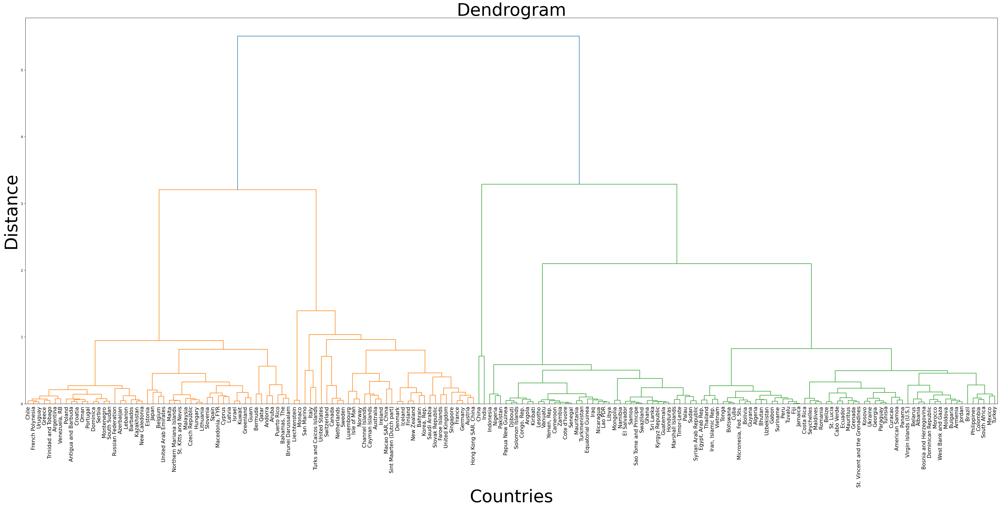

In [235]:
# Liste des noms de 170 pays
countries = pays_indicateurs_rempli_scale.index

# Ajuster la taille de la figure
plt.figure(figsize=(50, 20), dpi=100)

# Dessiner le dendrogram
dendrogram(Z, labels=countries, leaf_rotation=90, leaf_font_size=15)

# Ajouter des titres et des étiquettes aux axes
plt.title("Dendrogram", size = 50)
plt.xlabel("Countries", size = 50)
plt.ylabel("Distance", size = 50)

# Afficher le dendrogram
plt.show()

In [236]:
# Instancier le modèle
model_HAC_3 = AgglomerativeClustering(n_clusters=3)

# Entraîner le modèle sur les données
model_HAC_3.fit(pays_indicateurs_rempli_scale)

# Prédire les clusters pour chaque observation
labels_3 = model_HAC_3.labels_

# Imprimer les résultats
#print("Observations :\n", pays_indicateurs_rempli_scale)
print("Labels :\n", labels_3)

Labels :
 [1 1 1 0 1 0 0 1 0 0 0 0 0 0 0 1 0 1 0 1 1 1 1 1 0 1 1 1 0 0 0 0 2 1 1 1 1
 0 1 1 0 0 0 1 0 1 1 1 1 1 0 0 1 0 0 0 1 1 0 1 0 0 1 0 1 1 1 0 0 0 2 1 1 1
 0 0 0 0 1 0 1 0 1 0 1 0 1 1 0 0 1 1 0 0 0 0 0 0 1 0 1 1 1 1 1 1 0 1 0 1 1
 0 0 0 1 1 0 0 0 1 1 1 1 1 1 1 0 0 0 0 1 0 1 0 1 0 1 0 1 0 0 0 0 1 1 0 0 1
 0 1 1 1 1 1 0 0 1 1 1 1 0 1 1 1 0 1 1 0 0 0 0 1 1 0 1 1 1 1 1]


In [237]:
pays_indicateurs_rempli_scale_HACLabel_3 = pays_indicateurs_rempli_scale.copy()

In [238]:
pays_indicateurs_rempli_scale_HACLabel_3['Labels'] = labels_3
print('Labels sont --->', pays_indicateurs_rempli_scale_HACLabel_3['Labels'].unique())
pays_indicateurs_rempli_scale_HACLabel_3.head()

Labels sont ---> [1 0 2]


Indicator_Code,IT.CMP.PCMP.P2,IT.NET.USER.P2,NY.GDP.PCAP.CD,SE.SEC.ENRL,SE.TER.ENRL,SP.SEC.TOTL.IN,SP.TER.TOTL.IN,Labels
Country_Name,,,,,,,,
Albania,0.045187,0.613366,0.018083,0.002422,0.003697,0.001871,0.002304,1
Algeria,0.008038,0.337171,0.019430,0.035288,0.029729,0.023156,0.029224,1
American Samoa,0.096239,0.441472,0.065508,0.000132,0.000033,0.000317,0.000349,1
Andorra,0.063508,0.984416,0.210048,0.000024,0.000007,0.000048,0.000069,0
Angola,0.004029,0.052741,0.016653,0.006822,0.005092,0.020334,0.019868,1


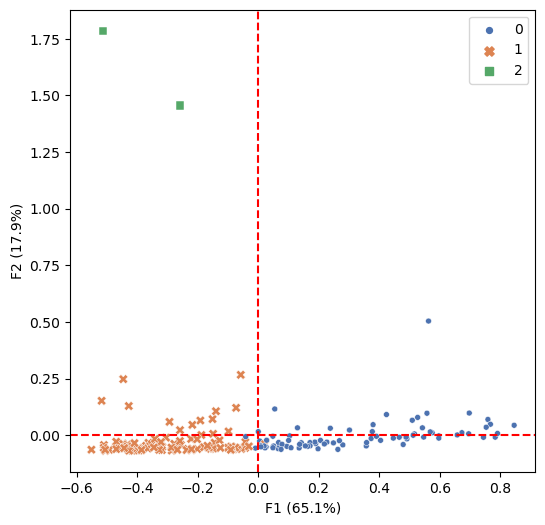

In [239]:
plt.figure(figsize=(6, 6))

sns.scatterplot(x=X_pca[:, 0], y=X_pca[:, 1], hue=pays_indicateurs_rempli_scale_HACLabel_3["Labels"], 
                style=pays_indicateurs_rempli_scale_HACLabel_3["Labels"], palette="deep", 
                size=pays_indicateurs_rempli_scale_HACLabel_3["Labels"])


plt.xlabel('F{} ({}%)'.format(1, round(100*pca.explained_variance_ratio_[0],1)))
plt.ylabel('F{} ({}%)'.format(2, round(100*pca.explained_variance_ratio_[1],1)))
plt.legend()

plt.axhline(y=0, color='red', linestyle='--' )
plt.axvline(x=0, color='red', linestyle='--' )

plt.show()

In [240]:
# Plot scatter plot using Plotly
fig_5 = px.scatter(pays_indicateurs_rempli_scale_HACLabel_3, x=X_pca[:, 0], y=X_pca[:, 1], 
                   text=pays_indicateurs_rempli_scale_HACLabel_3.index, 
                   color=pays_indicateurs_rempli_scale_HACLabel_3['Labels'])

fig_5.update_layout(
    width=700,
    height=700,
    title={"text": "Scatter Plot de PCA avec 3 clusters", "font": {"size": 24}},
    xaxis_title="F1",
    yaxis_title="F2"
)

# Show plot
fig_5.show()

In [241]:
#Mask pour 3 Clusters
mask_HAC_0 = pays_indicateurs_rempli_scale_HACLabel_3['Labels'] == 0
mask_HAC_1 = pays_indicateurs_rempli_scale_HACLabel_3['Labels'] == 1
mask_HAC_2 = pays_indicateurs_rempli_scale_HACLabel_3['Labels'] == 2

In [242]:
pays_indicateurs_rempli_scale_HACLabel_0 = pays_indicateurs_rempli_scale_HACLabel_3[mask_HAC_0]
print('Nombre des pays cluster 0 -->', len(pays_indicateurs_rempli_scale_HACLabel_0.index) )
print('Noms des pay cluster 0 -->', list(pays_indicateurs_rempli_scale_HACLabel_0.index ))

#pays_indicateurs_rempli_scale_HACLabel_0

Nombre des pays cluster 0 --> 83
Noms des pay cluster 0 --> ['Andorra', 'Antigua and Barbuda', 'Argentina', 'Aruba', 'Australia', 'Austria', 'Azerbaijan', 'Bahamas, The', 'Bahrain', 'Barbados', 'Belgium', 'Bermuda', 'Brunei Darussalam', 'Canada', 'Cayman Islands', 'Channel Islands', 'Chile', 'Croatia', 'Cyprus', 'Czech Republic', 'Denmark', 'Dominica', 'Estonia', 'Faroe Islands', 'Finland', 'France', 'French Polynesia', 'Germany', 'Greece', 'Greenland', 'Guam', 'Hong Kong SAR, China', 'Hungary', 'Iceland', 'Ireland', 'Isle of Man', 'Israel', 'Italy', 'Japan', 'Kazakhstan', 'Korea, Rep.', 'Kuwait', 'Latvia', 'Lebanon', 'Liechtenstein', 'Lithuania', 'Luxembourg', 'Macao SAR, China', 'Macedonia, FYR', 'Malaysia', 'Malta', 'Monaco', 'Montenegro', 'Netherlands', 'New Caledonia', 'New Zealand', 'Northern Mariana Islands', 'Norway', 'Oman', 'Poland', 'Portugal', 'Puerto Rico', 'Qatar', 'Russian Federation', 'San Marino', 'Saudi Arabia', 'Serbia', 'Singapore', 'Sint Maarten (Dutch part)', 'Slo

In [243]:
pays_indicateurs_rempli_scale_HACLabel_1 = pays_indicateurs_rempli_scale_HACLabel_3[mask_HAC_1]
print('Nombre des pays cluster 1 -->', len(pays_indicateurs_rempli_scale_HACLabel_1.index) )
print('Noms des pay cluster 1 -->', list(pays_indicateurs_rempli_scale_HACLabel_1.index ))
#pays_indicateurs_rempli_scale_HACLabel_1

Nombre des pays cluster 1 --> 94
Noms des pay cluster 1 --> ['Albania', 'Algeria', 'American Samoa', 'Angola', 'Armenia', 'Belarus', 'Belize', 'Bhutan', 'Bolivia', 'Bosnia and Herzegovina', 'Botswana', 'Brazil', 'Bulgaria', 'Cabo Verde', 'Cameroon', 'Colombia', 'Congo, Rep.', 'Costa Rica', "Cote d'Ivoire", 'Cuba', 'Curacao', 'Djibouti', 'Dominican Republic', 'Ecuador', 'Egypt, Arab Rep.', 'El Salvador', 'Equatorial Guinea', 'Fiji', 'Gabon', 'Georgia', 'Ghana', 'Grenada', 'Guatemala', 'Guyana', 'Honduras', 'Indonesia', 'Iran, Islamic Rep.', 'Iraq', 'Jamaica', 'Jordan', 'Kiribati', 'Kosovo', 'Kyrgyz Republic', 'Lao PDR', 'Lesotho', 'Libya', 'Maldives', 'Marshall Islands', 'Mauritania', 'Mauritius', 'Mexico', 'Micronesia, Fed. Sts.', 'Moldova', 'Mongolia', 'Morocco', 'Namibia', 'Nicaragua', 'Nigeria', 'Pakistan', 'Palau', 'Panama', 'Papua New Guinea', 'Paraguay', 'Peru', 'Philippines', 'Romania', 'Samoa', 'Sao Tome and Principe', 'Senegal', 'Seychelles', 'Solomon Islands', 'South Africa',

In [244]:
pays_indicateurs_rempli_scale_HACLabel_2 = pays_indicateurs_rempli_scale_HACLabel_3[mask_HAC_2]
print('Nombre des pays cluster 2 -->', len(pays_indicateurs_rempli_scale_HACLabel_2.index) )
print('Noms des pay cluster 2 -->', list(pays_indicateurs_rempli_scale_HACLabel_2.index) )
#pays_indicateurs_rempli_scale_HACLabel_1

Nombre des pays cluster 2 --> 2
Noms des pay cluster 2 --> ['China', 'India']


<a id='16'></a>

### HAC (Hierarchical Agglomerative Clustering) choix de <font color = 'green'>"5 Clusters "</font> 


[Haut de page](#sommaire)

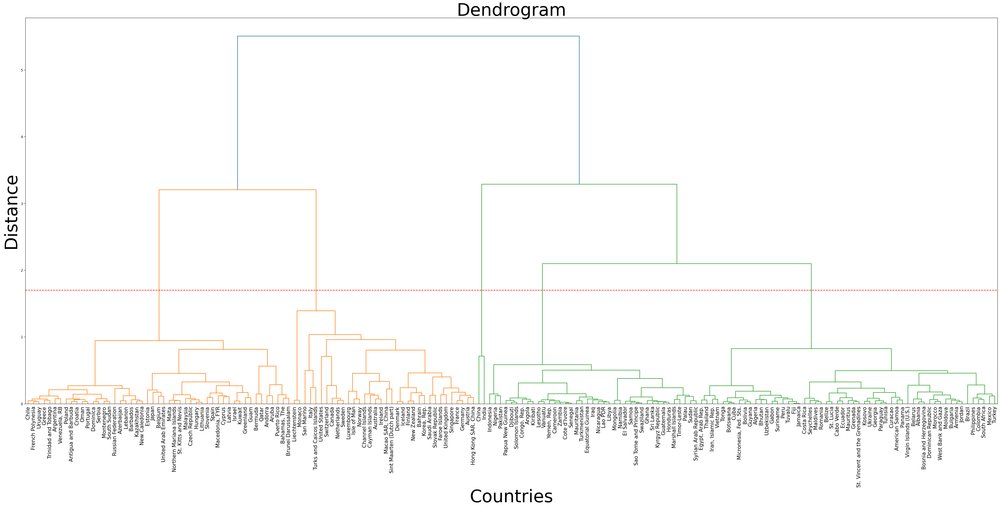

In [245]:
# Liste des noms de 170 pays
countries = pays_indicateurs_rempli_scale.index

# Ajuster la taille de la figure
plt.figure(figsize=(50, 20), dpi=100)

# Dessiner le dendrogram
dendrogram(Z, labels=countries, leaf_rotation=90, leaf_font_size=15)

# Ajouter des titres et des étiquettes aux axes
plt.title("Dendrogram", size = 50)
plt.xlabel("Countries", size = 50)
plt.ylabel("Distance", size = 50)

# Tracer une ligne horizontale en y = 0
plt.axhline(y=1.7, color='red', linestyle='--' )


# Afficher le dendrogram
plt.show()

In [246]:
# Instancier le modèle
model_HAC_5 = AgglomerativeClustering(n_clusters=5)

# Entraîner le modèle sur les données
model_HAC_5.fit(pays_indicateurs_rempli_scale)

# Prédire les clusters pour chaque observation
labels_5 = model_HAC_5.labels_

# Imprimer les résultats
#print("Observations :\n", pays_indicateurs_rempli_scale)
print("Labels :\n", labels_5)

Labels :
 [3 3 3 1 4 1 1 3 1 0 0 1 1 0 1 3 1 3 1 3 3 3 3 3 1 3 3 4 0 0 0 1 2 3 4 3 4
 1 3 3 1 1 0 4 1 3 3 3 4 4 1 0 3 0 0 1 3 3 0 4 1 1 3 1 4 3 4 0 1 0 2 4 3 4
 0 0 1 0 3 1 3 1 4 0 3 1 4 4 1 1 4 4 0 1 0 0 1 1 3 1 4 4 3 3 3 3 0 4 1 3 4
 0 1 0 4 4 1 0 1 4 4 3 4 3 3 3 1 1 1 1 3 1 4 0 4 0 4 1 3 0 0 0 1 4 3 1 1 4
 1 3 3 4 3 4 0 0 4 3 4 3 1 3 3 4 0 3 3 1 0 0 1 3 4 1 3 3 3 4 4]


In [247]:
pays_indicateurs_rempli_scale_HACLabel_5 = pays_indicateurs_rempli_scale.copy()

In [248]:
pays_indicateurs_rempli_scale_HACLabel_5['Labels'] = labels_5
print('Labels sont --->', pays_indicateurs_rempli_scale_HACLabel_5['Labels'].unique())
pays_indicateurs_rempli_scale_HACLabel_5.head()

Labels sont ---> [3 1 4 0 2]


Indicator_Code,IT.CMP.PCMP.P2,IT.NET.USER.P2,NY.GDP.PCAP.CD,SE.SEC.ENRL,SE.TER.ENRL,SP.SEC.TOTL.IN,SP.TER.TOTL.IN,Labels
Country_Name,,,,,,,,
Albania,0.045187,0.613366,0.018083,0.002422,0.003697,0.001871,0.002304,3
Algeria,0.008038,0.337171,0.019430,0.035288,0.029729,0.023156,0.029224,3
American Samoa,0.096239,0.441472,0.065508,0.000132,0.000033,0.000317,0.000349,3
Andorra,0.063508,0.984416,0.210048,0.000024,0.000007,0.000048,0.000069,1
Angola,0.004029,0.052741,0.016653,0.006822,0.005092,0.020334,0.019868,4


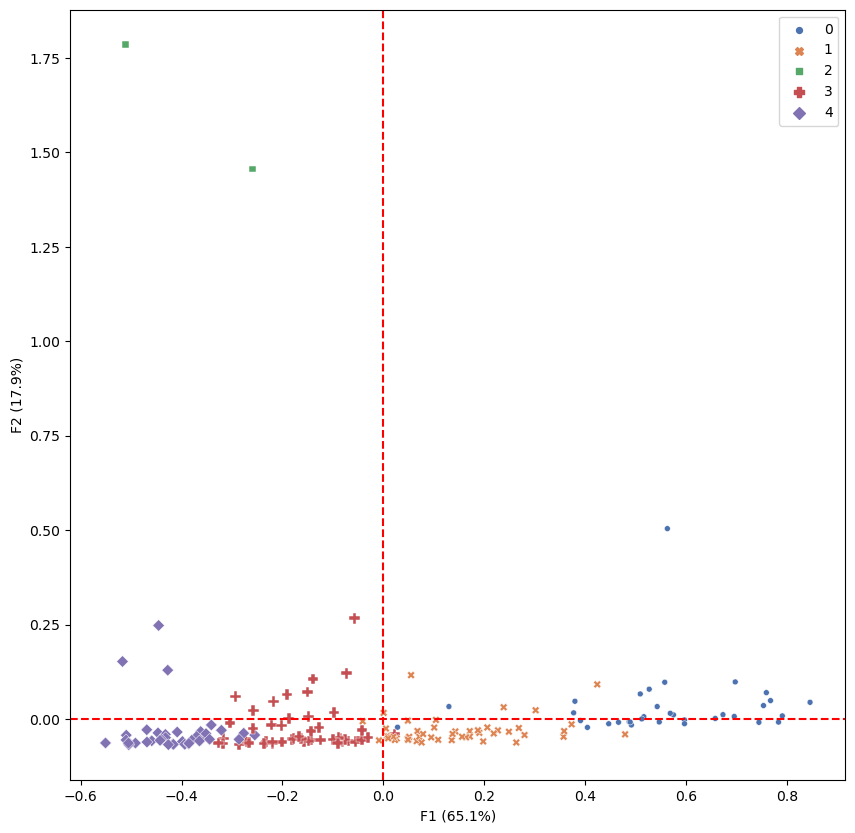

In [249]:
plt.figure(figsize=(10, 10))

sns.scatterplot(x=X_pca[:, 0], y=X_pca[:, 1], hue=pays_indicateurs_rempli_scale_HACLabel_5["Labels"], 
                style=pays_indicateurs_rempli_scale_HACLabel_5["Labels"], palette="deep", 
                size=pays_indicateurs_rempli_scale_HACLabel_5["Labels"])


plt.xlabel('F{} ({}%)'.format(1, round(100*pca.explained_variance_ratio_[0],1)))
plt.ylabel('F{} ({}%)'.format(2, round(100*pca.explained_variance_ratio_[1],1)))
plt.legend()

plt.axhline(y=0, color='red', linestyle='--' )
plt.axvline(x=0, color='red', linestyle='--' )

plt.show()

In [250]:
# Plot scatter plot using Plotly
fig_6 = px.scatter(pays_indicateurs_rempli_scale_HACLabel_5, x=X_pca[:, 0], y=X_pca[:, 1], 
                                      
                   color=pays_indicateurs_rempli_scale_HACLabel_5['Labels']) #text=pays_indicateurs_rempli_scale_HACLabel_3.index,

fig_6.update_layout(
    width=700,
    height=700,
    title={"text": "Scatter Plot de PCA avec 5 clusters", "font": {"size": 24}},
    xaxis_title="F1",
    yaxis_title="F2"
)

# Show plot
fig_6.show()

In [251]:
#Mask pour 5 Clusters
mask_HAC5_0 = pays_indicateurs_rempli_scale_HACLabel_5['Labels'] == 0
mask_HAC5_1 = pays_indicateurs_rempli_scale_HACLabel_5['Labels'] == 1
mask_HAC5_2 = pays_indicateurs_rempli_scale_HACLabel_5['Labels'] == 2
mask_HAC5_3 = pays_indicateurs_rempli_scale_HACLabel_5['Labels'] == 3
mask_HAC5_4 = pays_indicateurs_rempli_scale_HACLabel_5['Labels'] == 4

In [252]:
pays_indicateurs_rempli_scale_HACLabel_5_0 = pays_indicateurs_rempli_scale_HACLabel_5[mask_HAC5_0]
print('Nombre des pays cluster 0 -->', len(pays_indicateurs_rempli_scale_HACLabel_5_0.index) )
print('Noms des pay cluster 0 -->', list(pays_indicateurs_rempli_scale_HACLabel_5_0.index ))

Nombre des pays cluster 0 --> 34
Noms des pay cluster 0 --> ['Australia', 'Austria', 'Bahrain', 'Canada', 'Cayman Islands', 'Channel Islands', 'Denmark', 'Faroe Islands', 'Finland', 'France', 'Germany', 'Hong Kong SAR, China', 'Iceland', 'Ireland', 'Isle of Man', 'Italy', 'Korea, Rep.', 'Liechtenstein', 'Luxembourg', 'Macao SAR, China', 'Monaco', 'Netherlands', 'New Zealand', 'Norway', 'San Marino', 'Saudi Arabia', 'Singapore', 'Sint Maarten (Dutch part)', 'Slovak Republic', 'Sweden', 'Switzerland', 'Turks and Caicos Islands', 'United Kingdom', 'United States']


In [253]:
pays_indicateurs_rempli_scale_HACLabel_5_1 = pays_indicateurs_rempli_scale_HACLabel_5[mask_HAC5_1]
print('Nombre des pays cluster 1 -->', len(pays_indicateurs_rempli_scale_HACLabel_5_1.index) )
print('Noms des pay cluster 1 -->', list(pays_indicateurs_rempli_scale_HACLabel_5_1.index ))

Nombre des pays cluster 1 --> 49
Noms des pay cluster 1 --> ['Andorra', 'Antigua and Barbuda', 'Argentina', 'Aruba', 'Azerbaijan', 'Bahamas, The', 'Barbados', 'Belgium', 'Bermuda', 'Brunei Darussalam', 'Chile', 'Croatia', 'Cyprus', 'Czech Republic', 'Dominica', 'Estonia', 'French Polynesia', 'Greece', 'Greenland', 'Guam', 'Hungary', 'Israel', 'Japan', 'Kazakhstan', 'Kuwait', 'Latvia', 'Lebanon', 'Lithuania', 'Macedonia, FYR', 'Malaysia', 'Malta', 'Montenegro', 'New Caledonia', 'Northern Mariana Islands', 'Oman', 'Poland', 'Portugal', 'Puerto Rico', 'Qatar', 'Russian Federation', 'Serbia', 'Slovenia', 'South Sudan', 'Spain', 'St. Kitts and Nevis', 'Trinidad and Tobago', 'United Arab Emirates', 'Uruguay', 'Venezuela, RB']


In [254]:
pays_indicateurs_rempli_scale_HACLabel_5_2 = pays_indicateurs_rempli_scale_HACLabel_5[mask_HAC5_2]
print('Nombre des pays cluster 2 -->', len(pays_indicateurs_rempli_scale_HACLabel_5_2.index) )
print('Noms des pay cluster 2 -->', list(pays_indicateurs_rempli_scale_HACLabel_5_2.index ))

Nombre des pays cluster 2 --> 2
Noms des pay cluster 2 --> ['China', 'India']


In [255]:
pays_indicateurs_rempli_scale_HACLabel_5_3 = pays_indicateurs_rempli_scale_HACLabel_5[mask_HAC5_3]
print('Nombre des pays cluster 3 -->', len(pays_indicateurs_rempli_scale_HACLabel_5_3.index) )
print('Noms des pay cluster 3 -->', list(pays_indicateurs_rempli_scale_HACLabel_5_3.index ))

Nombre des pays cluster 3 --> 55
Noms des pay cluster 3 --> ['Albania', 'Algeria', 'American Samoa', 'Armenia', 'Belarus', 'Belize', 'Bhutan', 'Bolivia', 'Bosnia and Herzegovina', 'Botswana', 'Brazil', 'Bulgaria', 'Cabo Verde', 'Colombia', 'Costa Rica', 'Cuba', 'Curacao', 'Dominican Republic', 'Ecuador', 'Egypt, Arab Rep.', 'Fiji', 'Gabon', 'Georgia', 'Grenada', 'Guyana', 'Iran, Islamic Rep.', 'Jamaica', 'Jordan', 'Kosovo', 'Maldives', 'Mauritius', 'Mexico', 'Micronesia, Fed. Sts.', 'Moldova', 'Morocco', 'Panama', 'Paraguay', 'Peru', 'Philippines', 'Romania', 'Seychelles', 'South Africa', 'St. Lucia', 'St. Vincent and the Grenadines', 'Suriname', 'Thailand', 'Tonga', 'Tunisia', 'Turkey', 'Tuvalu', 'Ukraine', 'Uzbekistan', 'Vietnam', 'Virgin Islands (U.S.)', 'West Bank and Gaza']


In [256]:
pays_indicateurs_rempli_scale_HACLabel_5_4 = pays_indicateurs_rempli_scale_HACLabel_5[mask_HAC5_4]
print('Nombre des pays cluster 4 -->', len(pays_indicateurs_rempli_scale_HACLabel_5_4.index) )
print('Noms des pay cluster 4 -->', list(pays_indicateurs_rempli_scale_HACLabel_5_4.index ))

Nombre des pays cluster 4 --> 39
Noms des pay cluster 4 --> ['Angola', 'Cameroon', 'Congo, Rep.', "Cote d'Ivoire", 'Djibouti', 'El Salvador', 'Equatorial Guinea', 'Ghana', 'Guatemala', 'Honduras', 'Indonesia', 'Iraq', 'Kiribati', 'Kyrgyz Republic', 'Lao PDR', 'Lesotho', 'Libya', 'Marshall Islands', 'Mauritania', 'Mongolia', 'Namibia', 'Nicaragua', 'Nigeria', 'Pakistan', 'Palau', 'Papua New Guinea', 'Samoa', 'Sao Tome and Principe', 'Senegal', 'Solomon Islands', 'Sri Lanka', 'Sudan', 'Swaziland', 'Syrian Arab Republic', 'Timor-Leste', 'Turkmenistan', 'Vanuatu', 'Yemen, Rep.', 'Zambia']


In [257]:
#Avoir DataFrame avec ensemble des indicateur pour calculer le potentiel des pays
pays_indicateurs_rempli_scale_HACLabel_5_0_potentiel = pays_indicateurs_rempli_scale_HACLabel_5_0.copy()

#Sum le valeur de chaque indicateur pour le même pays
plus_5 = np.sum(pays_indicateurs_rempli_scale_HACLabel_5_0,axis=1)
pays_indicateurs_rempli_scale_HACLabel_5_0_potentiel['potentiel_5'] = plus_5

#df_ready_imputer_cls1.to_csv('df_cls_pot.csv')
pays_indicateurs_rempli_scale_HACLabel_5_0_potentiel.head(3)

Indicator_Code,IT.CMP.PCMP.P2,IT.NET.USER.P2,NY.GDP.PCAP.CD,SE.SEC.ENRL,SE.TER.ENRL,SP.SEC.TOTL.IN,SP.TER.TOTL.IN,Labels,potentiel_5
Country_Name,,,,,,,,,
Australia,0.624343,0.848270,0.332725,0.018295,0.033512,0.009779,0.013402,0,1.880326
Austria,0.629560,0.841430,0.259185,0.005325,0.009818,0.003937,0.004364,0,1.753619
Bahrain,0.537650,0.946583,0.130224,0.000704,0.000893,0.000509,0.000744,0,1.617307


In [258]:
# DF pour avoir le potentiel de pays dans le cluster choisi
df_pot_rank =  pays_indicateurs_rempli_scale_HACLabel_5_0_potentiel[['potentiel_5']].sort_values(by='potentiel_5', ascending=False)
df_pot_rank['rank'] = df_pot_rank['potentiel_5'].rank(ascending=False)
df_pot_rank.head()

Indicator_Code,potentiel_5,rank
Country_Name,,
United States,2.869203,1.0
Liechtenstein,2.450617,2.0
Switzerland,2.384664,3.0
Monaco,2.377839,4.0
Luxembourg,2.299747,5.0


In [259]:
#Avoir DataFrame avec ensemble des indicateur pour calculer le potentiel des pays
pays_indicateurs_rempli_scale_HACLabel_5_1_potentiel = pays_indicateurs_rempli_scale_HACLabel_5_1.copy()

#Sum le valeur de chaque indicateur pour le même pays
plus_5_1 = np.sum(pays_indicateurs_rempli_scale_HACLabel_5_1,axis=1)
pays_indicateurs_rempli_scale_HACLabel_5_1_potentiel['potentiel_5'] = plus_5_1

#df_ready_imputer_cls1.to_csv('df_cls_pot.csv')
pays_indicateurs_rempli_scale_HACLabel_5_1_potentiel.head(3)

Indicator_Code,IT.CMP.PCMP.P2,IT.NET.USER.P2,NY.GDP.PCAP.CD,SE.SEC.ENRL,SE.TER.ENRL,SP.SEC.TOTL.IN,SP.TER.TOTL.IN,Labels,potentiel_5
Country_Name,,,,,,,,,
Andorra,0.063508,0.984416,0.210048,0.000024,0.000007,0.000048,0.000069,1,2.258120
Antigua and Barbuda,0.215895,0.687748,0.076230,0.000052,0.000037,0.000037,0.000058,1,1.980057
Argentina,0.091715,0.666174,0.075082,0.034348,0.066162,0.023999,0.028874,1,1.986355


In [260]:
# DF pour avoir le potentiel de pays dans le cluster choisi
df_pot_rank_cluster1 =  pays_indicateurs_rempli_scale_HACLabel_5_1_potentiel[['potentiel_5']].sort_values(by='potentiel_5', ascending=False)
df_pot_rank_cluster1['rank'] = df_pot_rank_cluster1['potentiel_5'].rank(ascending=False)
df_pot_rank_cluster1.head()

Indicator_Code,potentiel_5,rank
Country_Name,,
Japan,2.782540,1.0
Bermuda,2.737146,2.0
Belgium,2.510107,3.0
Qatar,2.501342,4.0
United Arab Emirates,2.452568,5.0


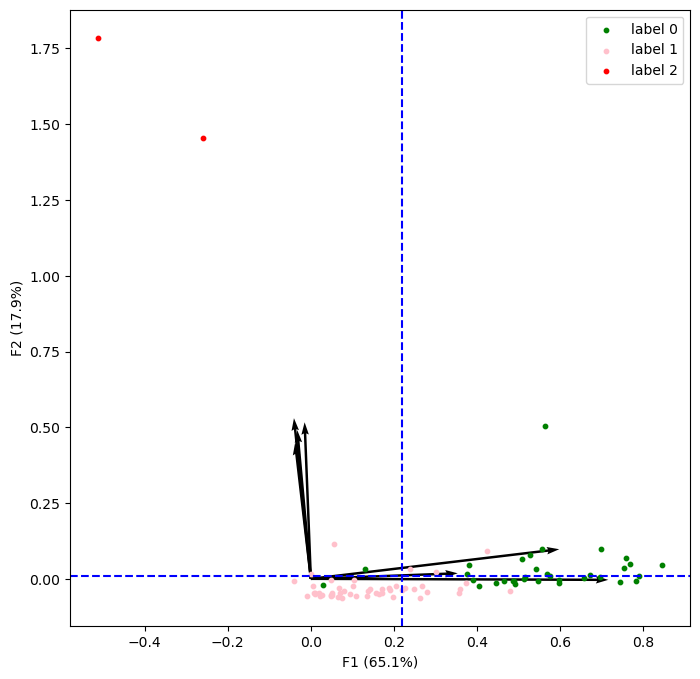

In [261]:
plt.figure(figsize=(8,8))

plt.quiver(np.zeros(components.shape[1]), np.zeros(components.shape[1]),
           components[0,:], components[1,:], 
           angles='xy', scale_units='xy', scale=1, color='black', width= 0.004)

plt.scatter(X_pca[labels_5 == 0, 0], X_pca[labels_5 == 0, 1], s = 10, c='green', label = 'label 0' )
plt.scatter(X_pca[labels_5 == 1, 0], X_pca[labels_5 == 1, 1], s = 10, c='pink', label = 'label 1' )
plt.scatter(X_pca[labels_5 == 2, 0], X_pca[labels_5 == 2, 1], s = 10, c='red', label = 'label 2' )
#plt.scatter(X_pca[labels_5 == 3, 0], X_pca[labels_5 == 3, 1], s = 10, c='yellow' )
#plt.scatter(X_pca[labels_5 == 4, 0], X_pca[labels_5 == 4, 1], s = 10, c='blue' )

plt.xlabel('F{} ({}%)'.format(1, round(100*pca.explained_variance_ratio_[0],1)))
plt.ylabel('F{} ({}%)'.format(2, round(100*pca.explained_variance_ratio_[1],1)))
plt.legend()

#plt.axhline(y=0, color='pink', linestyle='-', linewidth = 3 )
#plt.axvline(x=0, color='pink', linestyle='-', linewidth = 3 )
plt.axvline(x=0.22, color='blue', linestyle='--' )
plt.axhline(y=0.01, color='blue', linestyle='--' )


plt.show()

In [262]:
#DataFrame PCA + 5Labels
pays_indicateurs_pca_plusLabels = pays_indicateurs_pca.copy()  
pays_indicateurs_pca_plusLabels['labels'] = labels_5

pays_indicateurs_pca_plusLabels.head()

,PCA1,PCA2,labels
Country_Name,,,
Albania,-0.081465,-0.061309,3
Algeria,-0.304368,-0.010577,3
American Samoa,-0.156992,-0.059627,3
Andorra,0.263394,-0.062368,1
Angola,-0.509652,-0.042972,4


In [263]:
#Filtre pour Label 0
mask_label_pca_label0 = pays_indicateurs_pca_plusLabels['labels'] == 0
#Filtre pour les pays inférieur à 0.2 sur F1 dans CLUSTER 0
mask_label_pca_pca1_0 = pays_indicateurs_pca_plusLabels['PCA1'] < 0.2
#Filtre pour les pays inférieur à 0.0 sur F2 dans CLUSTER 0
mask_label_pca_pca2_0 = pays_indicateurs_pca_plusLabels['PCA2'] < 0.01


pays_inf_F1 = pays_indicateurs_pca_plusLabels[mask_label_pca_label0 & mask_label_pca_pca1_0 ]
#pays_inf_F1

In [264]:
pays_inf_F2 = pays_indicateurs_pca_plusLabels[mask_label_pca_label0 & mask_label_pca_pca2_0]
#pays_inf_F2

In [265]:
print('Cluster 0 - les pays inférieur à 0.2 sur F1\n\n', list(pays_inf_F1.index))

Cluster 0 - les pays inférieur à 0.2 sur F1

 ['Italy', 'Turks and Caicos Islands']


In [266]:
print('Cluster 0 - les pays inférieur à 0.01 sur F2\n\n', list(pays_inf_F2.index))

Cluster 0 - les pays inférieur à 0.01 sur F2

 ['Austria', 'Bahrain', 'Cayman Islands', 'Channel Islands', 'Denmark', 'Finland', 'Iceland', 'Ireland', 'Isle of Man', 'Liechtenstein', 'Luxembourg', 'Macao SAR, China', 'Monaco', 'New Zealand', 'Norway', 'Sint Maarten (Dutch part)', 'Slovak Republic', 'Turks and Caicos Islands']


In [267]:
pay_supprimer = list(pays_inf_F1.index) + list(pays_inf_F2.index)
pays_choisis = pays_indicateurs_pca_plusLabels[ pays_indicateurs_pca_plusLabels['labels'] == 0].drop(pay_supprimer, axis = 0)
pays_choisis

,PCA1,PCA2,labels
Country_Name,,,
Australia,0.542689,0.032802,0
Canada,0.759073,0.069706,0
Faroe Islands,0.673095,0.011381,0
France,0.526937,0.078804,0
Germany,0.557695,0.097182,0
"Hong Kong SAR, China",0.575001,0.010851,0
"Korea, Rep.",0.509188,0.066219,0
Netherlands,0.767348,0.048568,0
San Marino,0.377075,0.016155,0


In [268]:
#Filtre pour Label 1
mask_label_pca_label1 = pays_indicateurs_pca_plusLabels['labels'] == 1
#Filtre pour les pays inférieur à 0.2 sur F1 dans CLUSTER 1
mask_label_pca_pca1_1 = pays_indicateurs_pca_plusLabels['PCA1'] < 0.2
#Filtre pour les pays inférieur à 0.0 sur F2 dans CLUSTER 1
mask_label_pca_pca2_1 = pays_indicateurs_pca_plusLabels['PCA2'] < 0.01


pays_inf_F1_1 = pays_indicateurs_pca_plusLabels[mask_label_pca_label1 & mask_label_pca_pca1_1 ]
#pays_inf_F1_1

In [269]:
pays_inf_F2_1 = pays_indicateurs_pca_plusLabels[mask_label_pca_label1 & mask_label_pca_pca2_1]
#pays_inf_F2_1

In [270]:
print('Cluster 1 - les pays inférieur à 0.2 sur F1\n\n', list(pays_inf_F1_1.index))

Cluster 1 - les pays inférieur à 0.2 sur F1

 ['Antigua and Barbuda', 'Argentina', 'Aruba', 'Azerbaijan', 'Bahamas, The', 'Barbados', 'Brunei Darussalam', 'Chile', 'Croatia', 'Cyprus', 'Czech Republic', 'Dominica', 'French Polynesia', 'Greece', 'Hungary', 'Kazakhstan', 'Lebanon', 'Lithuania', 'Macedonia, FYR', 'Malaysia', 'Malta', 'Montenegro', 'New Caledonia', 'Northern Mariana Islands', 'Oman', 'Poland', 'Portugal', 'Puerto Rico', 'Russian Federation', 'Serbia', 'South Sudan', 'St. Kitts and Nevis', 'Trinidad and Tobago', 'Uruguay', 'Venezuela, RB']


In [271]:
print('Cluster 1 - les pays inférieur à 0.01 sur F2\n\n', list(pays_inf_F2_1.index))

Cluster 1 - les pays inférieur à 0.01 sur F2

 ['Andorra', 'Antigua and Barbuda', 'Aruba', 'Azerbaijan', 'Bahamas, The', 'Barbados', 'Belgium', 'Bermuda', 'Brunei Darussalam', 'Chile', 'Croatia', 'Cyprus', 'Czech Republic', 'Dominica', 'Estonia', 'French Polynesia', 'Greece', 'Greenland', 'Hungary', 'Israel', 'Kazakhstan', 'Kuwait', 'Latvia', 'Lebanon', 'Lithuania', 'Macedonia, FYR', 'Malaysia', 'Malta', 'Montenegro', 'New Caledonia', 'Northern Mariana Islands', 'Oman', 'Poland', 'Portugal', 'Puerto Rico', 'Qatar', 'Serbia', 'Slovenia', 'South Sudan', 'St. Kitts and Nevis', 'Trinidad and Tobago', 'United Arab Emirates', 'Uruguay', 'Venezuela, RB']


In [272]:
pay_supprimer_cluster1 = list(pays_inf_F1_1.index) + list(pays_inf_F2_1.index)
pays_choisis_cluster1 = pays_indicateurs_pca_plusLabels[ pays_indicateurs_pca_plusLabels['labels'] == 1].drop(pay_supprimer_cluster1, axis = 0)
pays_choisis_cluster1

,PCA1,PCA2,labels
Country_Name,,,
Guam,0.238386,0.031007,1
Japan,0.423866,0.091454,1
Spain,0.301740,0.023055,1


In [273]:
pays_cluster0 = list(pays_choisis.index) + list(pays_choisis_cluster1.index)
final_filtre_0 = df_pot_rank.index.isin(pays_cluster0)
#final_filtre_0

In [274]:
#Final pay choisis de Cluster 0 avec Rank
df_pot_rank[final_filtre_0]

Indicator_Code,potentiel_5,rank
Country_Name,,
United States,2.869203,1.0
Switzerland,2.384664,3.0
Canada,2.209299,6.0
United Kingdom,2.191417,7.0
Netherlands,2.182488,8.0
Sweden,2.153845,9.0
Faroe Islands,1.998382,12.0
Germany,1.992571,13.0
France,1.897394,14.0


In [275]:
pays_cluster1 = list(pays_choisis.index) + list(pays_choisis_cluster1.index)
final_filtre_1 = df_pot_rank_cluster1.index.isin(pays_cluster1)
#final_filtre_1

In [276]:
#Final pay choisis de Cluster 1 avec Rank
df_pot_rank_cluster1[final_filtre_1]

Indicator_Code,potentiel_5,rank
Country_Name,,
Japan,2.782540,1.0
Spain,2.445118,6.0
Guam,2.402037,7.0


<a id='17'></a>

In [277]:
data

146200    119469984.0
73017      99943816.0
332360     22765372.0
148268     21059620.0
242087     18852632.0
             ...     
206438         3098.0
186853         2236.0
266844         1481.0
243388         1420.0
323401         1042.0
Name: Value, Length: 162, dtype: float64

## Recommandations des pays à clibler…


<div style='background-color: #ffc0cb ; padding: 10px; border: 5px solid black;'>
Ces préconisations tiennent compte des corrélations entre nos variables, comme nous avons pu le voir dans le cercle des corrélations. Pour rappel, il se dégage deux principaux critères _socio-démographique_ et _business_ propre au métier de l'entreprise.

Il n'est pas envisageable de recueillir l'ensemble des pays de ces clusters. La cohérence métier de l'entreprise doit permettre d'affiner les résultats proposés, le bon sens des décideurs permettra la sélection finale. Ceci étant, les premières recommandations sont les suivantes.

**Première solution, un développement "plus rapide" tourné vers l'Union Européenne :**

A partir des hypothèses proposées et de leur représentation dans l'inertie totale, les pays cibles prioritaires seraient : 
**Switzerland, Netherlands, Sweden, Faroe Islands, Germany, Spain, United Kingdom, San Marino.**

Ces pays sont non seulement dans l'Union Européenne (facilité monétaire, culturelle, etc…), et répondent à une position dominante en terme de pouvoir d'achat de la population.

**Seconde solution, un développement en dehors de l'Union Européenne :**

A partir des hypothèses proposées et de leur représentation dans l'inertie totale, les pays cibles seraient : **United States, Canada, Australia, Singapore, Hong Kong SAR, China, Korea Rep., Japan.** _A noter également, un potentiel marché à affiner pour la Chine, l'Inde, et les USA._

Ces pays sont plus difficiles d'accès de part leur différence culturelle, une barrière linguistique possible, mais répondent à un potentiel métier intéressant. 
</div>    

In [283]:
coordonnées  = pd.read_excel('coordonnées géographiques.xlsx', index_col = 0)
coordonnées

,Latitude,Longitude
Pays,,
Switzerland,46.8182,8.2275
Netherlands,52.1326,5.2913
Sweden,60.1282,18.6435
Faroe Islands,61.8926,-6.9118
Germany,51.1657,10.4515
Spain,40.4637,-3.7492
United Kingdom,55.3781,-3.4360
San Marino,43.9424,12.4578
United States,37.0902,-95.7129


In [279]:
import folium
from branca.element import Figure

list_PRIORITY = list(coordonnées.index[0:8])
list_NON_PRIORITY = list(coordonnées.index[8:])

In [280]:
list_NON_PRIORITY

['United States',
 'Canada',
 'Australia',
 'Singapore',
 'Hong Kong SAR',
 'China',
 'Korea Rep.',
 'Japan',
 'India']

In [281]:
# Creating Basemap
fig=Figure(width=950,height=550)
m=folium.Map(location=[38.9597594,34.9249653], tiles='cartodbpositron',zoom_start=2)
fig.add_child(m)

# ####################################PRIORITY TARGET COUNTRIES#####################################################

for a in list_PRIORITY:
    folium.Marker(location=[coordonnées.loc[str(a), 'Latitude'], coordonnées.loc[str(a), 'Longitude']],
              popup='<strong>Prioritaire</strong>',
              tooltip=a,
              icon=folium.Icon(color='blue',icon='info-sign')).add_to(m)
    
    
# ################################NON-PRIORITY TARGET COUNTRIES#####################################################

    
for b in list_NON_PRIORITY:
    folium.Marker(location=[coordonnées.loc[str(b), 'Latitude'], coordonnées.loc[str(b), 'Longitude']],
              popup='<strong>Prioritaire</strong>',
              tooltip=b,
              icon=folium.Icon(color='orange',icon='info-sign')).add_to(m)    



In [282]:
m

<a id='11'></a>

[Haut de page](#sommaire)